- src
- data
    - error_plots
        - {p}_error_plot.png
    - error_lists
        - {p}_error_lst.txt
    - results
        - initial_findings.ipynb
        - 
- README.md

# Exploratory Data Analysis

In this file I analyze the data I collected. Here's a bit of notation. For an assumed prime $p$, let $S(x)$ denote the partial sum of Legendre symbols, let $F(x)$ denote Polya's Fourier Expansion, and let $D(x) := S(x) - F(x)$ denote the difference. A "diff plot" plots $x$ vs. $D(x)$. 

In [1]:
import os 
import random 

from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns 

# Creating Dataframe
- Navigate to the relevant path and read the csv into a pd.DataFrame
- Feature engineer a few relevant features <br>


**Column Description:** <br>
- prime: prime that data collection was for 
- pos_error: max(D(x))
- neg_error: min(D(x))
- x_pos_error: argmax(D(x))
- x_neg_error: argmin(D(x))
- max_error: max(pos_error, -1 * neg_error)
- x_max_error: x_pos_error if max_error == pos_error else x_neg_error
- max_error_ind: 1 if pos_error == max_error, else 0
- mag_diff: |pos_error + neg_error| 

In [4]:
path           = os.path.join("/Users", "jcheigh", 'Thesis')
plot_path      = os.path.join(path, "plots")
final_csv_name = f"{path}/data/processed_error.csv"

df = pd.read_csv(final_csv_name)
df

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
0,197,1.30,-1.48,85.27919,84.26396,1.48,0,84.26396,0.18,1,69.54
1,199,2.03,-0.82,55.77889,71.35678,2.03,1,55.77889,1.21,3,27.14
2,101359,27.71,-17.25,46.34122,30.89908,27.71,1,46.34122,10.46,3,22.76
3,102653,23.70,-23.62,50.34436,49.65271,23.70,1,50.34436,0.08,1,0.00
4,102859,24.54,-22.80,14.94181,69.65069,24.54,1,14.94181,1.74,3,15.41
...,...,...,...,...,...,...,...,...,...,...,...
130,196579,30.61,-33.39,48.28644,80.94812,33.39,0,80.94812,2.78,3,29.23
131,197551,28.33,-33.93,44.84867,58.61474,33.93,0,58.61474,5.60,3,3.46
132,199499,46.06,-17.20,49.99925,5.74790,46.06,1,49.99925,28.86,3,44.25
133,1000003,77.32,-45.22,31.01061,48.52665,77.32,1,31.01061,32.10,3,20.46


In [2]:
path           = os.path.join("/Users", "jcheigh", 'Thesis')
plot_path      = os.path.join(path, "plots")
#csv_name       = f"{path}/data.csv"
final_csv_name = f"{path}/data/processed_error.csv"

#df = pd.read_csv(csv_name)

get_percentage = lambda num, den : round(num / den * 100, 5)
get_distance   = lambda x, y     : round(abs(100 - x - y), 2)

df['max_error']     = df.apply(lambda row: max(row['pos_error'], -1 * row['neg_error']), axis = 1)
df['max_error_ind'] = np.where(df['max_error'] == df['pos_error'], 1, 0)
df["x_max_error"]   = np.where(df["max_error_ind"] == 1, df["x_pos_error"], df["x_neg_error"])
df["mag_diff"]      = df.apply(lambda row : abs(row["pos_error"] + row["neg_error"]), axis = 1)
df["mod_4"]         = df["prime"].apply(lambda prime : prime % 4)
df["x_pos_error"]   = np.vectorize(get_percentage)(df["x_pos_error"], df["prime"])
df["x_neg_error"]   = np.vectorize(get_percentage)(df["x_neg_error"], df["prime"])
df["x_max_error"]   = np.vectorize(get_percentage)(df["x_max_error"], df["prime"])
df["dist_check"]    = np.vectorize(get_distance)(df["x_pos_error"], df["x_neg_error"])

df = df.sort_values("prime")

df_small_prime     = df[df["prime"] < 200000] 
df_small_pos_error = df[df['pos_error'] <= 50]
df_small_mag       = df[df["mag_diff"] <= .17]
df_large_mag       = df[df["mag_diff"] > .17]

df.to_csv(final_csv_name, index = False)

df

FileNotFoundError: [Errno 2] No such file or directory: '/Users/jcheigh/Thesis/data.csv'

In [3]:
intervals = [10000 * k for k in range(10)] + [100000 * k for k in range(1, 12)] + [float('inf')]
buckets   = [(left, right) for left, right in zip(intervals, intervals[1:])]

def get_bucket(prime):
    # can use binary search but doesn't matter
    for (left, right) in buckets:
        if left <= prime <= right:  
            return (left, right)
    
    raise Exception("How did you get here....")

prime_bucket  = df["prime"].apply(lambda prime : get_bucket(prime))
prime_vals    = prime_bucket.value_counts()
empty_buckets = [bucket for bucket in buckets if bucket not in prime_vals.keys()]

print("=" * 40)
print(f"There are {len(df)} datapoints")
print("=" * 40)

for bucket, count in prime_vals.items():
    ideal_count = 1 if bucket != (100000, 200000) else 150 
    remaining = max(ideal_count - count, 0)
    print('-' * 30)
    print(f"Bucket: {bucket}")
    print(f"Current Count: {count}")
    print(f"Ideal Count: {ideal_count}")
    print(f"Remaining: {remaining}")

print('-' * 30)
print("Empty Buckets")
for bucket in empty_buckets:
    print(bucket)

print("=" * 40)

There are 135 datapoints
------------------------------
Bucket: (100000, 200000)
Current Count: 131
Ideal Count: 150
Remaining: 19
------------------------------
Bucket: (0, 10000)
Current Count: 2
Ideal Count: 1
Remaining: 0
------------------------------
Bucket: (1000000, 1100000)
Current Count: 2
Ideal Count: 1
Remaining: 0
------------------------------
Empty Buckets
(10000, 20000)
(20000, 30000)
(30000, 40000)
(40000, 50000)
(50000, 60000)
(60000, 70000)
(70000, 80000)
(80000, 90000)
(90000, 100000)
(200000, 300000)
(300000, 400000)
(400000, 500000)
(500000, 600000)
(600000, 700000)
(700000, 800000)
(800000, 900000)
(900000, 1000000)
(1100000, inf)


**Helpers** <br>
- names maps each column name to a nicely formatted name
- plot_diff_lst allows one to plot the diff plot of a given prime
- categorical/numerical features is the type of each feature

In [4]:
names = {
    "prime"          : "Prime",
    "pos_error"      : "Max Pos. Error",
    "neg_error"      : "Max Neg. Error",
    "x_pos_error"    : "Index of Pos. Error (%)",
    "x_neg_error"    : "Index of Neg. Error (%)",
    "max_error"      : "Max Error Mag.",
    "max_error_ind"  : "Error Indicator",
    "x_max_error"    : "Index of Error Mag. (%)",
    "mag_diff"       : "Difference in Errors",
    "dist_check"     : "Distance Check",
    "mod_4"          : "Prime Mod 4",
    "max_error_p"    : "Max Error Mag. (%)",
    "pos_error_p"    : "Max Pos Error (%)",
    "neg_error_p"    : "Max Neg Error (%)"
}

def plot_diff_lst(prime: int):
    plot_path = os.path.join("/Users", "jcheigh", "Thesis", "plots")
    plot_path = f"{plot_path}/Prime = {prime} Difference Plot.png"
    
    try:
        img = Image.open(plot_path)
        plt.figure(figsize = (20,10))
        plt.imshow(img)
        plt.axis('off')  # Turn off axis
        plt.show()
    except Exception:
        print(f"Prime = {prime} hasn't been analyzed yet")

categorical_features = ["max_error_ind", "mod_4"]
numerical_features   = [col for col in df.columns if col not in categorical_features]

**Plot Functionality:** <br>
- histplot for distribution of a continuous feature
- countplot for distribution of a discrete feature
- scatterplot for joint distribution over two continuous features
- violinplot for joint distribution over one discrete/one continuous feature

In [5]:
def histplot(x, df = df, bins = 30, xlabel = None, title = None, savefig = False, savename = None):
    # distribution of numerical
    plt.figure(figsize = (10,8))
    p = sns.histplot(x = x, data = df, bins = bins, 
                     kde = True, fill = True, 
                     edgecolor = "black", linewidth = 3
                    )

    p.axes.lines[0].set_color("orange")
    
    if xlabel is None:
        xlabel = names[x]
        
    if title is None:
        title = f"{xlabel} Distribution"
    
    plt.ylabel("Count", fontsize = 20)
    plt.xlabel(xlabel, fontsize = 20)
    plt.title(title, fontsize = 25)

    if savefig:
        path_to_save = f"{plot_path}/{savename}.png"
        plt.savefig(path_to_save)

    plt.show()
    
def countplot(x, df = df, xlabel = None, title = None, savefig = False, savename = None):
    # distribution of categorical
    plt.figure(figsize = (10,8))
    p = sns.countplot(x = x, data = df,
            order = df[x].value_counts().index)
    
    for container in p.containers: 
        p.bar_label(container, label_type = "center", padding = 6, size = 15, color = "black", 
                    bbox={"boxstyle": "round", "pad": 0.4,"facecolor": "#e0b583", 
                          "edgecolor": "#1c1c1c", "linewidth" : 4, "alpha": 1})
        
    if xlabel is None:
        xlabel = names[x]
    
    if title is None:
        title = f"Breakdown of {xlabel}"
    
    p.axes.set_title(title, fontsize = 25)
    p.axes.set_ylabel("Count",fontsize = 20)
    p.axes.set_xlabel(xlabel, fontsize = 20) 

    if savefig:
        path_to_save = f"{plot_path}/{savename}.png"
        plt.savefig(path_to_save)

    plt.show()  
    
def violinplot(x, y = None, df = df, xlabel = None, ylabel = None, title = None, savefig = False, savename = None): 
    # x is categorical, y is numerical 
    plt.figure(figsize = (10, 8))
    
    if y is None:
        y = "prime"
        
    p = sns.violinplot(x = x, y = y, data = df,
                       order = df[x].value_counts().index,
                       linewidth = 3, edgecolor = "black")

    if xlabel is None:
        xlabel = names[x]
    
    if ylabel is None:
        ylabel = names[y]
    
    if title is None:
        title = f"{ylabel} by {xlabel}"
    
    p.axes.set_title(title, fontsize = 25)
    p.axes.set_xlabel(xlabel, fontsize = 20)
    p.axes.set_ylabel(ylabel, fontsize = 20)
    
    if savefig:
        path_to_save = f"{plot_path}/{savename}.png"
        plt.savefig(path_to_save)

    plt.show()

def kdeplot(x, y = None, data = df, xlabel = None, ylabel = None, title = None, savefig = False, savename = None):
    # both numeric
    plt.figure(figsize = (10,8))
    
    if y is None:
        y = "prime"
        
    p = sns.kdeplot(x = x, y = y, data = df, fill = True)
    
    if xlabel is None:
        xlabel = names[x]
    
    if ylabel is None:
        ylabel = names[y]
    
    if title is None:
        title = f"{ylabel} by {xlabel}"
        
    p.axes.set_title(title ,fontsize=25)
    plt.ylabel(ylabel, fontsize = 20)
    plt.xlabel(xlabel, fontsize = 20)

    if savefig:
        path_to_save = f"{plot_path}/{savename}.png"
        plt.savefig(path_to_save)

    plt.show()
    
def scatter(y, x = None, df = df, y_trans = "None", xlabel = None, ylabel = None, title = None, savefig = False, savename = None):
    # both numeric
    plt.figure(figsize = (10, 8))
    sns.set(style='ticks')
    sns.set_context("poster")

    if x is None:
        x = "prime"
    
    if xlabel is None:
        xlabel = names[x]
    
    if ylabel is None:
        ylabel = names[y]
    
    if title is None:
        title = f"{ylabel} by {xlabel} with Transformation = {y_trans.title()}"
    
    y = df[y]
    x = df[x]
    
    if y_trans == "log":
        y = np.log(y)
    
    if y_trans == 'log_squared':
        y = np.square(np.log(y))
        
    p = sns.regplot(x = x, y = y)
        
    p.axes.set_title(title, fontsize=25)
    plt.ylabel(ylabel, fontsize = 20)
    plt.xlabel(xlabel, fontsize = 20)

    if savefig:
        path_to_save = f"{plot_path}/{savename}.png"
        plt.savefig(path_to_save)
        
    plt.show()

**Basic Descriptive Stats**

In [6]:
df.head()

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
133,197,1.30,-1.48,85.27919,84.26396,1.48,0,84.26396,0.18,1,69.54
134,199,2.03,-0.82,55.77889,71.35678,2.03,1,55.77889,1.21,3,27.14
78,101359,27.71,-17.25,46.34122,30.89908,27.71,1,46.34122,10.46,3,22.76
123,102653,23.70,-23.62,50.34436,49.65271,23.70,1,50.34436,0.08,1,0.00
9,102859,24.54,-22.80,14.94181,69.65069,24.54,1,14.94181,1.74,3,15.41


In [7]:
df.tail()

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
88,196579,30.61,-33.39,48.28644,80.94812,33.39,0,80.94812,2.78,3,29.23
19,197551,28.33,-33.93,44.84867,58.61474,33.93,0,58.61474,5.60,3,3.46
71,199499,46.06,-17.20,49.99925,5.74790,46.06,1,49.99925,28.86,3,44.25
132,1000003,77.32,-45.22,31.01061,48.52665,77.32,1,31.01061,32.10,3,20.46
131,1020389,80.51,-80.51,24.99988,74.99983,80.51,1,24.99988,0.00,1,0.00


In [8]:
df.describe()

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
count,1.350000e+02,135.000000,135.000000,135.000000,135.000000,135.000000,135.000000,135.000000,135.000000,135.000000,135.000000
mean,1.509995e+05,31.722074,-23.654963,48.980727,57.700398,32.576741,0.681481,48.331221,9.776444,2.037037,17.799630
std,1.107345e+05,12.749069,10.496842,29.252244,29.361473,12.357780,0.467637,28.731427,17.078140,1.003036,23.777401
min,1.970000e+02,1.300000,-80.510000,0.063220,0.498220,1.480000,0.000000,0.063220,0.000000,1.000000,0.000000
25%,1.152300e+05,25.260000,-28.770000,28.516150,34.744290,26.265000,0.000000,27.125080,0.030000,1.000000,0.000000
50%,1.319330e+05,27.930000,-25.170000,46.341220,59.673930,28.800000,1.000000,46.341220,0.430000,3.000000,0.370000
75%,1.647740e+05,34.495000,-21.680000,72.107045,83.518790,35.145000,1.000000,69.567895,11.765000,3.000000,33.560000
max,1.020389e+06,96.080000,-0.000000,99.975330,99.998920,96.080000,1.000000,99.747930,96.080000,3.000000,87.970000


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 135 entries, 133 to 131
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   prime          135 non-null    int64  
 1   pos_error      135 non-null    float64
 2   neg_error      135 non-null    float64
 3   x_pos_error    135 non-null    float64
 4   x_neg_error    135 non-null    float64
 5   max_error      135 non-null    float64
 6   max_error_ind  135 non-null    int64  
 7   x_max_error    135 non-null    float64
 8   mag_diff       135 non-null    float64
 9   mod_4          135 non-null    int64  
 10  dist_check     135 non-null    float64
dtypes: float64(8), int64(3)
memory usage: 12.7 KB


**Example Diff Plots**

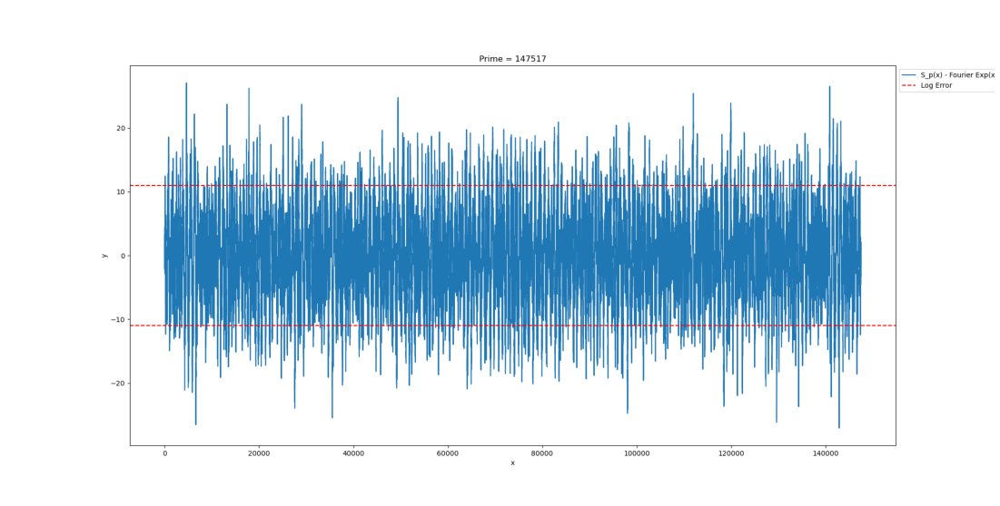

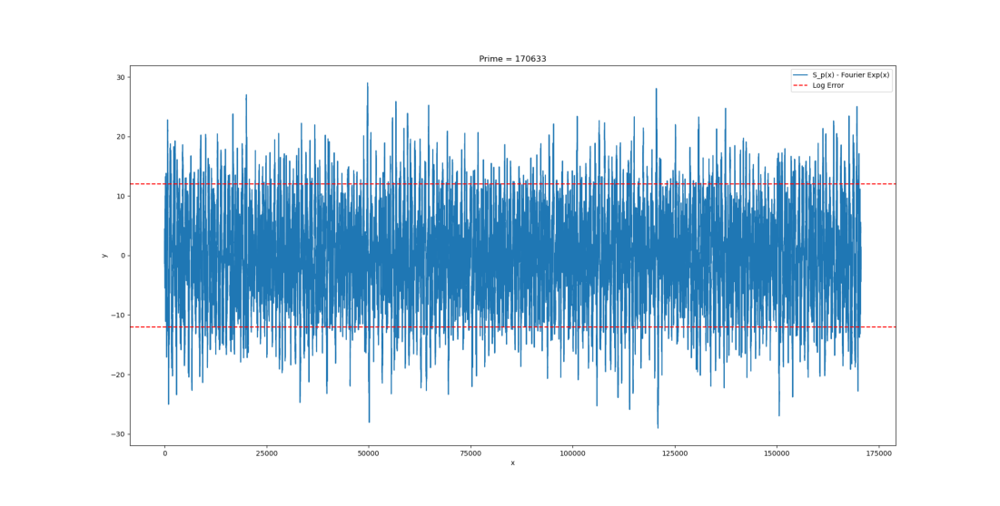

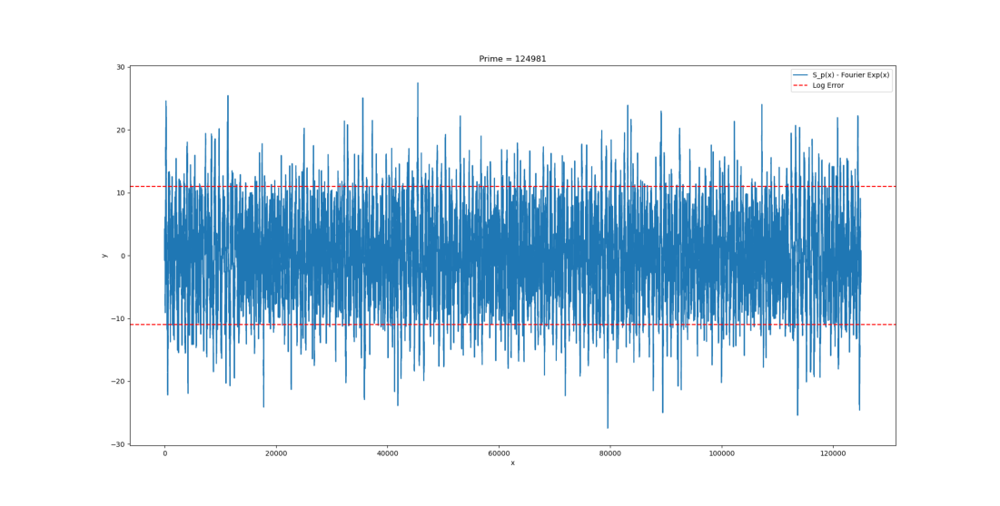

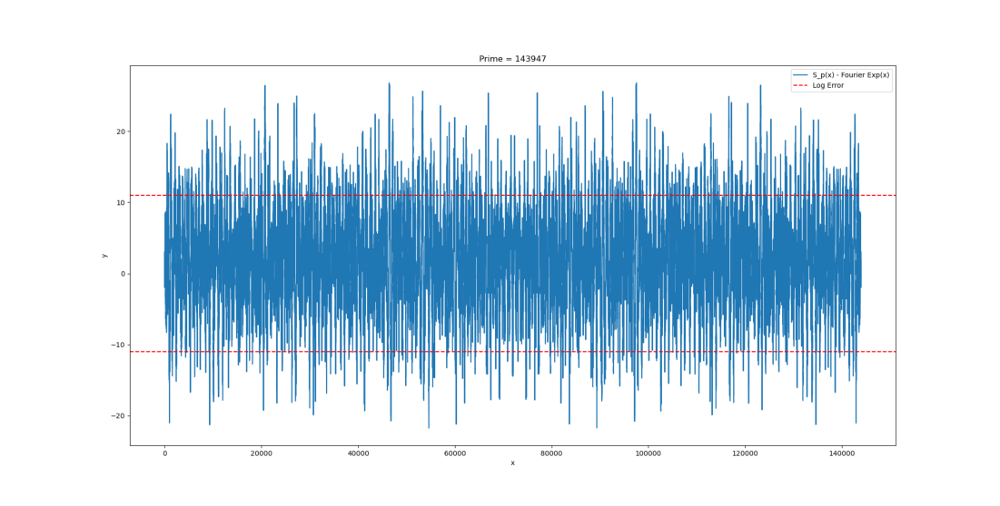

In [10]:
prime_sample = random.choices(df["prime"].values, k= 4)

for prime in prime_sample:
    plot_diff_lst(prime)

# Translation Property: <br>

Here we see an important trend. All the diff plots look more or less the same (seemingly random Brownian Motion like stuff) with a few important properties: <br>
1. Translation: up to vertical translation these look very similar. There are some that are almost all above the red lines, some that are almost all below the red lines, and the vast majority seem to lie in the middle
2. Symmetry: there is definitely some weird symmetries, though even just looking at these it looks difficult to quantify <br>

I will explore both of these thoroughly later

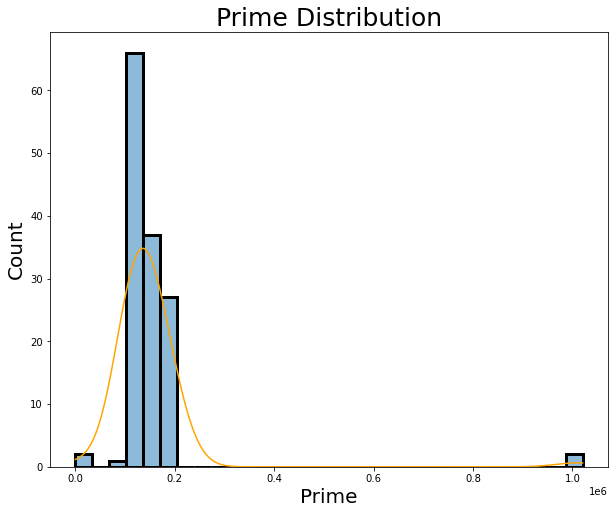

In [11]:
histplot("prime")

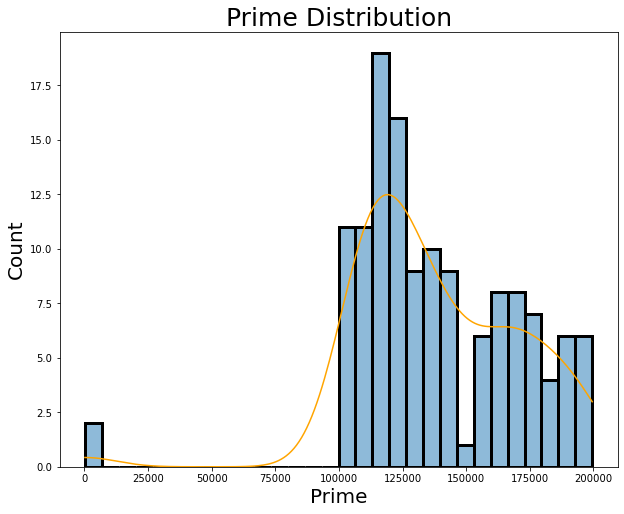

In [12]:
histplot("prime", df = df_small_prime)

Prime Distribution: <br>
- Ideally this would be uniform
- Due to prime number theorem it should theoretically be slighly decreasing
- Due to multiprocessing and fact that smaller primes tend to process, it decreases more
- Overall looks good 

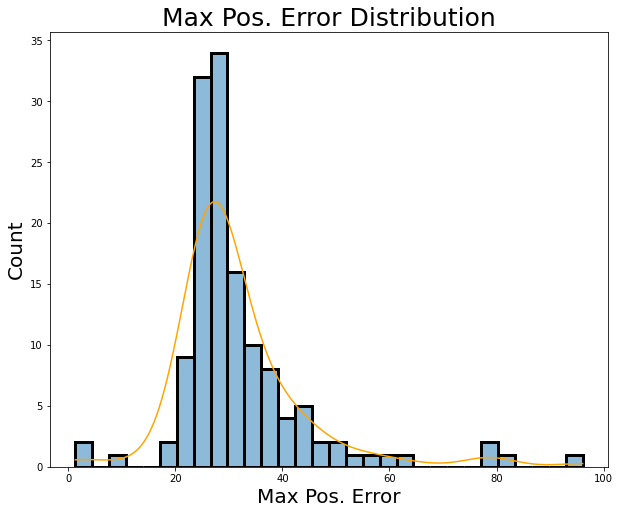

In [13]:
histplot("pos_error")

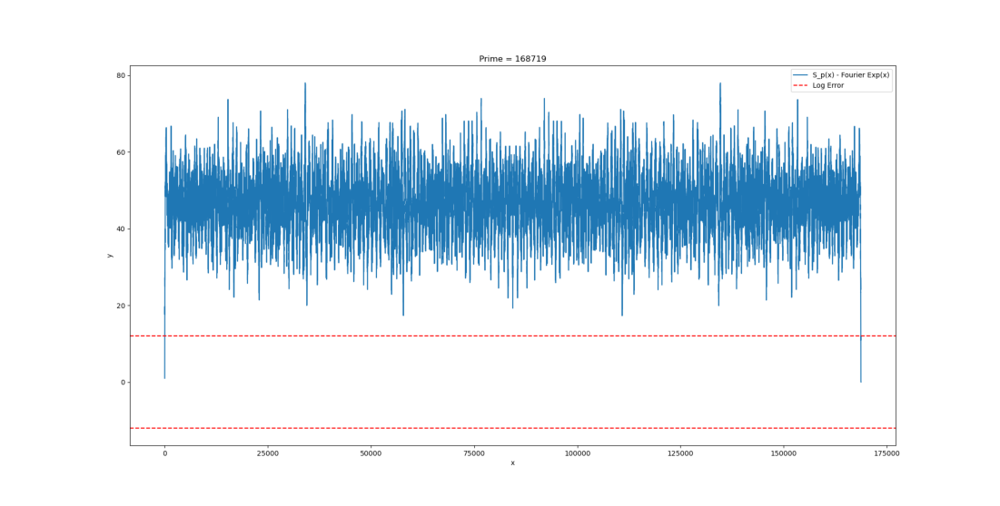

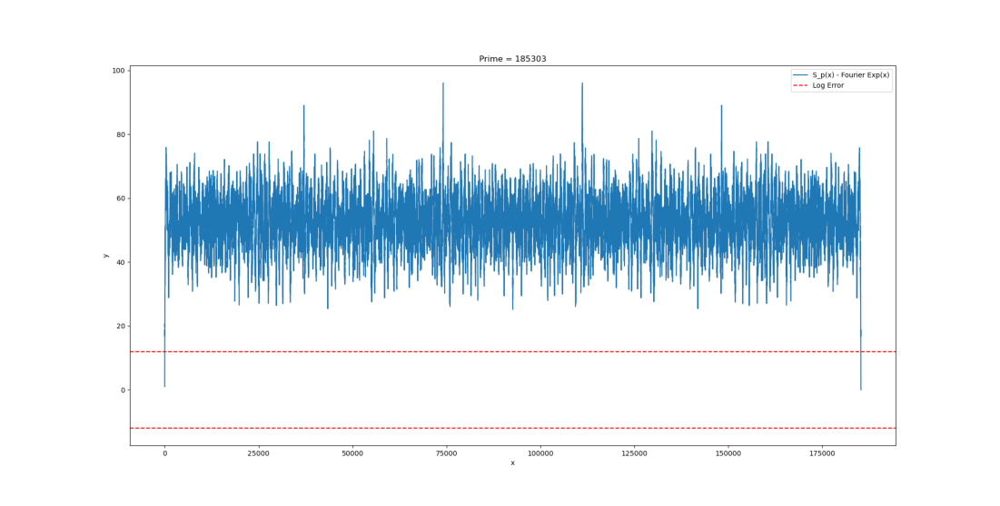

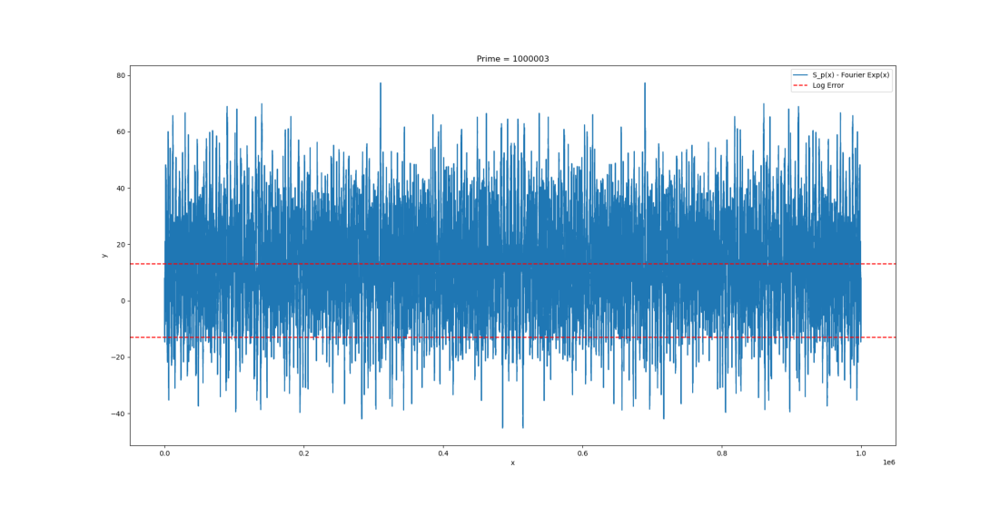

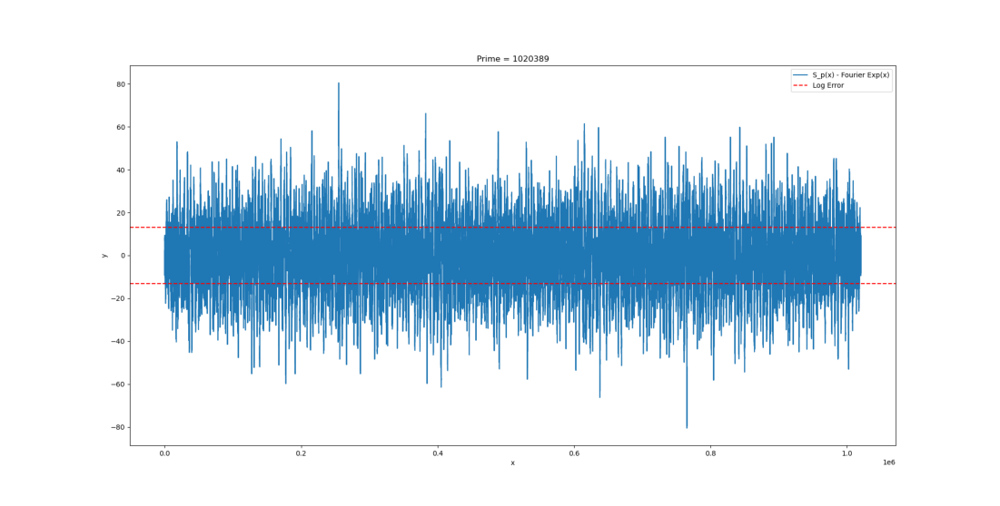

In [14]:
for prime in df[df["pos_error"] > 70]['prime'].values:
    plot_diff_lst(prime)

These are all either 1 million primes or just super translated up

Max Positive Error Distribution: <br>
- A few outliers on the positive side
- On negative side the min is guaranteed 0 (since diff @ 0 == 0)
- Besides this the distribution is pretty symmetrical and almost normal-like
- Interestingly even the 1 million datapoint isn't the rightmost point

In [15]:
print(f"Max Positive Error Mean = {round(df_small_prime['pos_error'].mean(), 2)}")
print(f"Max Positive Error Std. Dev. = {round(df_small_prime['pos_error'].std(), 2)}")

Max Positive Error Mean = 31.01
Max Positive Error Std. Dev. = 11.43


Mean is 31.46 and standard deviation is 10.92. Given < 150 datapoints this is definitely not normal as the observations in the 60s to 100 wouldn't be possible.

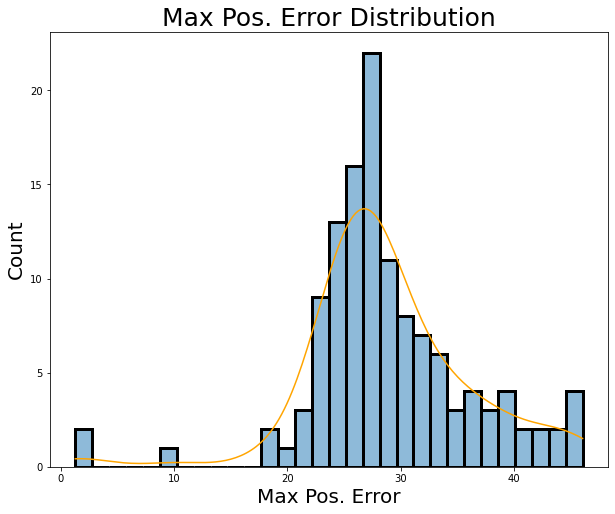

In [16]:
histplot("pos_error", df = df_small_pos_error)

Let's investigate this outlier with very low max positive erorr

In [17]:
df[df["pos_error"] < 15]

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
133,197,1.30,-1.48,85.27919,84.26396,1.48,0,84.26396,0.18,1,69.54
134,199,2.03,-0.82,55.77889,71.35678,2.03,1,55.77889,1.21,3,27.14
55,137831,10.21,-41.56,99.97533,48.90772,41.56,0,48.90772,31.35,3,48.88


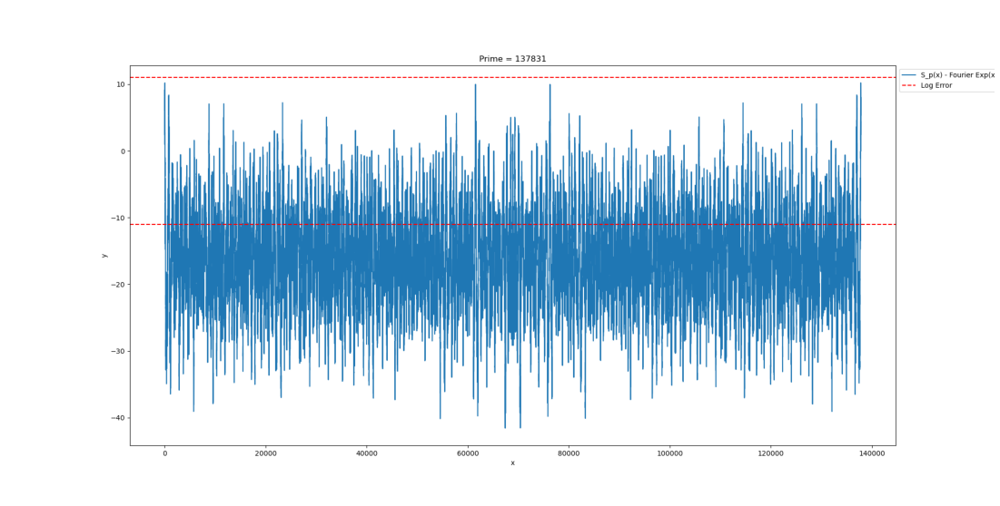

In [18]:
plot_diff_lst(137831)

Here we see that this is a weird example where the diff plot looks like it was translated down. 

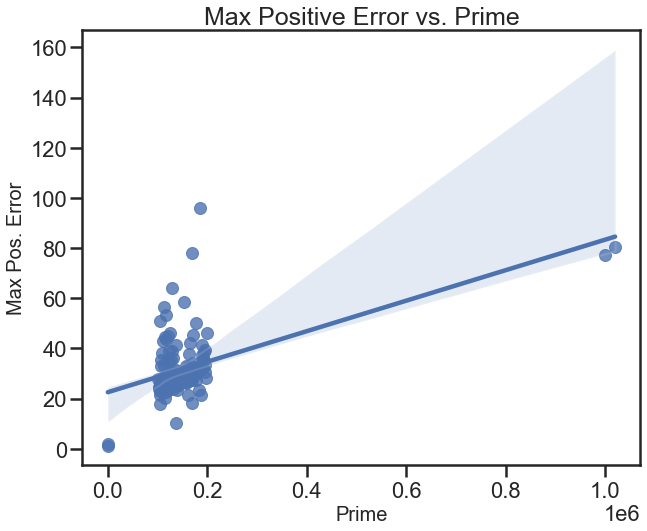

In [19]:
scatter("pos_error", title = "Max Positive Error vs. Prime")

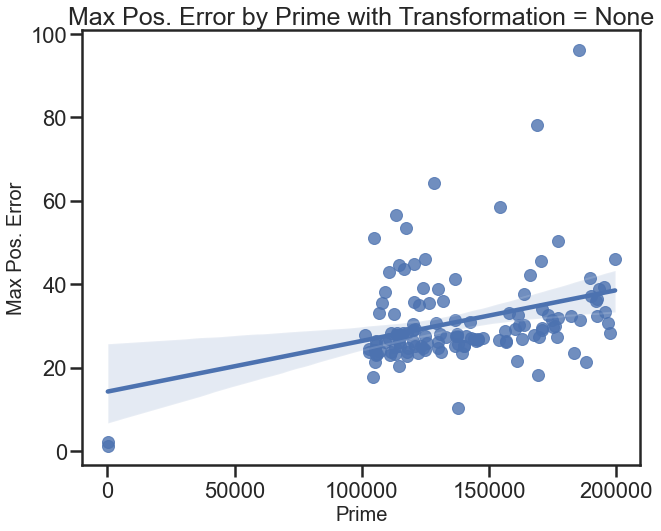

In [20]:
scatter("pos_error", df = df_small_prime)

There seems to be a positive correlation between prime and max positive error (the confidence interval around the least squares line visibly doesn't include a line with 0 slope, which is indicative of the $F$ statistic). However, it's obviously more complex than being directly a function of the prime

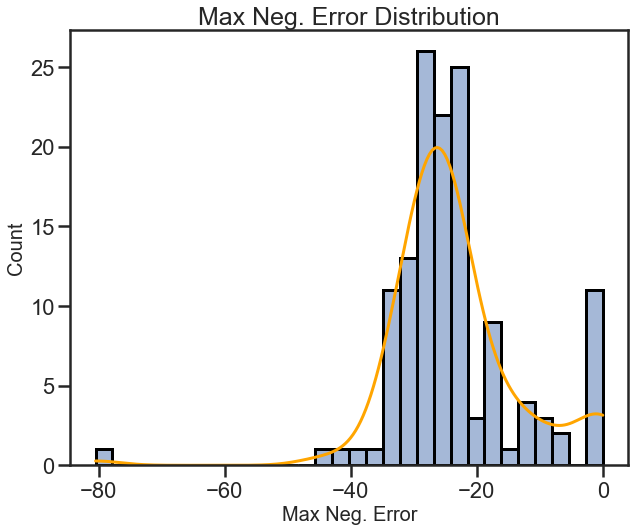

In [21]:
histplot('neg_error')

Bears some resemblance to pos error except obviously flipped. Here the -80 outlier is due to the 1 million point so not as many outliers on the negative side.

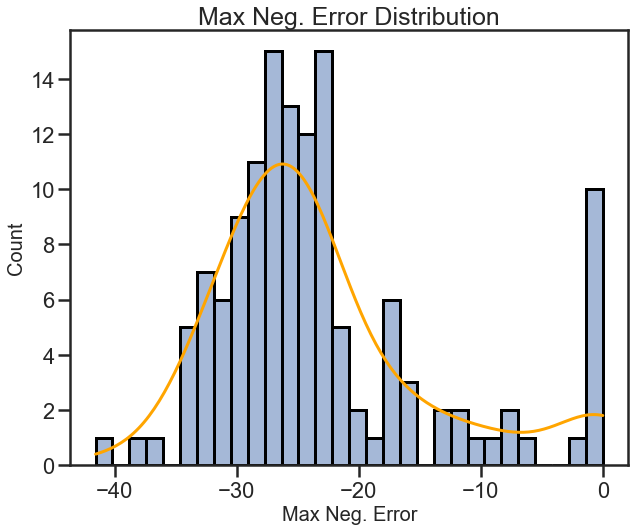

In [22]:
histplot("neg_error", df = df_small_prime)

But, there are some points with virtually no errors that were negative. Let's look at the diff plots for these

In [23]:
df_pos = df[df["neg_error"] > -5]
df_pos

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
133,197,1.30,-1.48,85.27919,84.26396,1.48,0,84.26396,0.18,1,69.54
134,199,2.03,-0.82,55.77889,71.35678,2.03,1,55.77889,1.21,3,27.14
4,104759,51.11,-0.00,52.31436,99.99809,51.11,1,52.31436,51.11,3,52.31
90,110543,42.79,-0.73,25.68503,32.62622,42.79,1,25.68503,42.06,3,41.69
52,113279,56.49,-0.00,44.69319,99.99823,56.49,1,44.69319,56.49,3,44.69
62,117191,53.42,-0.00,40.24541,99.99829,53.42,1,40.24541,53.42,3,40.24
113,120671,44.90,-1.03,96.12417,89.98765,44.90,1,96.12417,43.87,3,86.11
3,128399,64.16,-0.00,55.33766,99.99844,64.16,1,55.33766,64.16,3,55.34
48,154279,58.56,-0.00,33.33247,99.99870,58.56,1,33.33247,58.56,3,33.33
80,168719,78.03,-0.00,20.18326,99.99881,78.03,1,20.18326,78.03,3,20.18


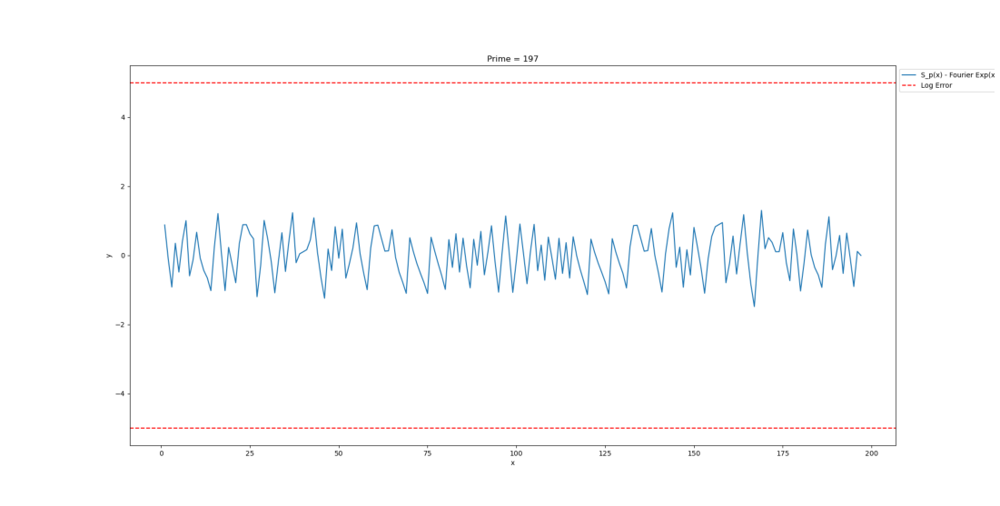

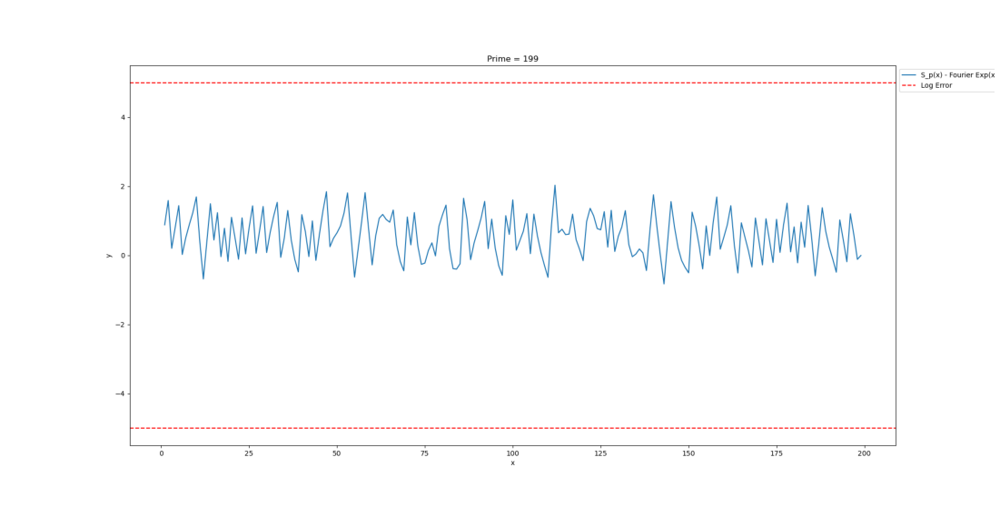

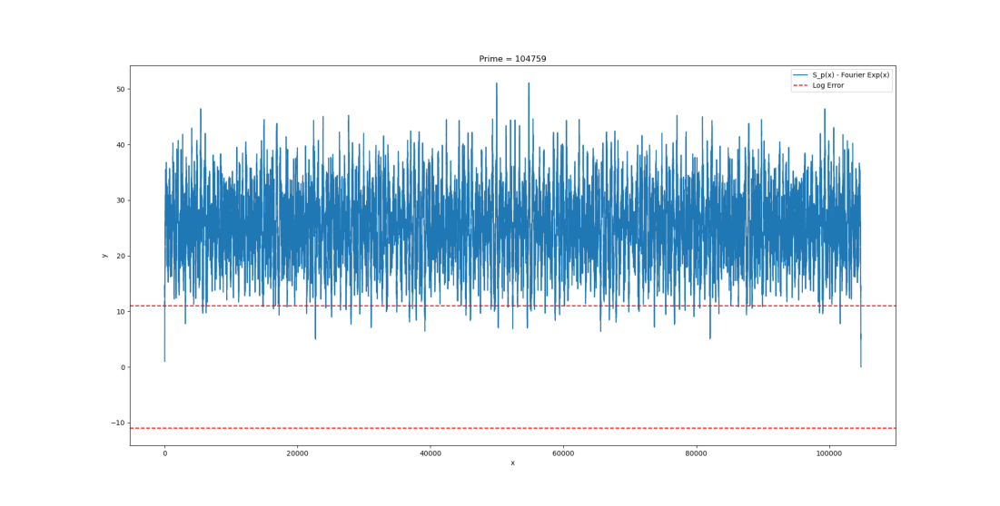

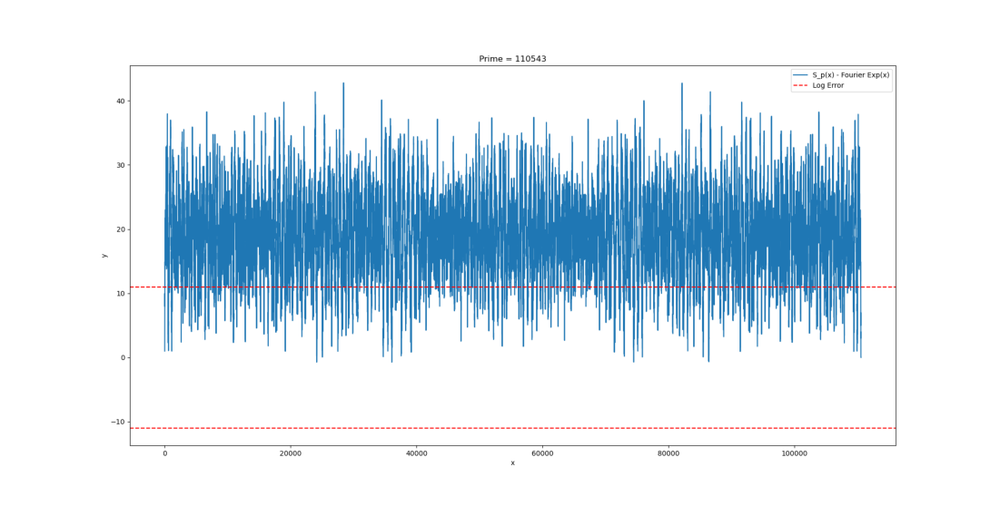

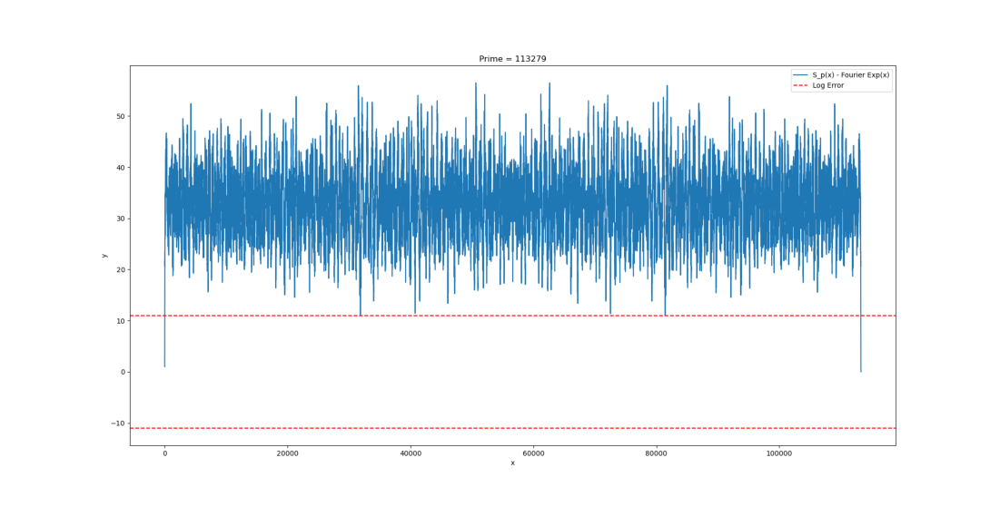

...

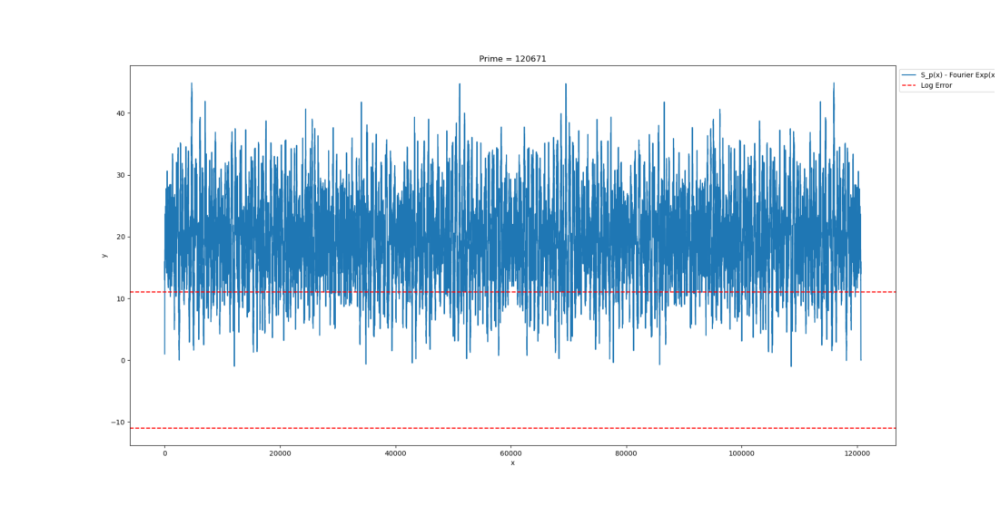

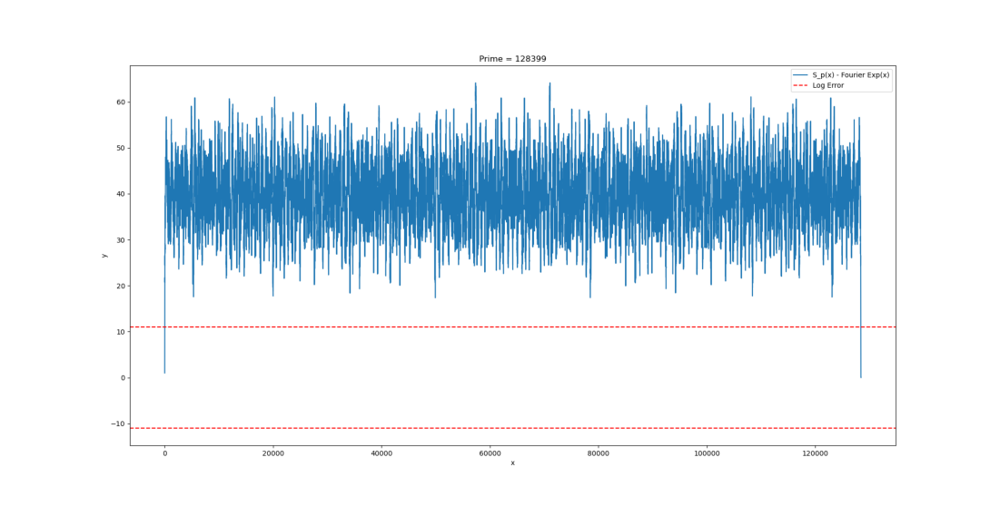

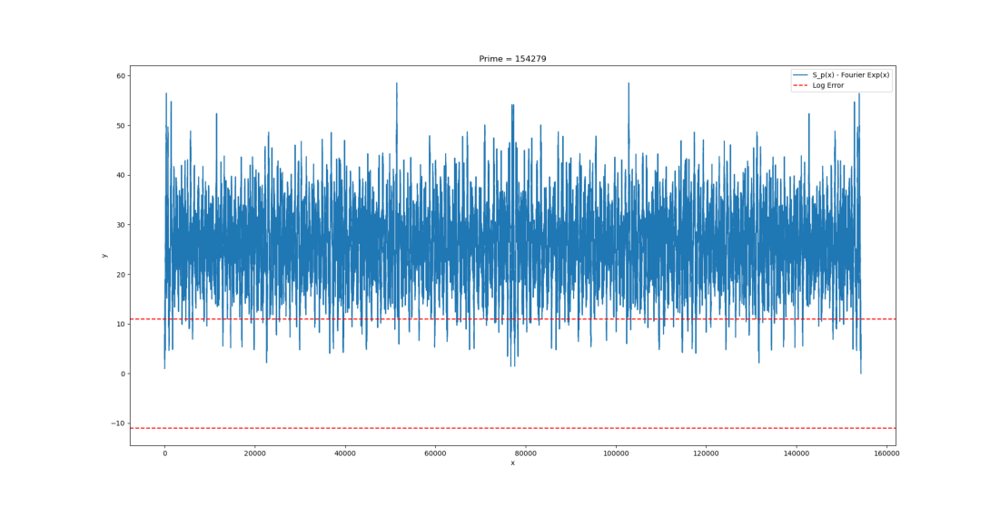

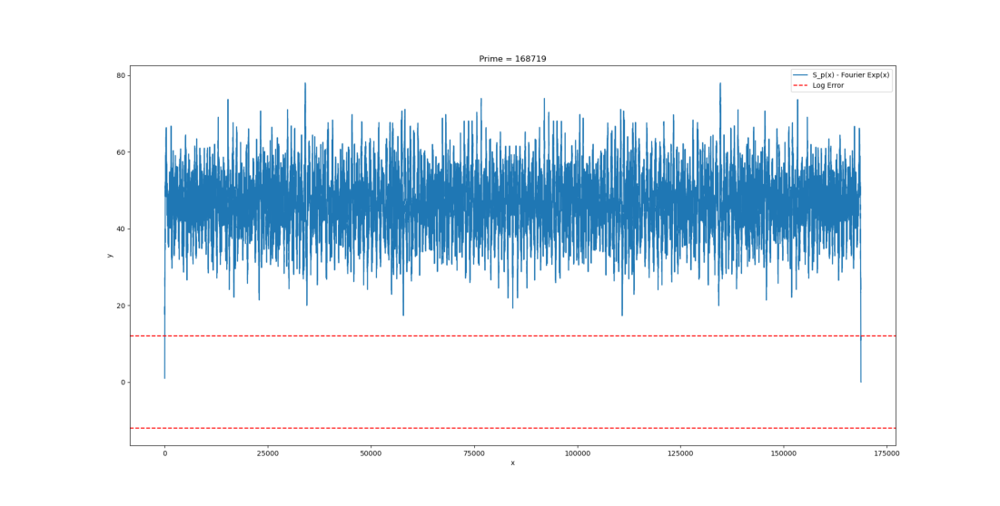

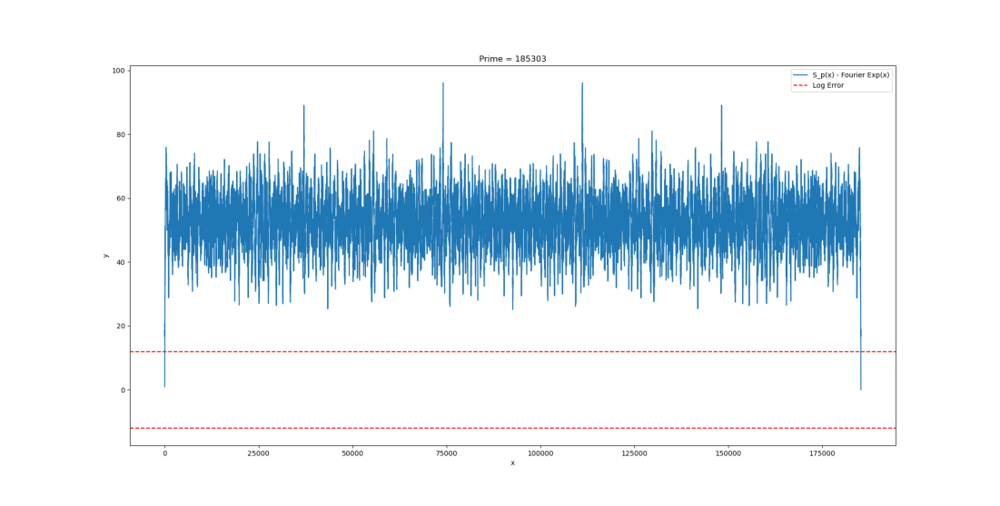

In [24]:
for prime in df_pos["prime"].values:
    plot_diff_lst(prime)

These are just translated really high up. The entire plot is basically above the log error threshold. However, they are still relatively bounded, meaning any reasonable big O constant would still make the error term here $O(\log p)$.

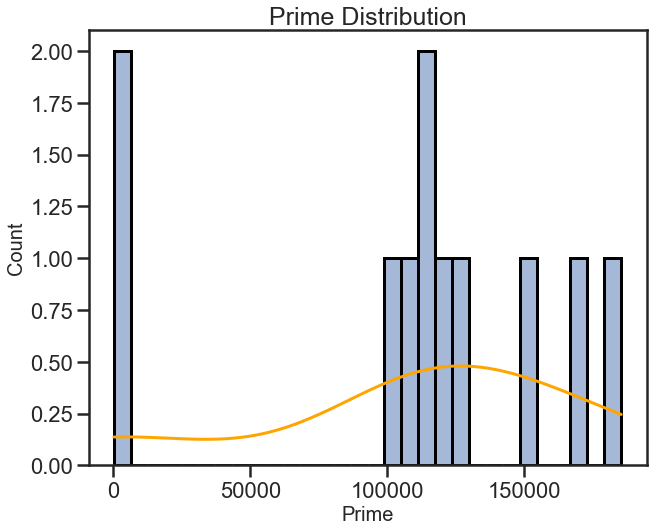

In [25]:
histplot("prime", df = df_pos)

This is similar to the initial distribution of prime, so no trend like higher primes are more likely (at least in this range)

In [26]:
df_pos

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
133,197,1.30,-1.48,85.27919,84.26396,1.48,0,84.26396,0.18,1,69.54
134,199,2.03,-0.82,55.77889,71.35678,2.03,1,55.77889,1.21,3,27.14
4,104759,51.11,-0.00,52.31436,99.99809,51.11,1,52.31436,51.11,3,52.31
90,110543,42.79,-0.73,25.68503,32.62622,42.79,1,25.68503,42.06,3,41.69
52,113279,56.49,-0.00,44.69319,99.99823,56.49,1,44.69319,56.49,3,44.69
62,117191,53.42,-0.00,40.24541,99.99829,53.42,1,40.24541,53.42,3,40.24
113,120671,44.90,-1.03,96.12417,89.98765,44.90,1,96.12417,43.87,3,86.11
3,128399,64.16,-0.00,55.33766,99.99844,64.16,1,55.33766,64.16,3,55.34
48,154279,58.56,-0.00,33.33247,99.99870,58.56,1,33.33247,58.56,3,33.33
80,168719,78.03,-0.00,20.18326,99.99881,78.03,1,20.18326,78.03,3,20.18


In [27]:
df[df["pos_error"] >= 50]

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
4,104759,51.11,-0.00,52.31436,99.99809,51.11,1,52.31436,51.11,3,52.31
52,113279,56.49,-0.00,44.69319,99.99823,56.49,1,44.69319,56.49,3,44.69
62,117191,53.42,-0.00,40.24541,99.99829,53.42,1,40.24541,53.42,3,40.24
3,128399,64.16,-0.00,55.33766,99.99844,64.16,1,55.33766,64.16,3,55.34
48,154279,58.56,-0.00,33.33247,99.99870,58.56,1,33.33247,58.56,3,33.33
80,168719,78.03,-0.00,20.18326,99.99881,78.03,1,20.18326,78.03,3,20.18
97,176899,50.33,-32.40,39.99910,79.99932,50.33,1,39.99910,17.93,3,20.00
35,185303,96.08,-0.00,59.99903,99.99892,96.08,1,59.99903,96.08,3,60.00
132,1000003,77.32,-45.22,31.01061,48.52665,77.32,1,31.01061,32.10,3,20.46
131,1020389,80.51,-80.51,24.99988,74.99983,80.51,1,24.99988,0.00,1,0.00


Here I'm checking the overlap between the most positive error and the least negative error. <br>
- There's strong overlap with the following exceptions:
- datapoint 131: this is the 1 million prime and just has both high pos error and high neg error
- datapoints 113 and 90: these are the two with small negative error and also have large (>40) pos error
- datapoint 97: this one is a bit weird as it has high pos error and above average negative error

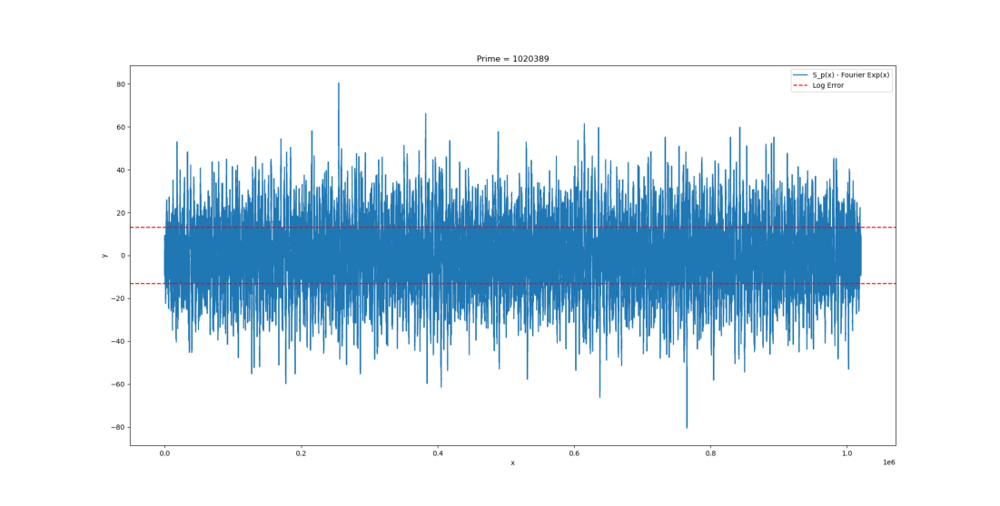

In [28]:
plot_diff_lst(1020389)

This 1 million datapoint is weird. As opposed to other plots, it exceeds the log error on both sides. Though not by much, this is telling me that maybe we haven't converged to any "final" behavior. In other words, log error looks good for now but the fact that this graph is qualitatively different than that of the other graphs means that it could be dangerous to extrapolate any findings from this dataset

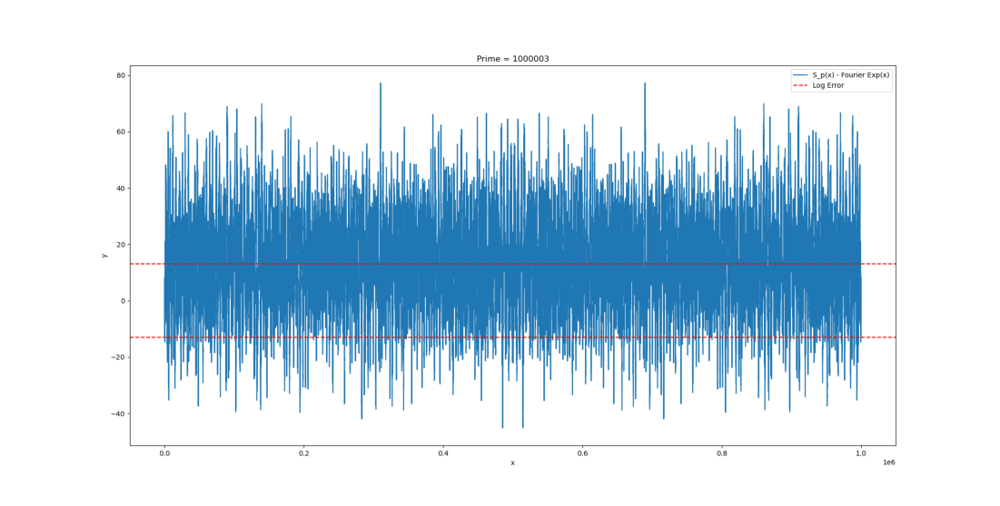

In [29]:
plot_diff_lst(1000003)

Yup, this one shows the same property. This is an example of a translated up graph.

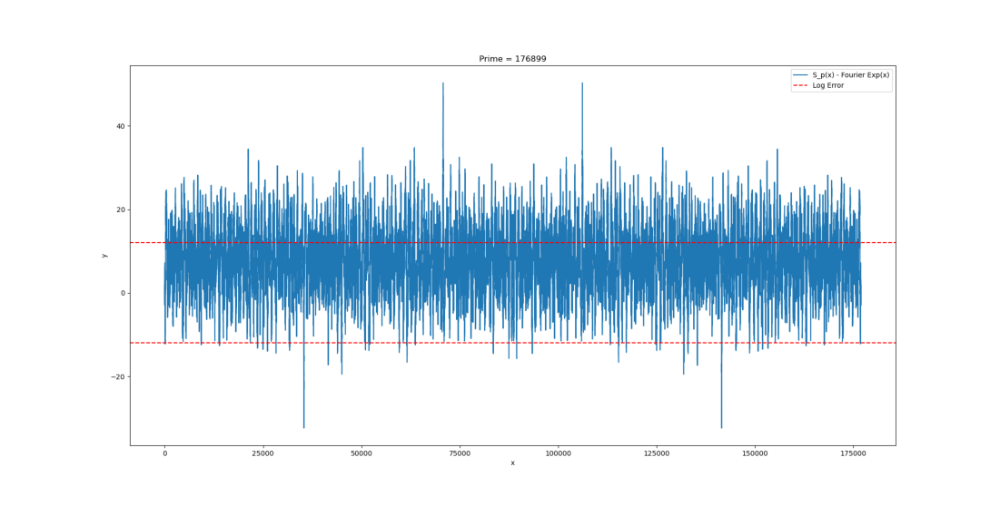

In [30]:
plot_diff_lst(176899)

Looking at the plot more seriosly we just have a "normal" plot with a few major exceptions, in both the positive and negative direction. Another very interesting thing I see here is symmetry. This is something to definitely explore later.

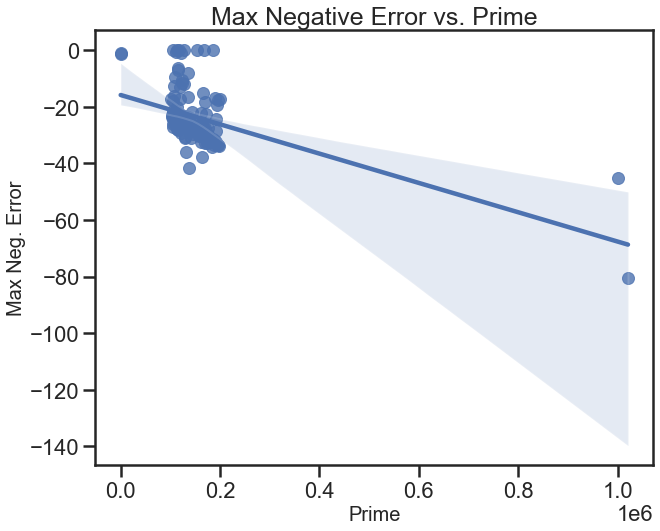

In [31]:
scatter("neg_error", title = "Max Negative Error vs. Prime")

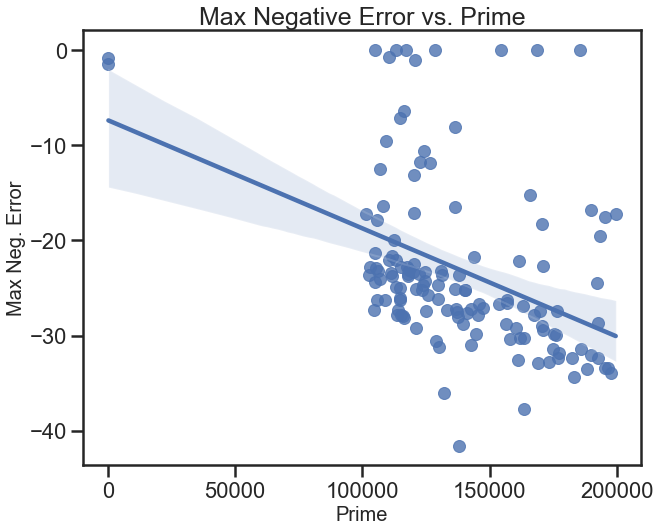

In [32]:
scatter("neg_error", df = df_small_prime, title = "Max Negative Error vs. Prime")

This has a more straightforward decreasing relationship than the positive

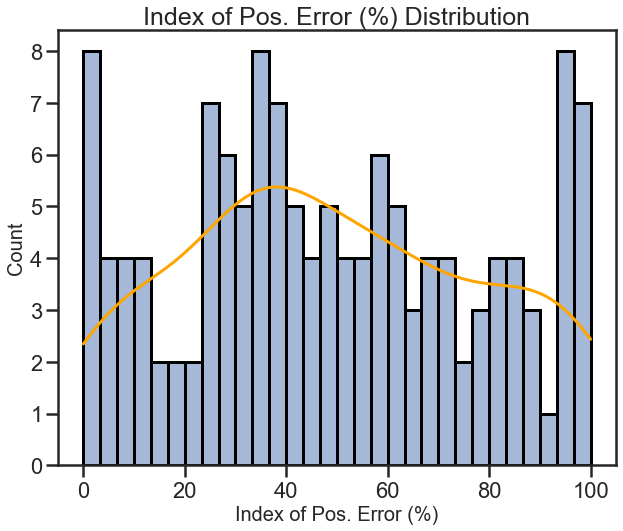

In [33]:
histplot("x_pos_error")

Lot virtually at beginning or virtually at end, and then besides that mostly centered

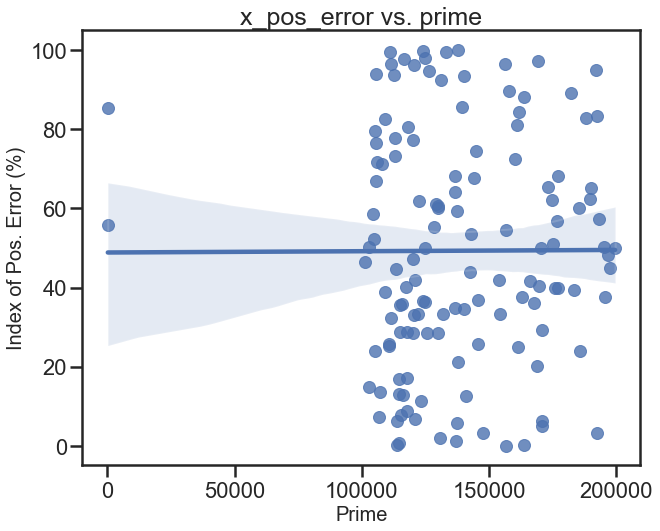

In [34]:
scatter("x_pos_error", df = df_small_prime, title = "x_pos_error vs. prime")

Basically no trend here, meaning that prime has no impact on where (relative to the prime) the index of the pos error occurs.

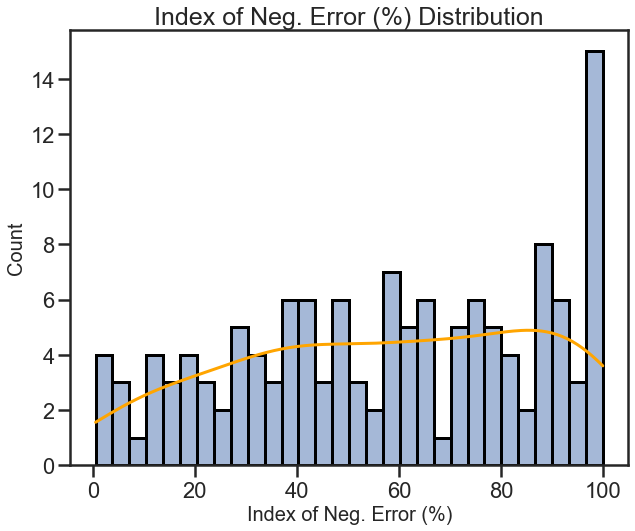

In [35]:
histplot("x_neg_error")

Here maybe slightly increasing and then huge bump at around 100: a lot of reach max negative error towards the end. Let's look at these.

In [36]:
df[df["x_neg_error"] > 95]

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
4,104759,51.11,-0.00,52.31436,99.99809,51.11,1,52.31436,51.11,3,52.31
57,109139,38.13,-9.57,38.88344,97.83945,38.13,1,38.88344,28.56,3,36.72
52,113279,56.49,-0.00,44.69319,99.99823,56.49,1,44.69319,56.49,3,44.69
128,113749,27.86,-27.84,0.21539,99.78198,27.86,1,0.21539,0.02,1,0.00
104,114643,20.27,-26.29,0.73271,99.03788,26.29,0,99.03788,6.02,3,0.23
62,117191,53.42,-0.00,40.24541,99.99829,53.42,1,40.24541,53.42,3,40.24
43,118147,24.68,-23.11,80.43793,96.54244,24.68,1,80.43793,1.57,3,76.98
3,128399,64.16,-0.00,55.33766,99.99844,64.16,1,55.33766,64.16,3,55.34
79,136943,27.54,-27.23,1.11871,98.68851,27.54,1,1.11871,0.31,3,0.19
73,147517,27.10,-27.08,3.12167,96.87629,27.10,1,3.12167,0.02,1,0.00


Some, like 104759, 113279, 117191, 168719, and 185303, reach it exactly at 100%. This is because the max negative error is 0 (these are those weird plots that are super translated up). Let's look at the others

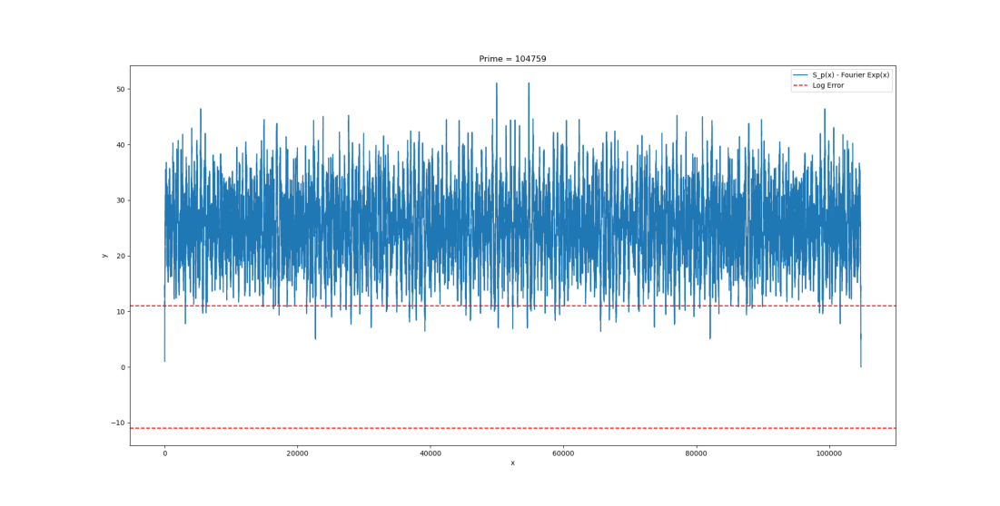

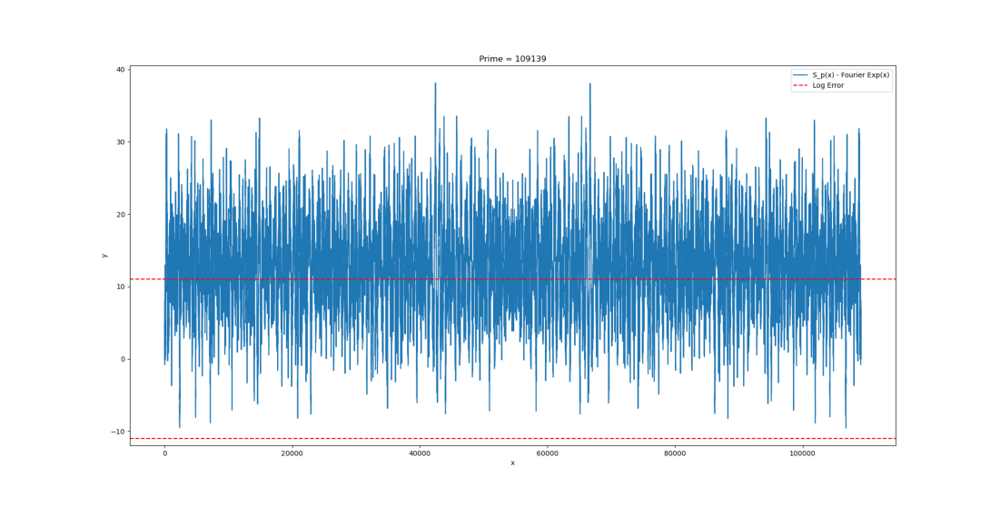

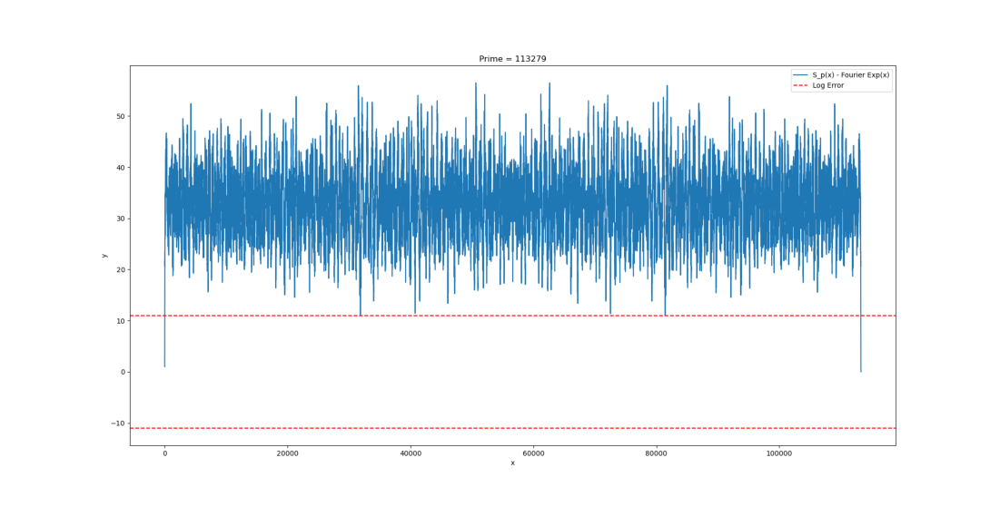

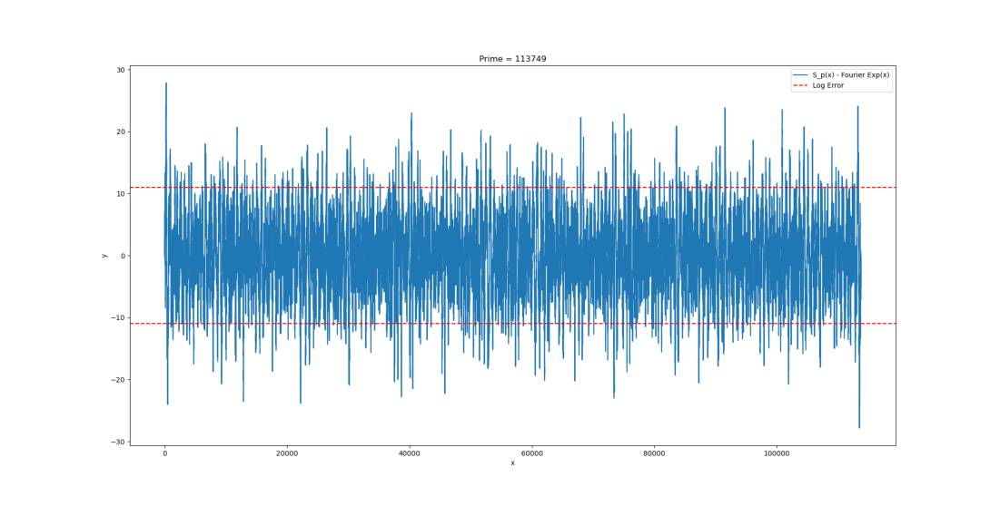

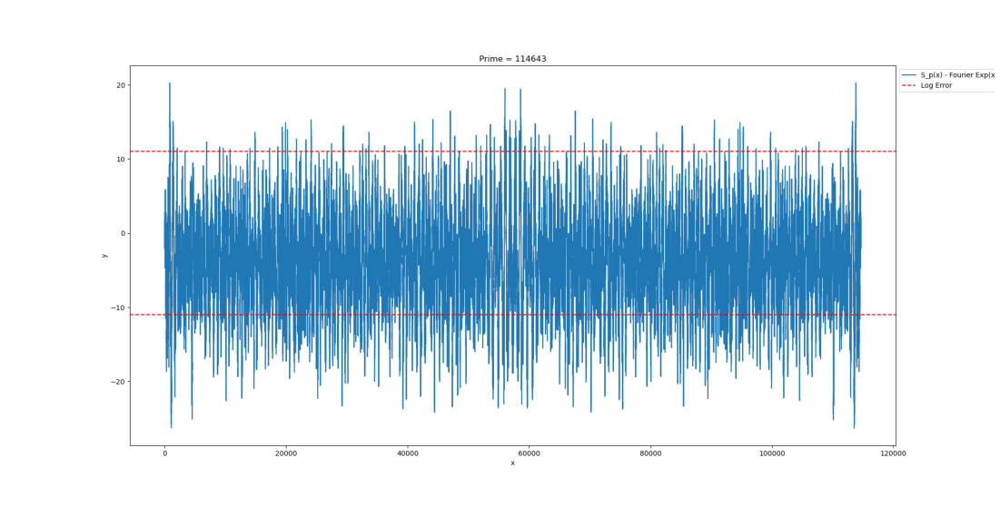

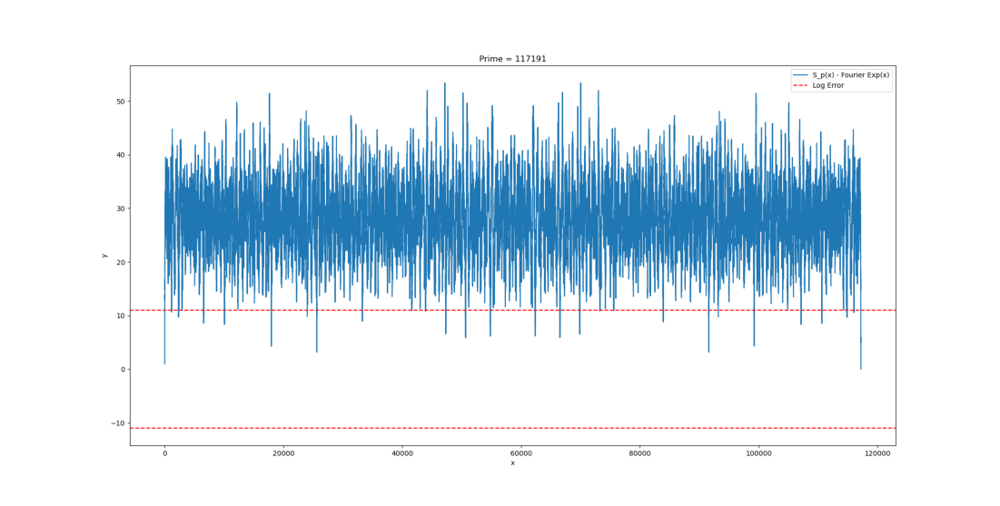

Prime = 118147 hasn't been analyzed yet


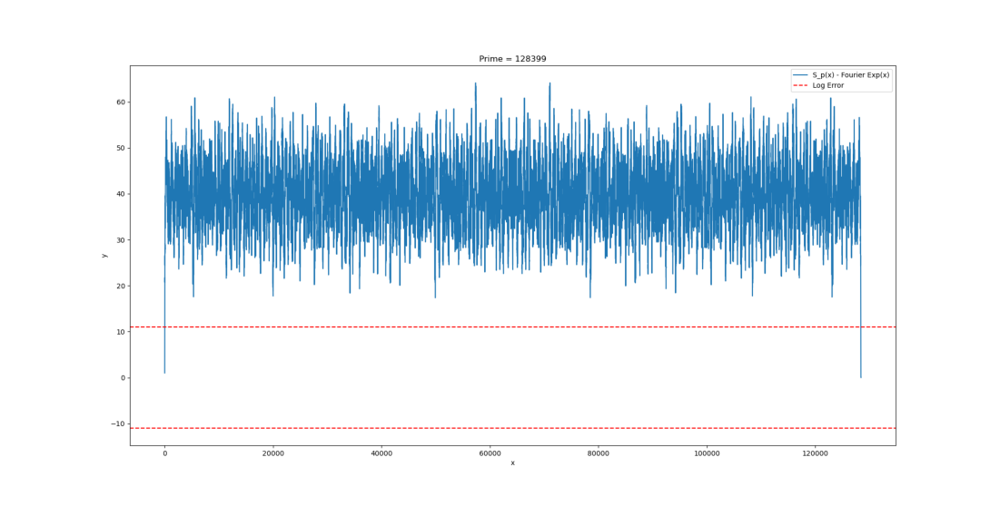

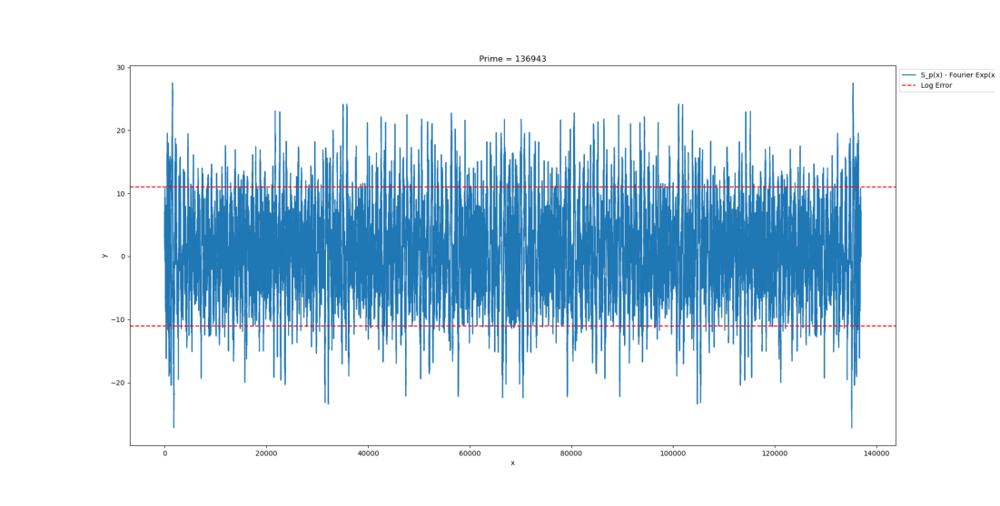

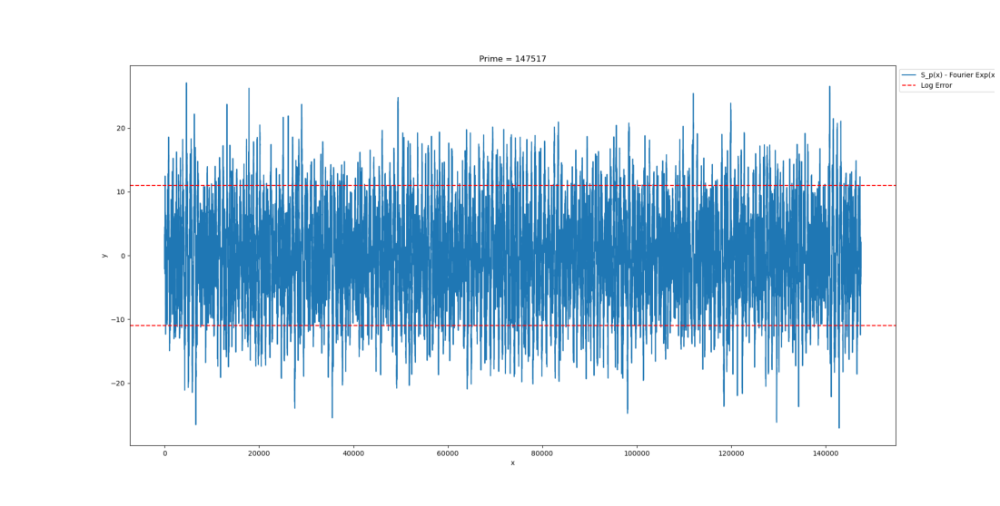

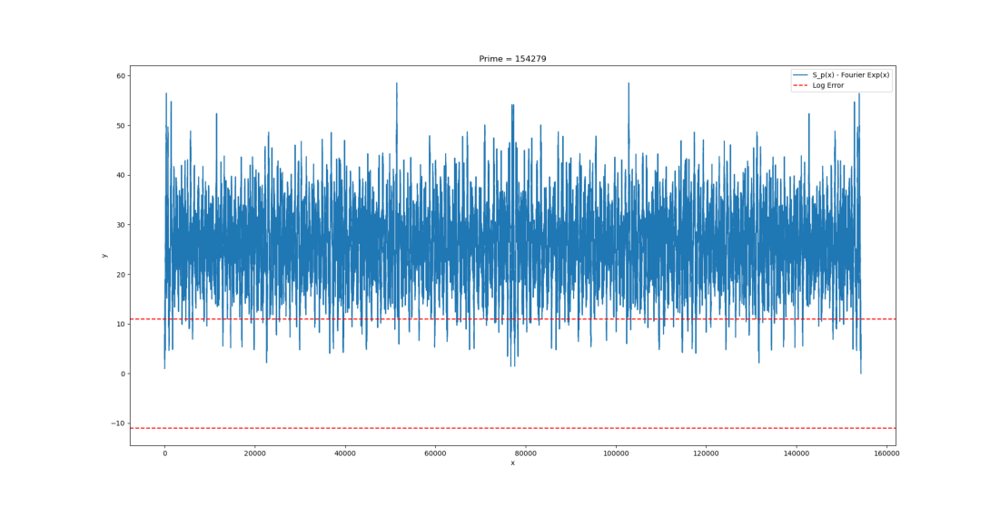

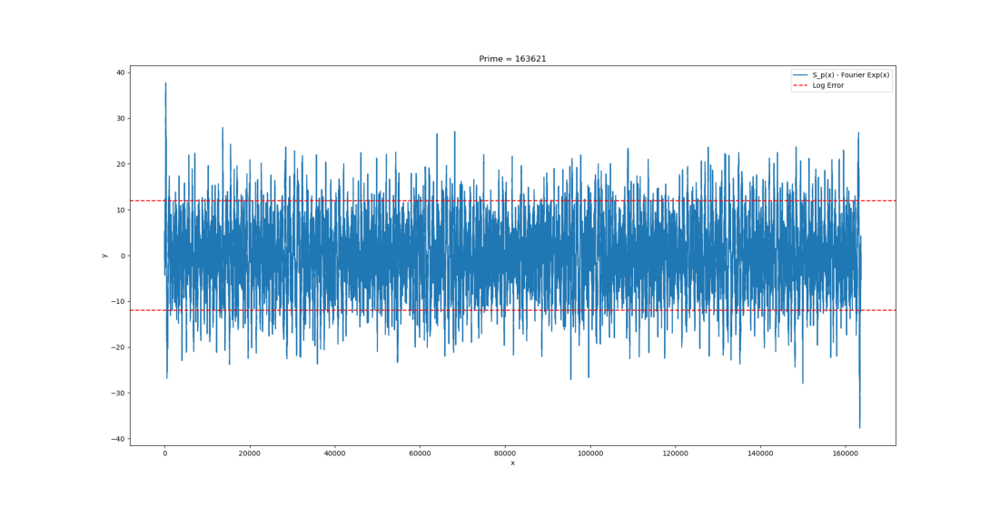

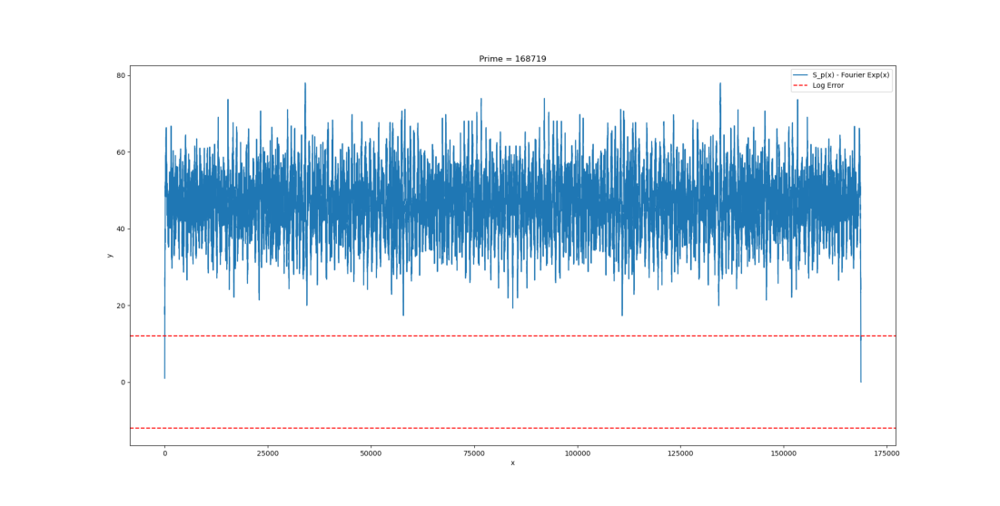

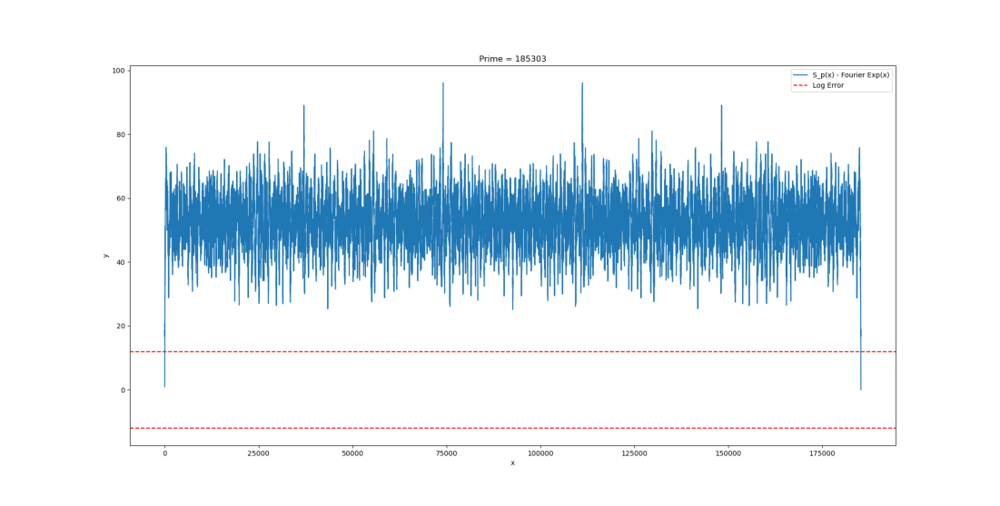

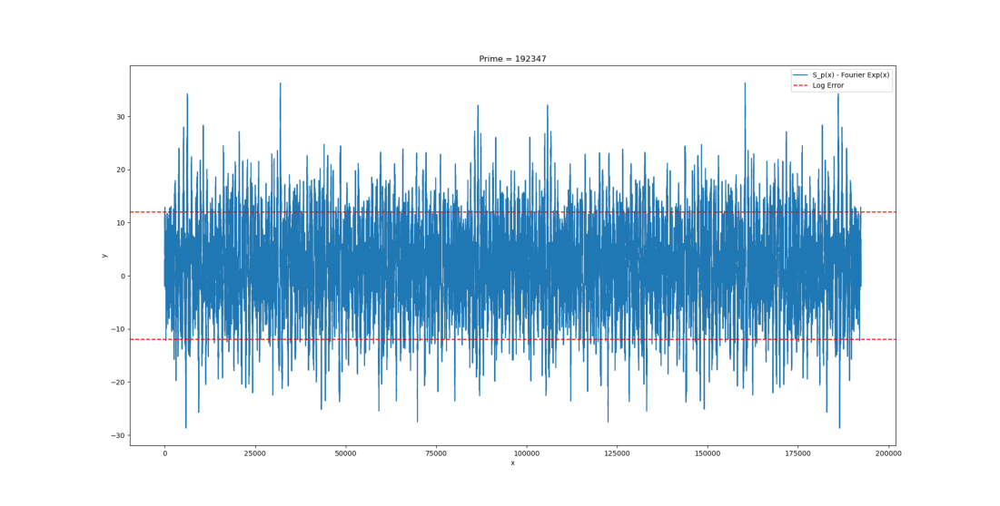

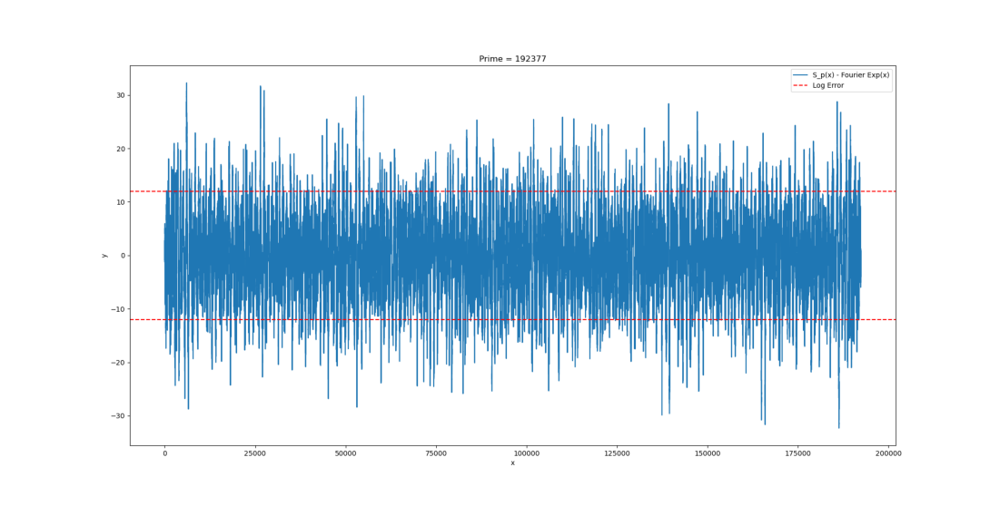

In [37]:
for prime in df[(df["x_neg_error"] > 95) & (df["x_neg_error"] < 100)]["prime"].values:
    plot_diff_lst(prime)

I have no idea why I don't have the plot for p = 118147. Based on the others it seems that these plots have huge spikes right at the tails

In [38]:
df[df["prime"] == 118147]

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
43,118147,24.68,-23.11,80.43793,96.54244,24.68,1,80.43793,1.57,3,76.98


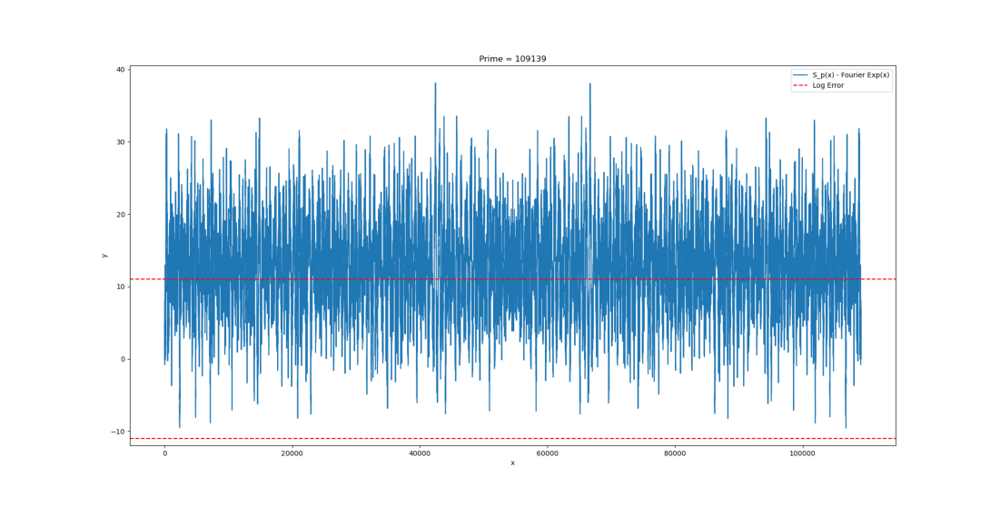

In [39]:
plot_diff_lst(109139)

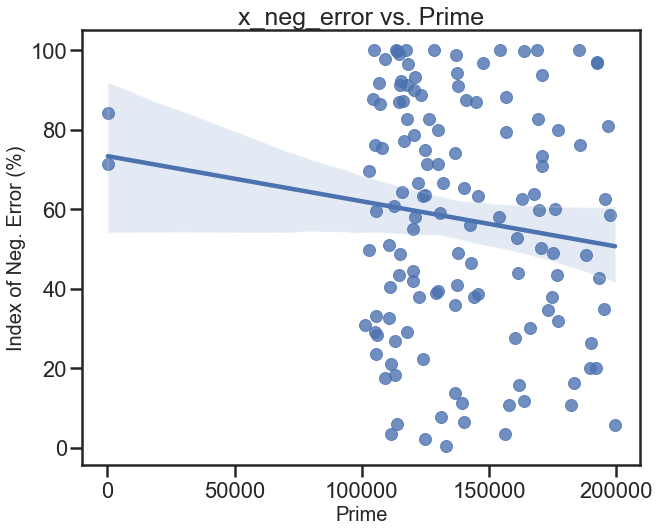

In [40]:
scatter('x_neg_error', df = df_small_prime, title = "x_neg_error vs. Prime")

Again no real relationship here

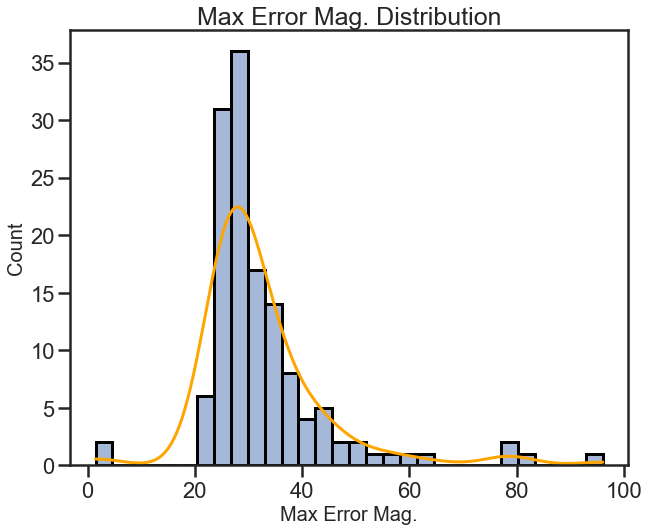

In [41]:
histplot("max_error")

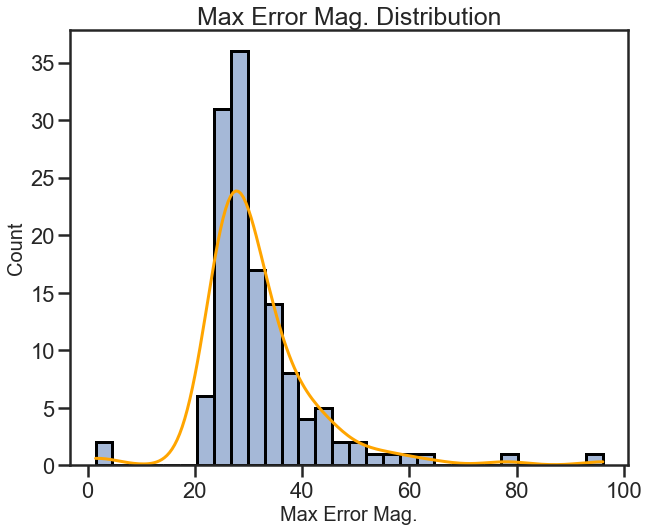

In [42]:
histplot('max_error', df = df_small_prime)

Looks pretty similar to positive error.

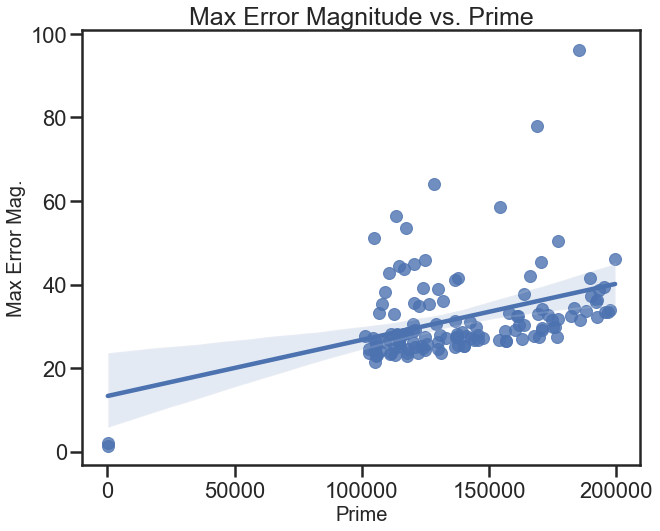

In [43]:
scatter("max_error", df = df_small_prime, title = "Max Error Magnitude vs. Prime", savefig = True, savename = "Max Error Mag. vs. Prime")

There is a positive relationship between prime and max error. We also see that the largest max error outliers occur with larger primes.

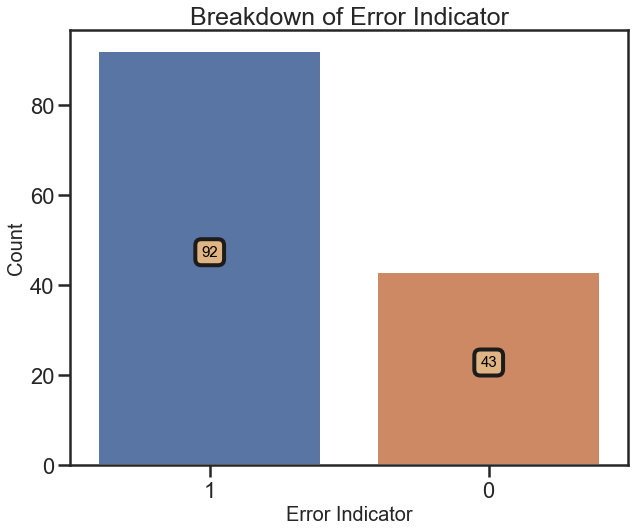

In [44]:
countplot("max_error_ind", savefig = True, savename = "Max Error Indicator")

Around 2/3 are error indicator == 1.

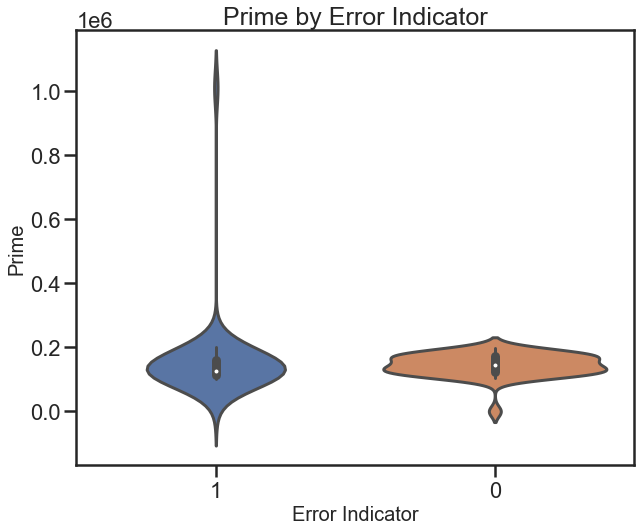

In [45]:
violinplot("max_error_ind", "prime")

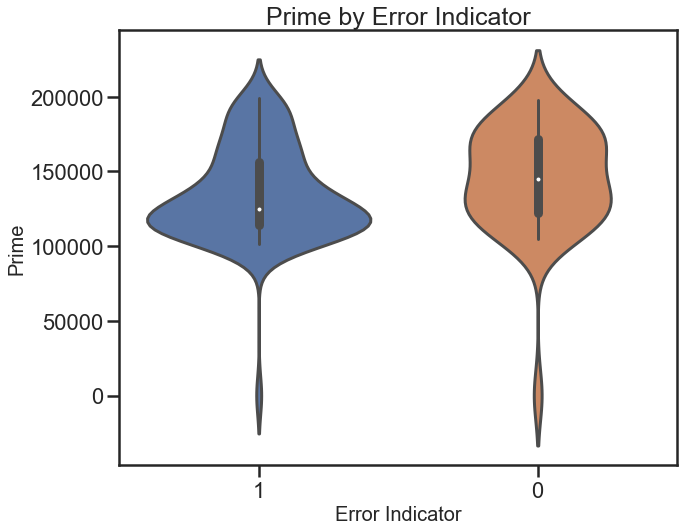

In [46]:
violinplot("max_error_ind", "prime", df = df_small_prime)

Nothing really obvious here

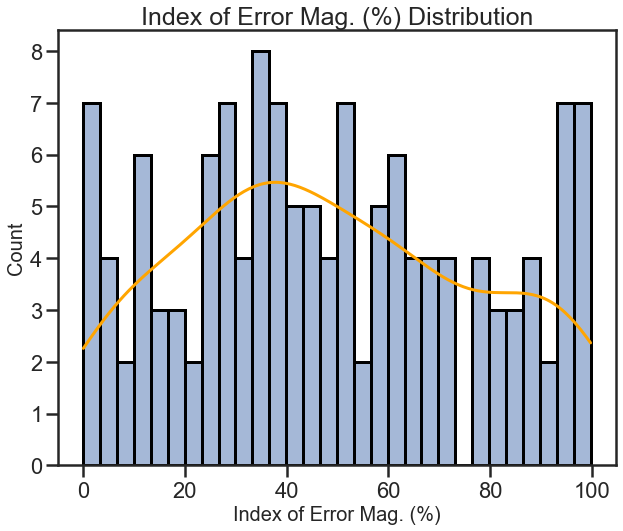

In [47]:
histplot("x_max_error")

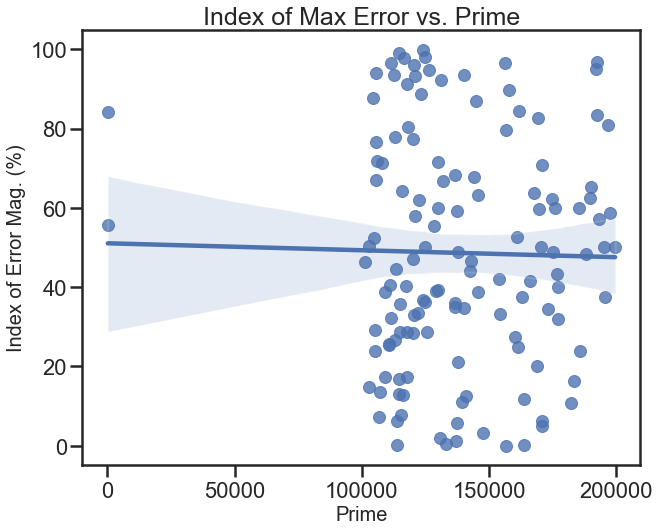

In [48]:
scatter("x_max_error", title = "Index of Max Error vs. Prime", df = df_small_prime, savefig = True, savename = "x_max_error vs. prime")

All virtually the same as positive error here.

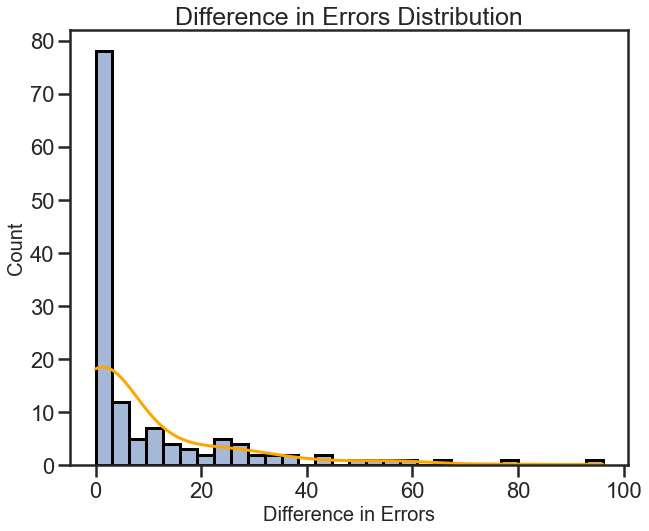

In [49]:
histplot("mag_diff", savefig = True, savename = "mag_diff distribution")

Interestingly, a vast majority are very close to 0, and then the rest trail off. It's almost as if it's a binary 0 or not 0, and then for those that are not 0 there's a separate distribution

In [50]:
get_length = lambda cutoff : len(df[df["mag_diff"] < cutoff])

for cutoff in [.01, .05, .08, 1, 2, 5, 10]:
    print(f"Cutoff: {round(cutoff, 2)}, Length: {get_length(cutoff)}")

Cutoff: 0.01, Length: 9
Cutoff: 0.05, Length: 52
Cutoff: 0.08, Length: 63
Cutoff: 1, Length: 71
Cutoff: 2, Length: 75
Cutoff: 5, Length: 84
Cutoff: 10, Length: 95


Wow, almost half of the points have a magnitude difference within .08

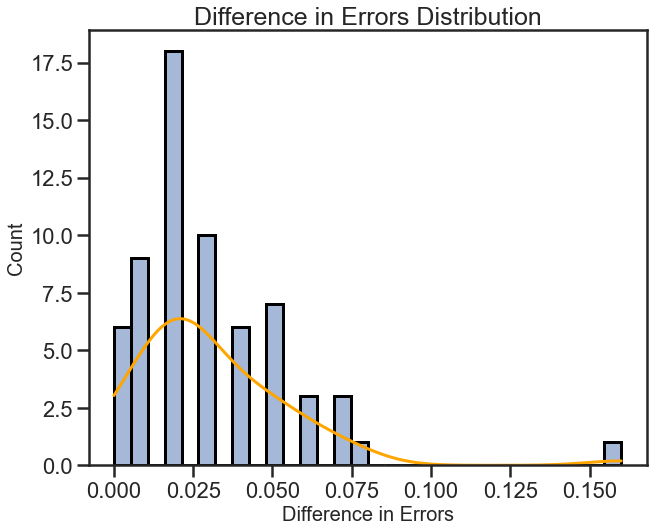

In [51]:
histplot('mag_diff', df = df_small_mag)

In [52]:
df[df["mag_diff"] < .08].sort_values("mag_diff")

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
131,1020389,80.51,-80.51,24.99988,74.99983,80.51,1,24.99988,0.00,1,0.0
27,105037,24.32,-24.32,23.96774,76.02940,24.32,1,23.96774,0.00,1,0.0
122,137197,27.51,-27.51,5.80406,94.19375,27.51,1,5.80406,0.00,1,0.0
85,163621,37.71,-37.71,0.16135,99.83682,37.71,1,0.16135,0.00,1,0.0
82,111653,23.72,-23.72,96.47479,3.52252,23.72,1,96.47479,0.00,1,0.0
...,...,...,...,...,...,...,...,...,...,...,...
46,105601,26.28,-26.22,67.01736,32.97980,26.28,1,67.01736,0.06,1,0.0
24,173209,32.69,-32.76,65.45907,34.53920,32.76,0,34.53920,0.07,1,0.0
127,117709,23.62,-23.55,17.22383,82.77362,23.62,1,17.22383,0.07,1,0.0
33,129733,24.59,-24.66,60.62991,39.36778,24.66,0,39.36778,0.07,1,0.0


Here we see something really interesting: points with very small mag_diff have very small dist_check as well

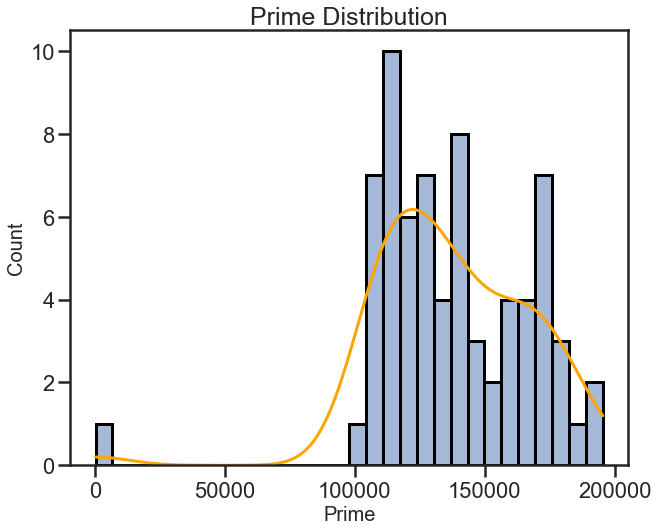

In [53]:
histplot('prime', df = df[(df["mag_diff"] < 1) & (df["prime"] < 200000)])

Seems pretty random when this phenomena occurs.

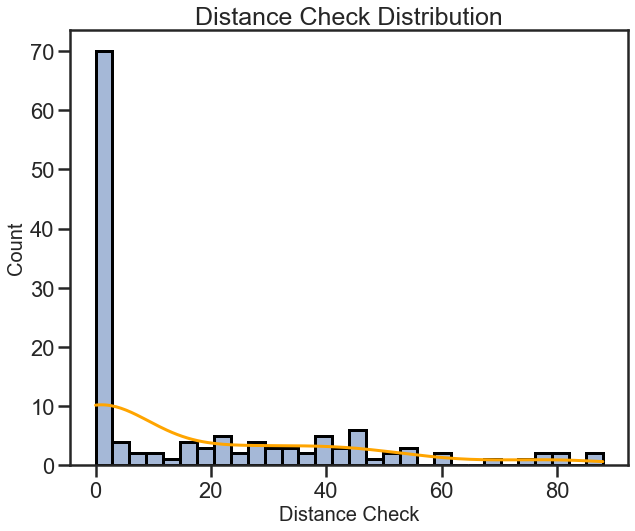

In [54]:
histplot('dist_check')

This distribution is very similar to that of mag_diff. 

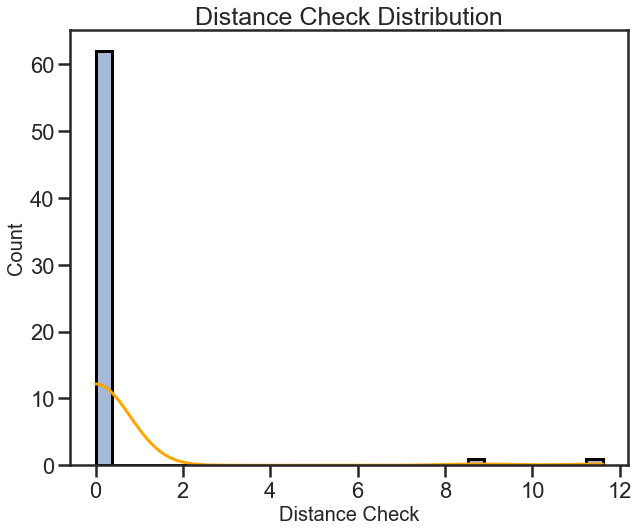

In [55]:
histplot("dist_check", df = df_small_mag)

Here we see this phenomena: those with small mag diff almost always have small dist check. Let's look at some of these primes

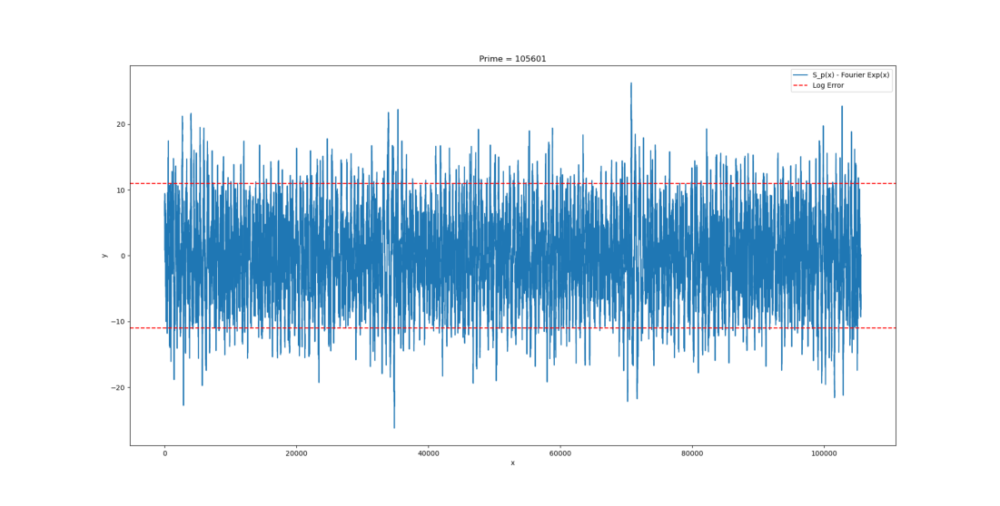

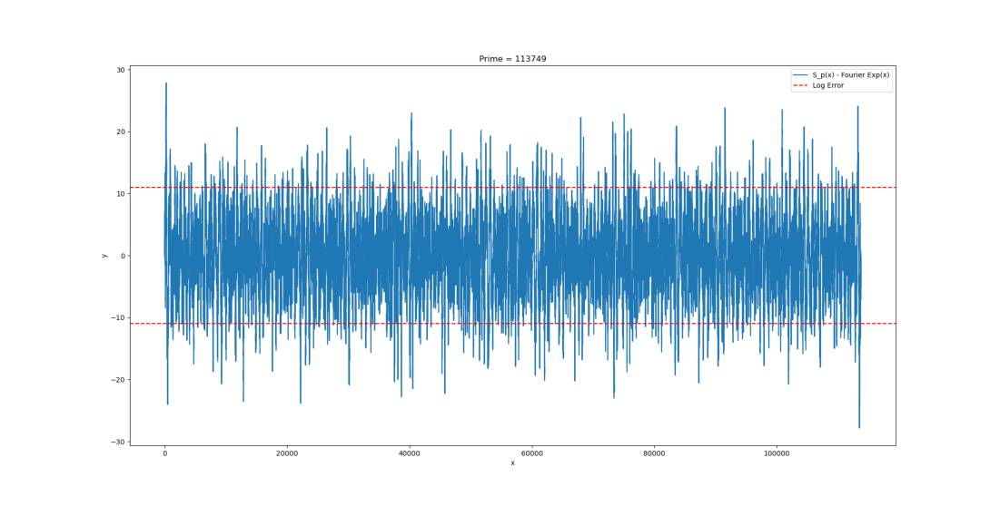

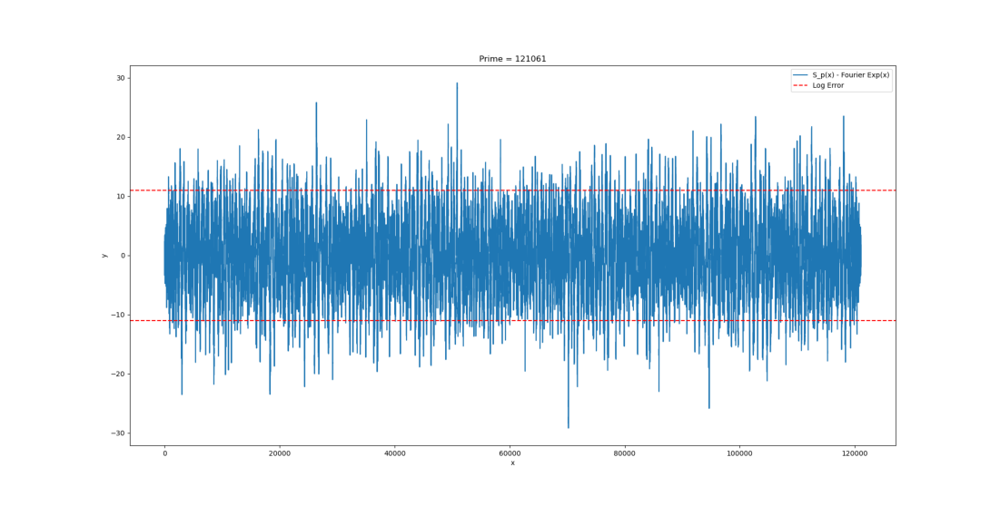

In [56]:
for prime in random.choices(df_small_mag["prime"].values, k = 3):
    plot_diff_lst(prime)

Basically these have some sort of antisymmetry, where the index of the highest peak, reflected across the middle, is the index of the lowest valley. Further, the magnitude of the peak and valley are basically the same

In [57]:
df[df["mag_diff"] < .08]["dist_check"].sort_values()

123    0.00
54     0.00
94     0.00
110    0.00
117    0.00
       ... 
130    0.00
1      0.00
126    0.00
131    0.00
44     8.78
Name: dist_check, Length: 63, dtype: float64

In [58]:
df[(df["mag_diff"] < .08) & (df["dist_check"] == 8.78)]

,prime,pos_error,neg_error,x_pos_error,x_neg_error,max_error,max_error_ind,x_max_error,mag_diff,mod_4,dist_check
44,105097,21.34,-21.35,79.66069,29.11691,21.35,0,29.11691,0.01,1,8.78


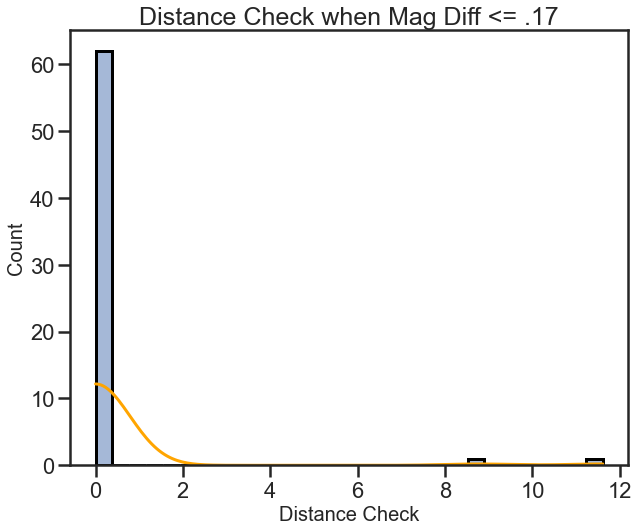

In [59]:
histplot('dist_check', df = df[df["mag_diff"] <= .17], title = "Distance Check when Mag Diff <= .17", savefig = True, savename = "Dist Check")

In [60]:
data = pd.DataFrame({
    'Mag Diff Ind' : df["mag_diff"].apply(lambda diff : "<= .17" if diff <= .17 else "> .17"),
    'Prime Mod 4'  : df["mod_4"]
    })
contingency_table = pd.crosstab(data["Prime Mod 4"], data["Mag Diff Ind"])

contingency_table

Mag Diff Ind,<= .17,> .17
Prime Mod 4,,
1,64,1
3,0,70


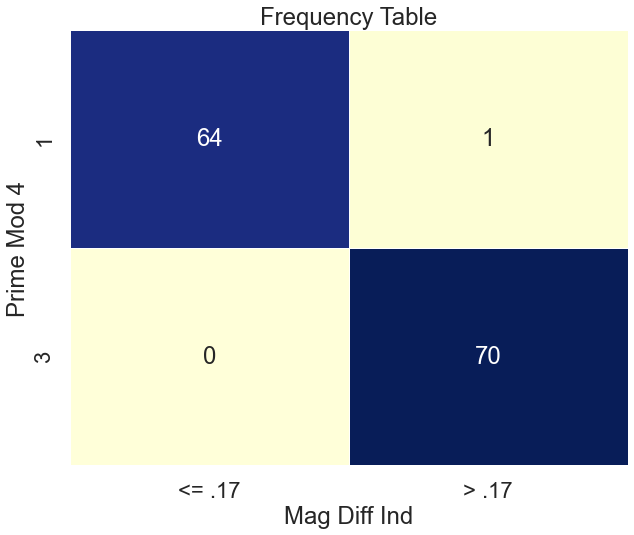

In [61]:
sns.set_style("whitegrid")

# Create a heatmap of the contingency table (excluding the margins for better visualization)
heatmap_data = contingency_table

plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, annot=True, cmap="YlGnBu", fmt="d", linewidths=.5, cbar = False)
plt.title("Frequency Table")
path_to_save = f"{plot_path}/Frequency Table.png"
plt.savefig(path_to_save)
plt.show()

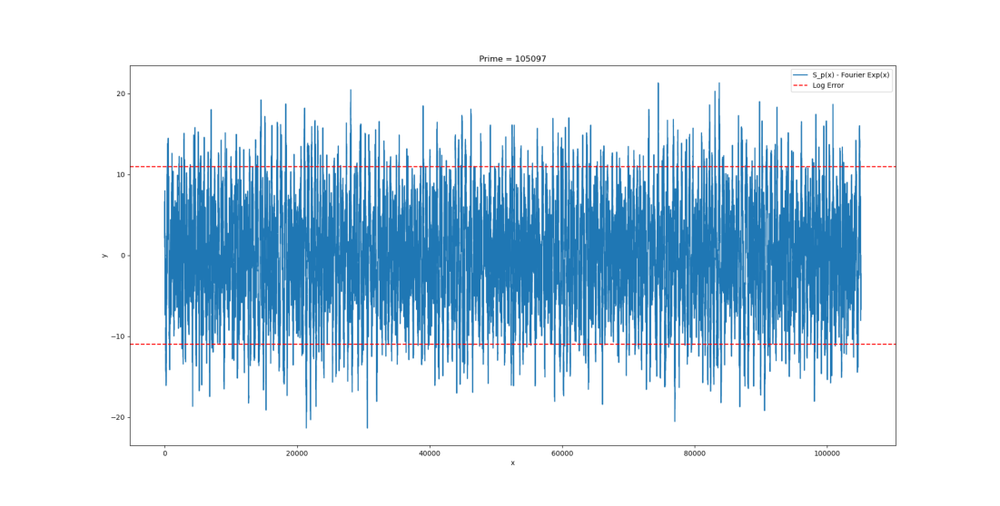

In [62]:
plot_diff_lst(105097)

This one you can tell has two peaks and two valleys that are pretty much the same. So if the peaks are p1, p2 and the valleys are v1, v2, usually we get pi matches with vi, but here we have pi matching with vj 

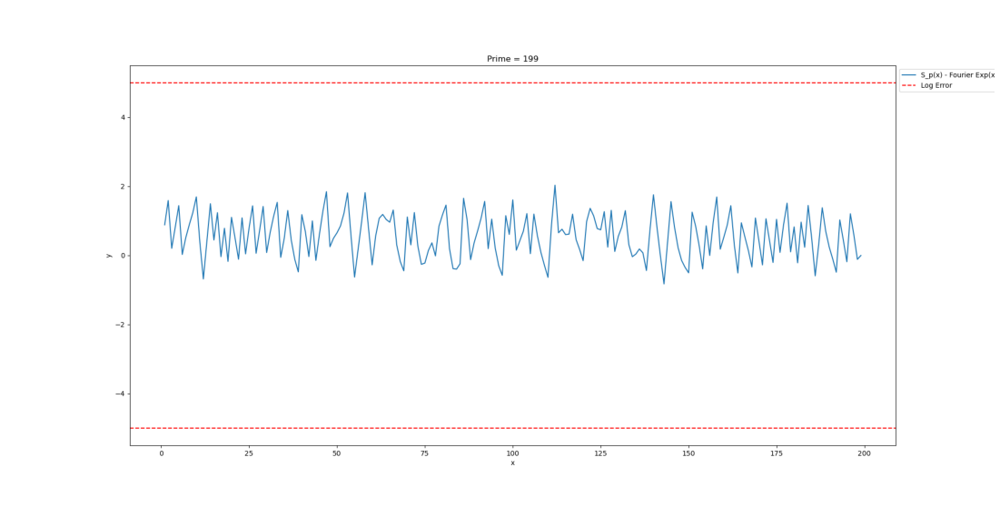

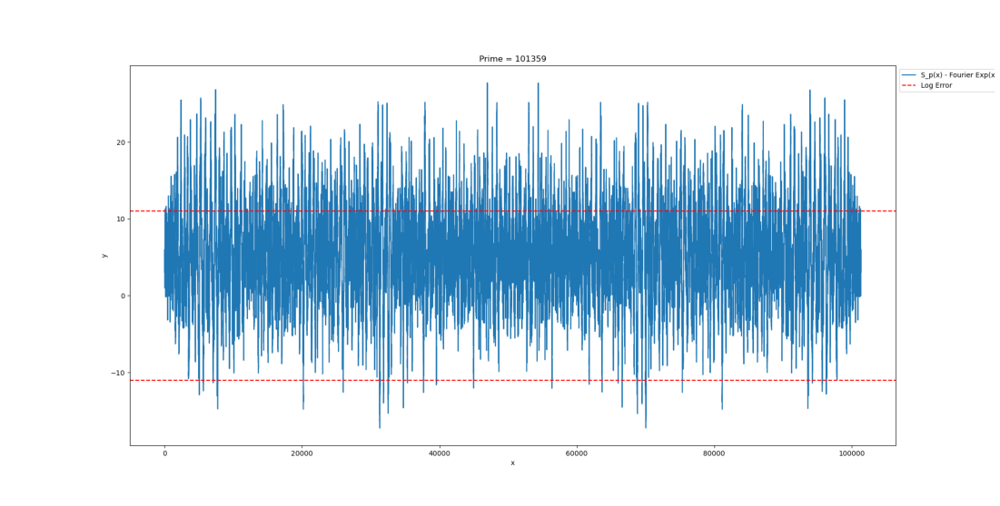

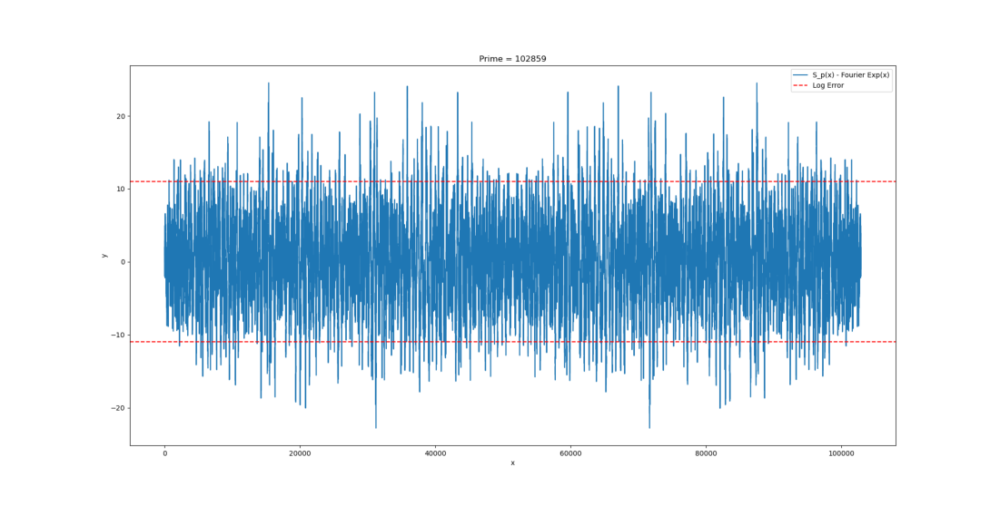

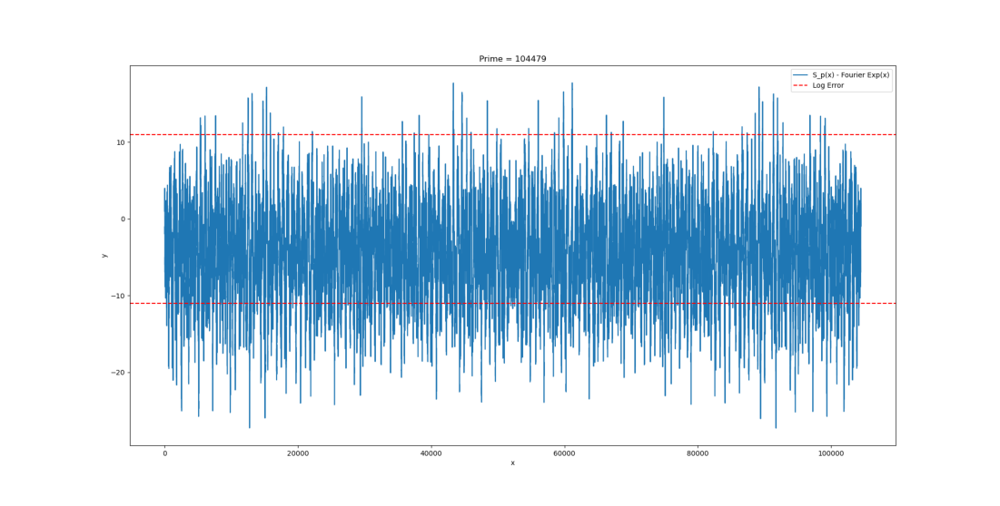

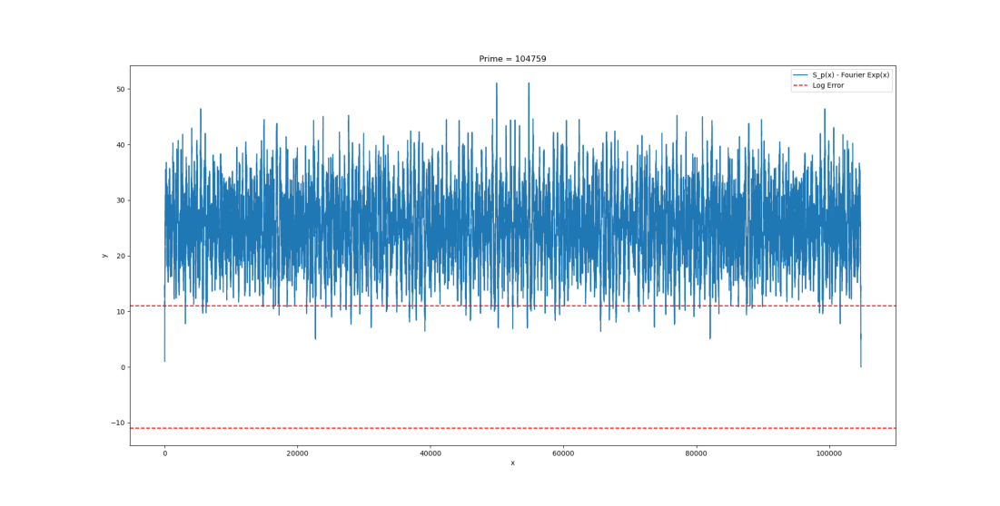

...

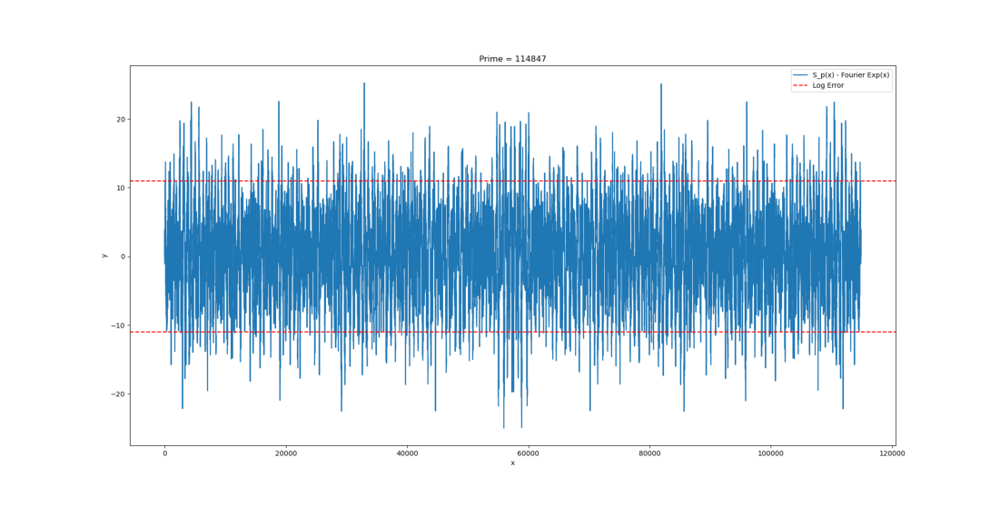

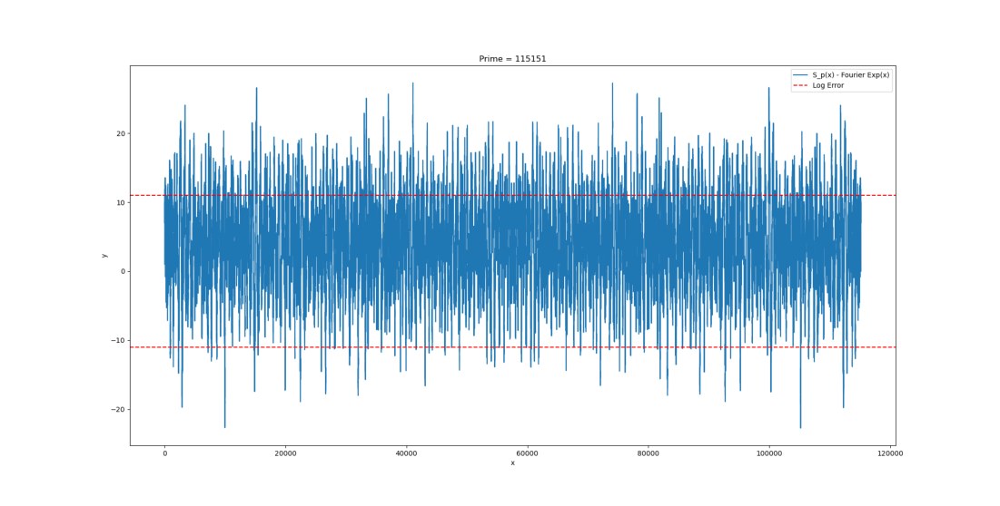

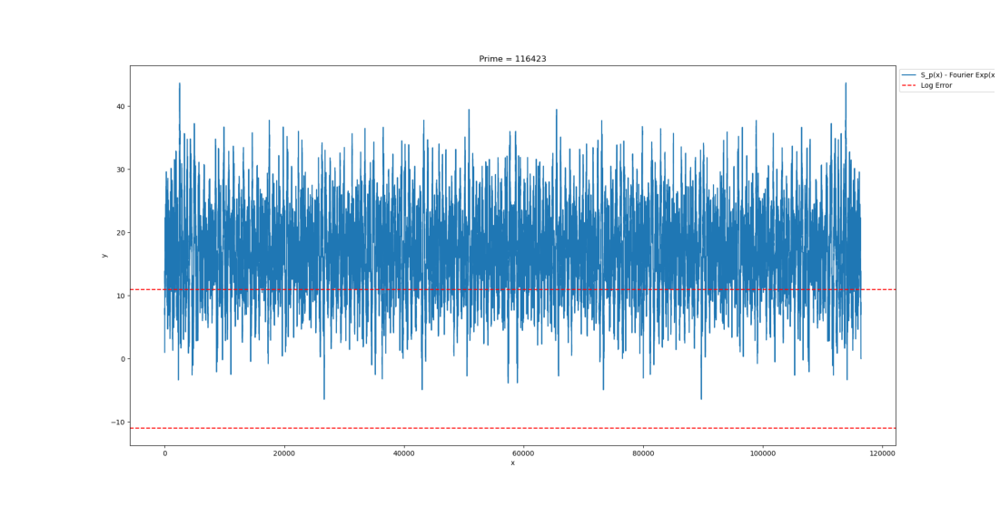

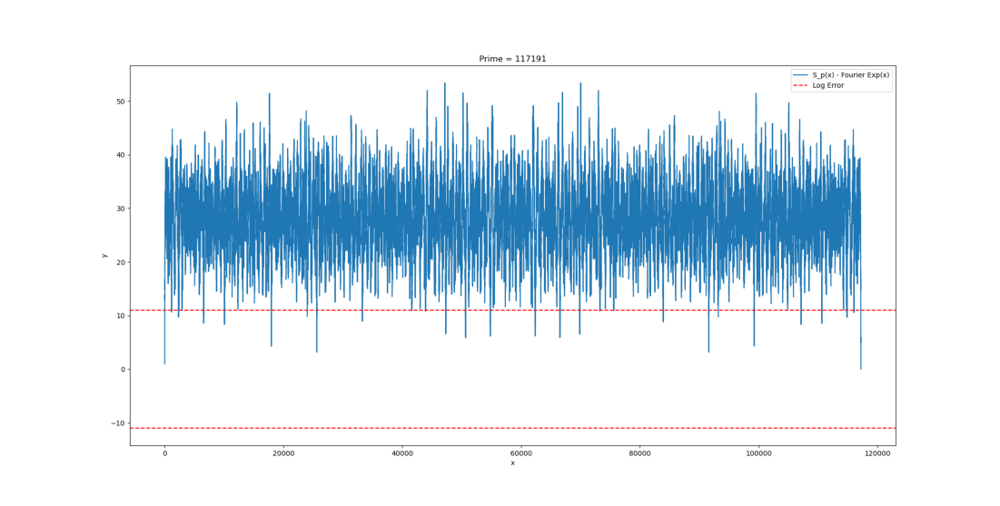

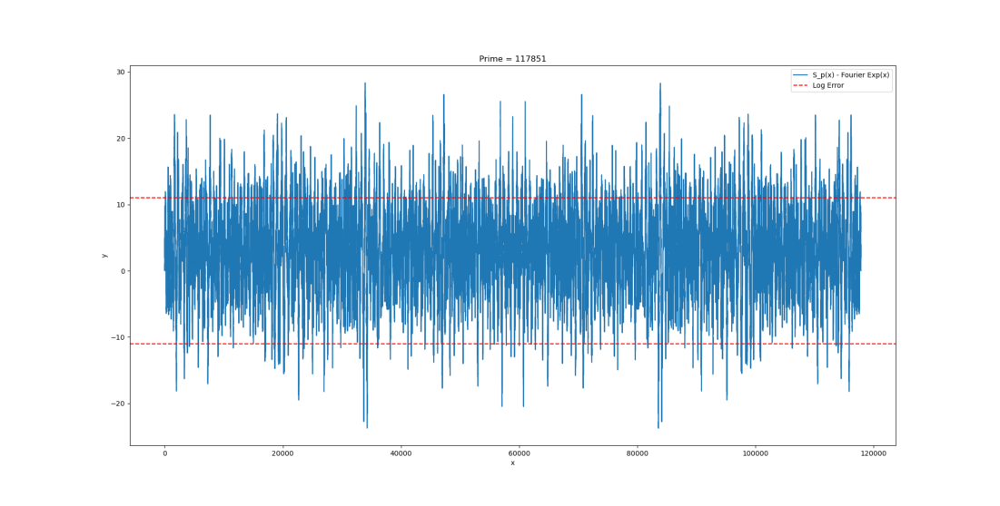

Prime = 118147 hasn't been analyzed yet


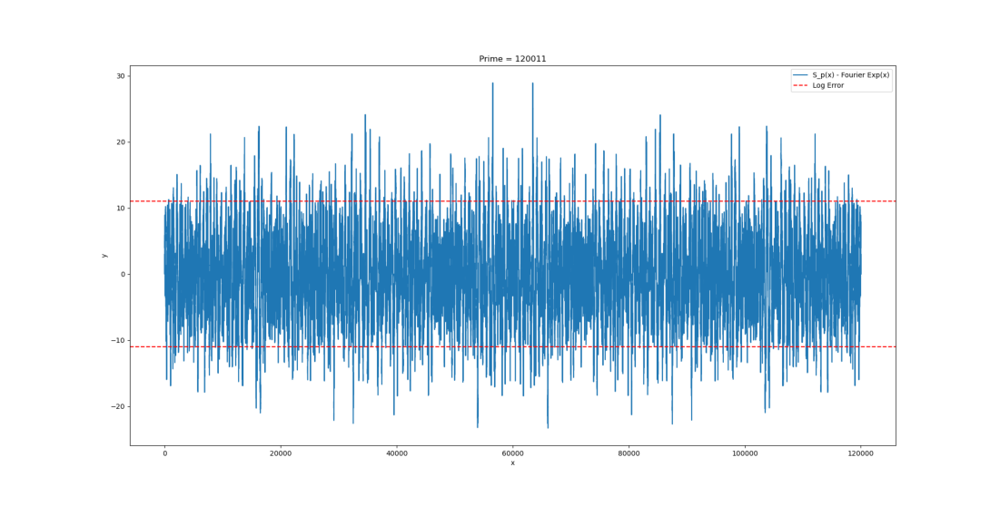

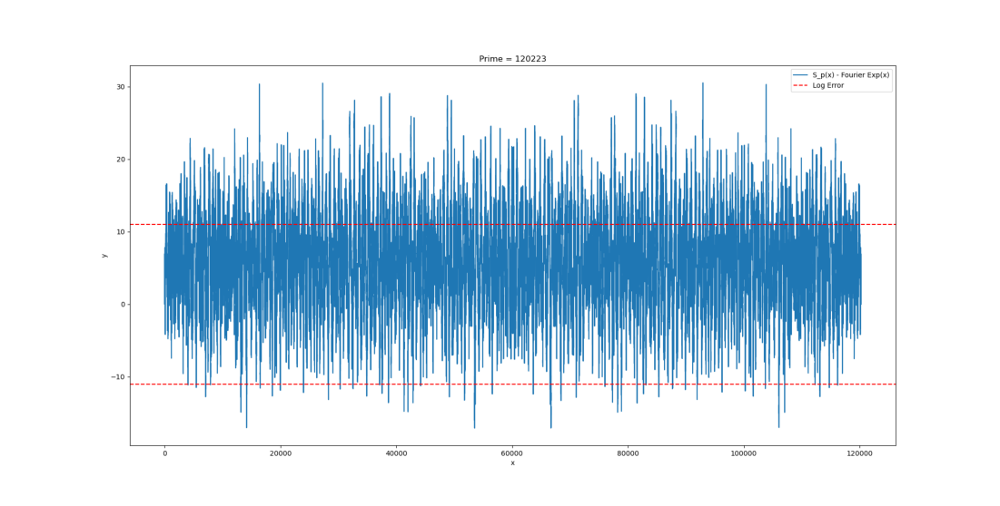

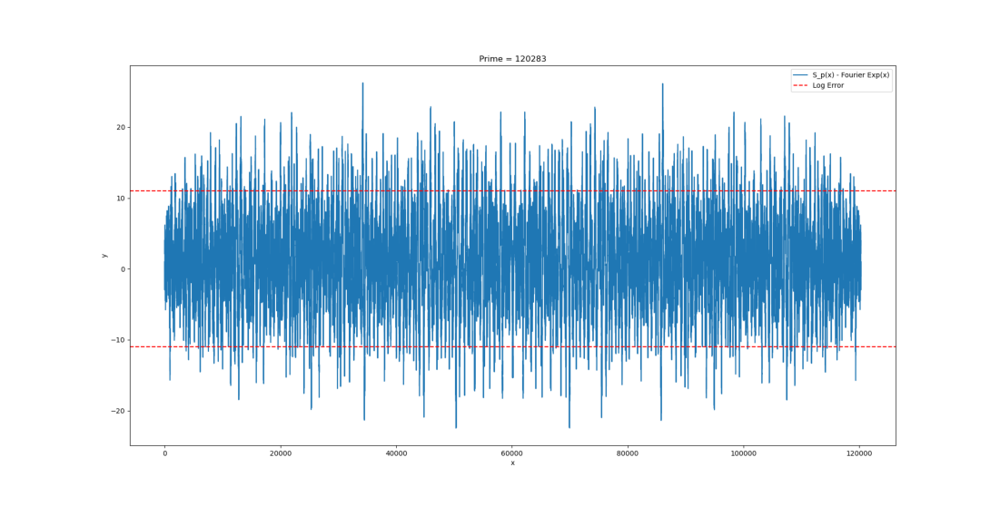

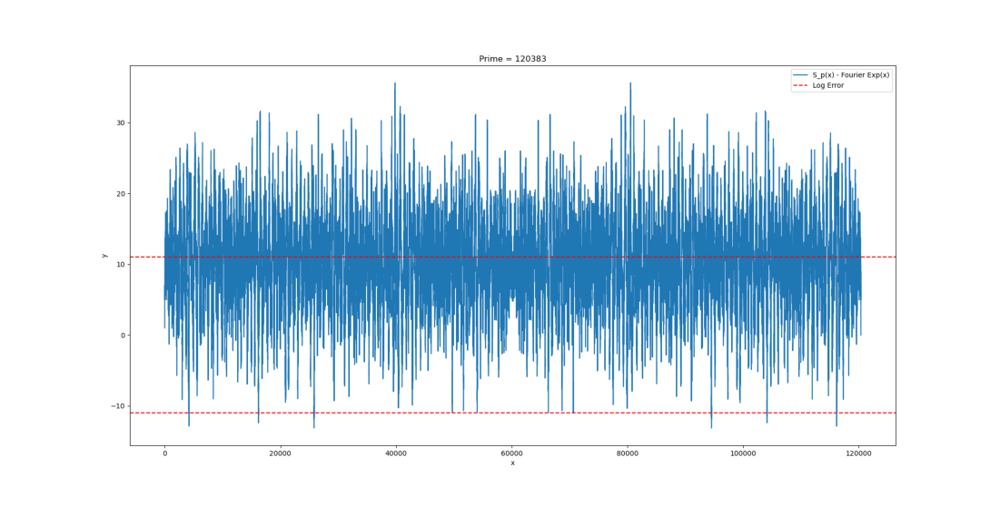

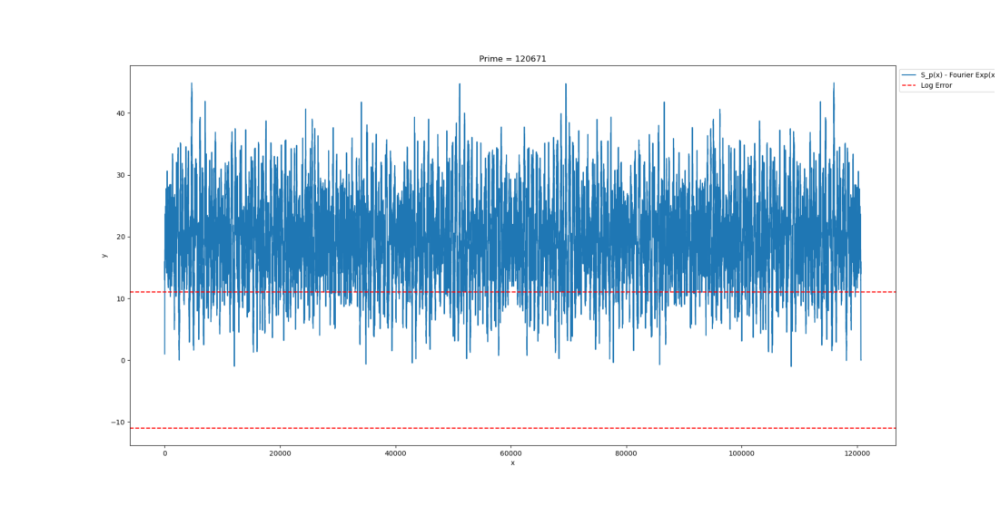

...

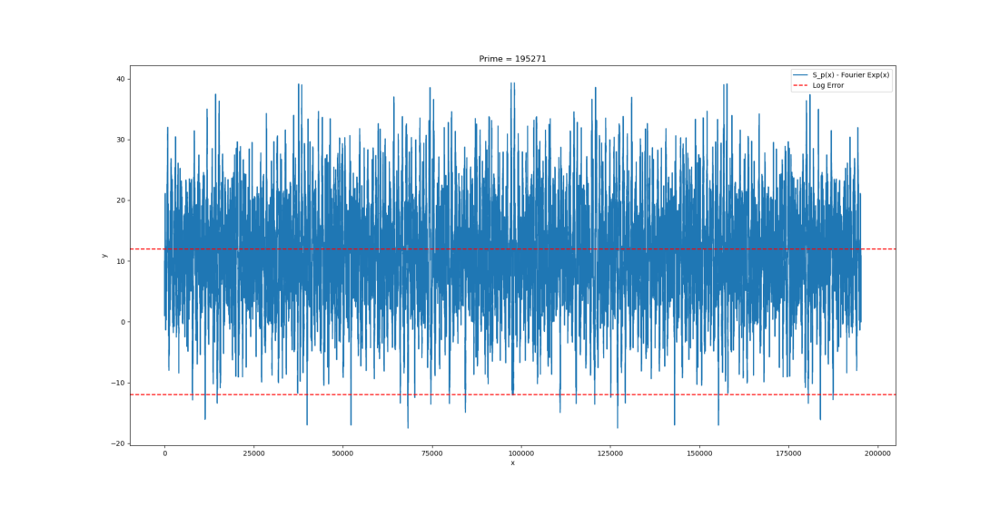

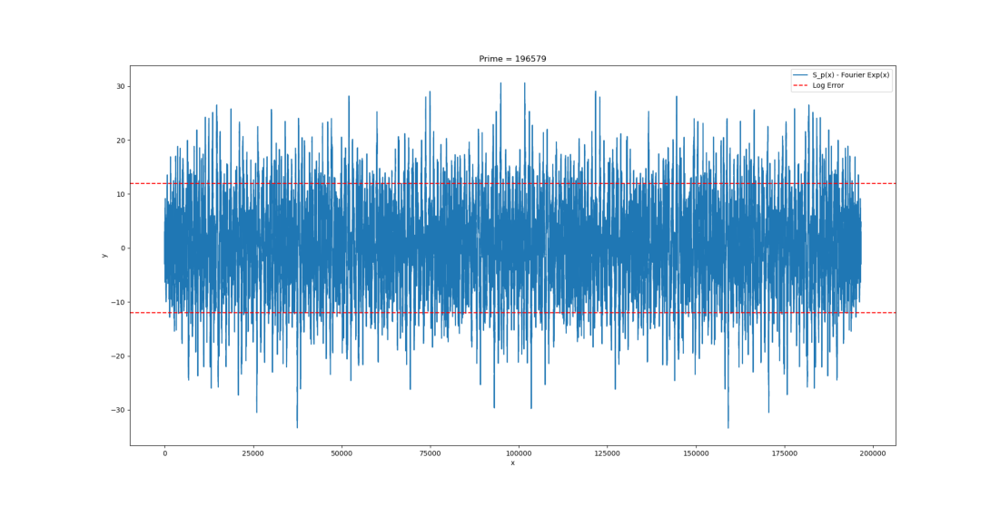

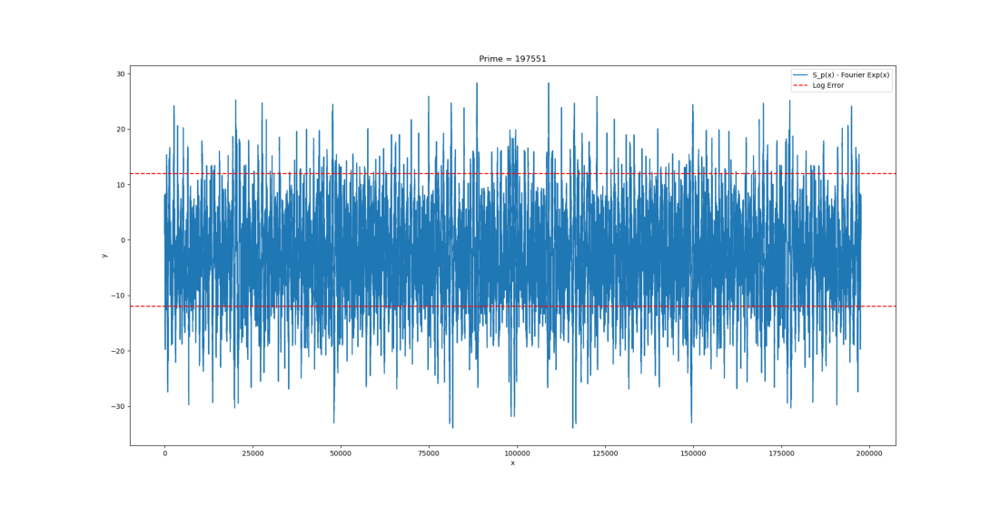

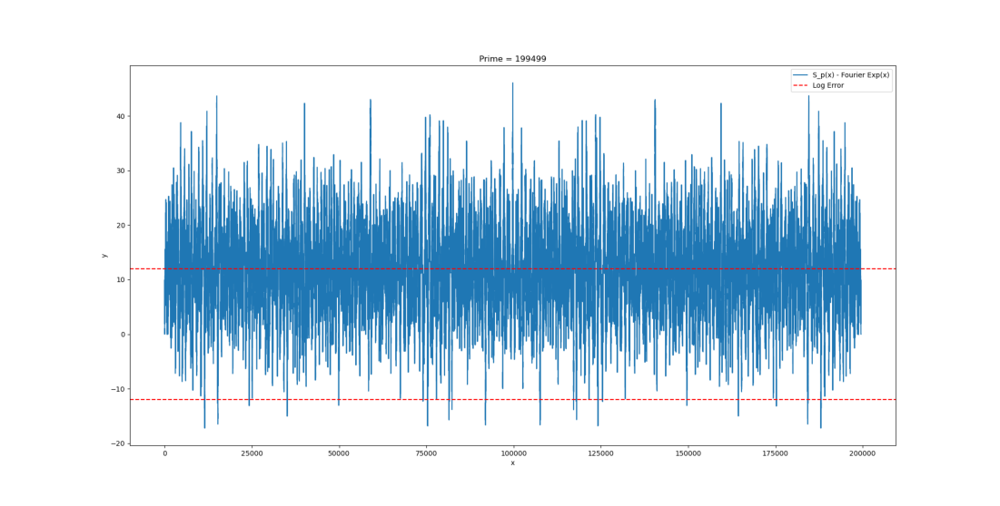

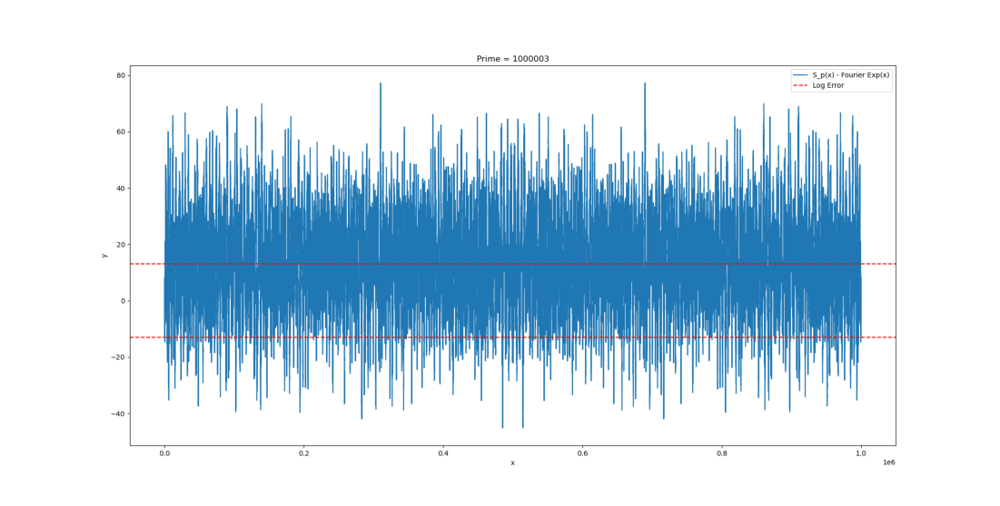

In [63]:
for prime in df['prime']:
    if prime % 4 == 3:
        plot_diff_lst(prime)

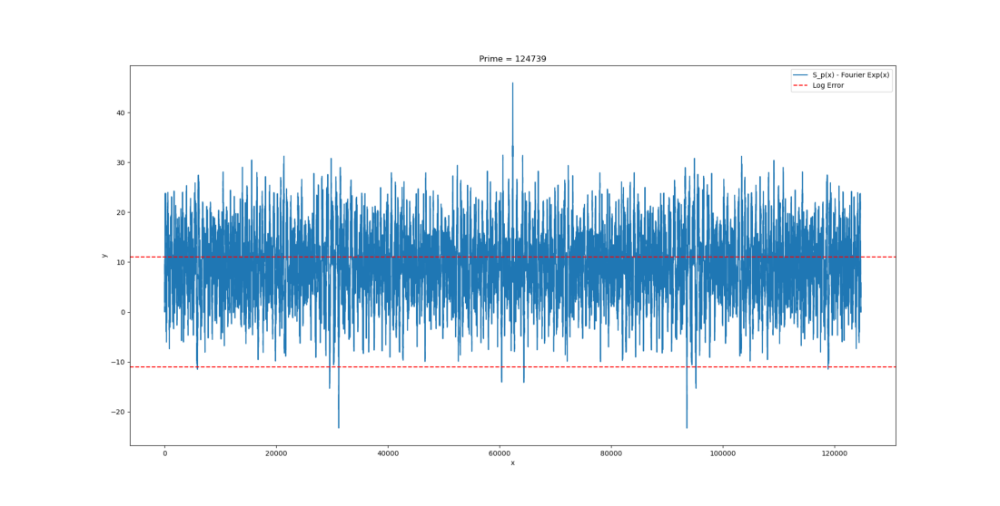

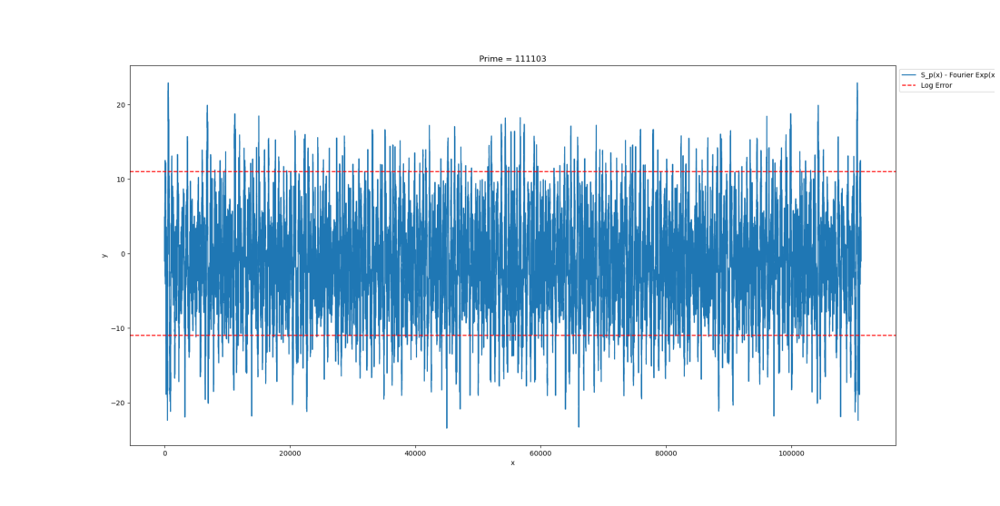

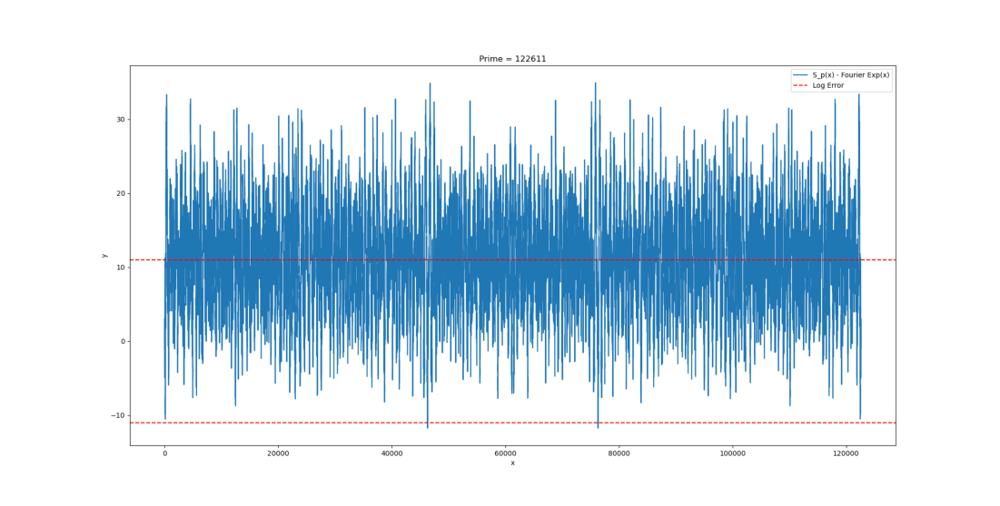

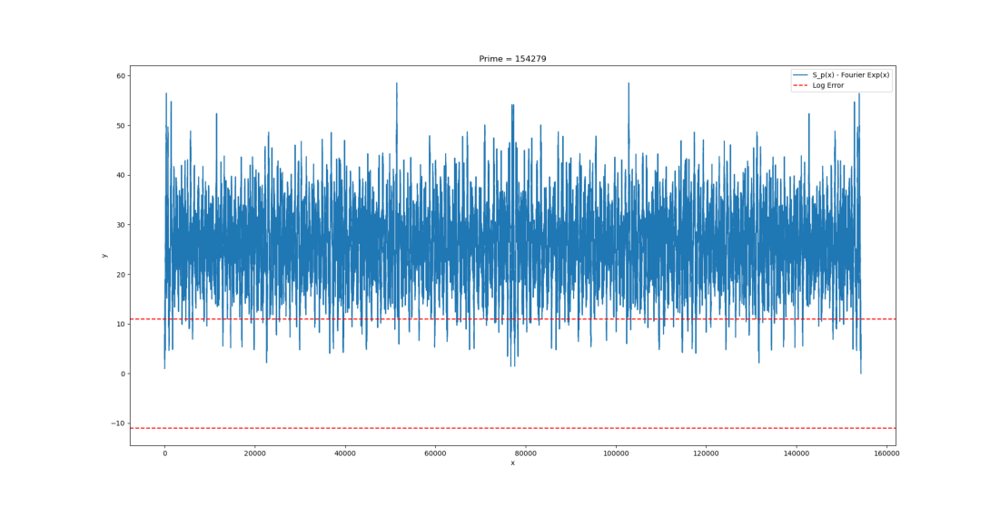

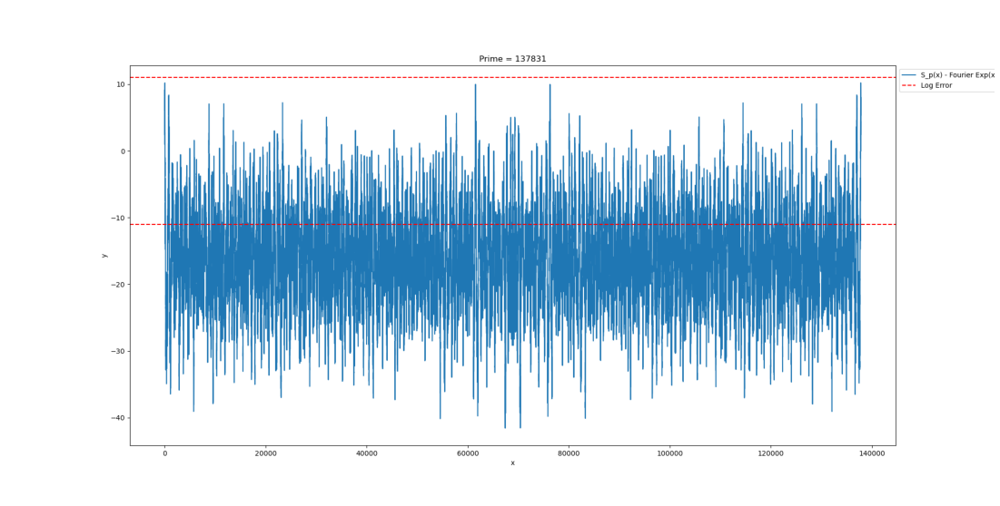

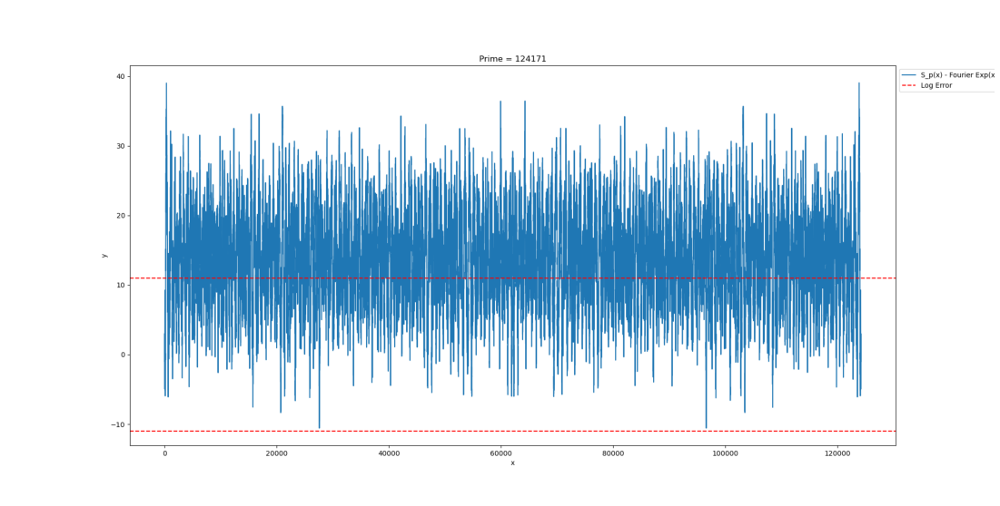

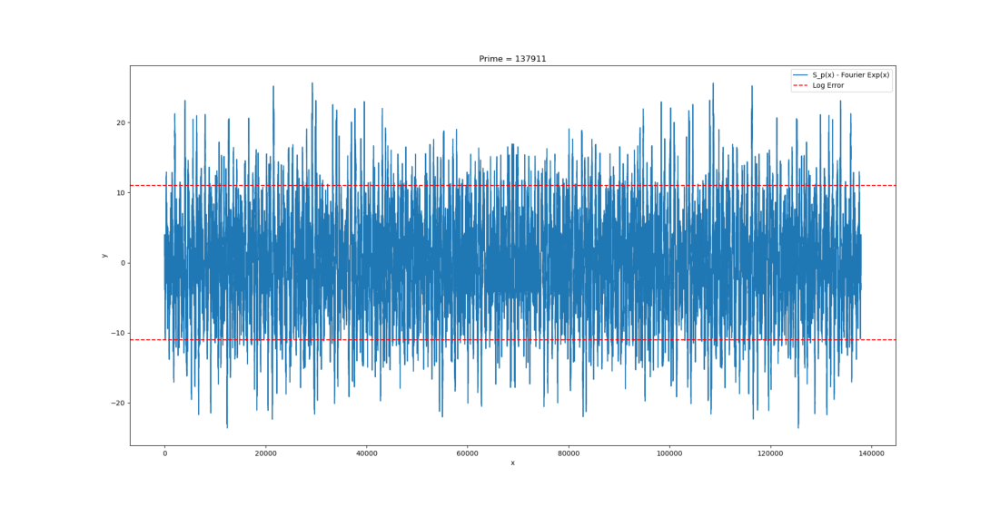

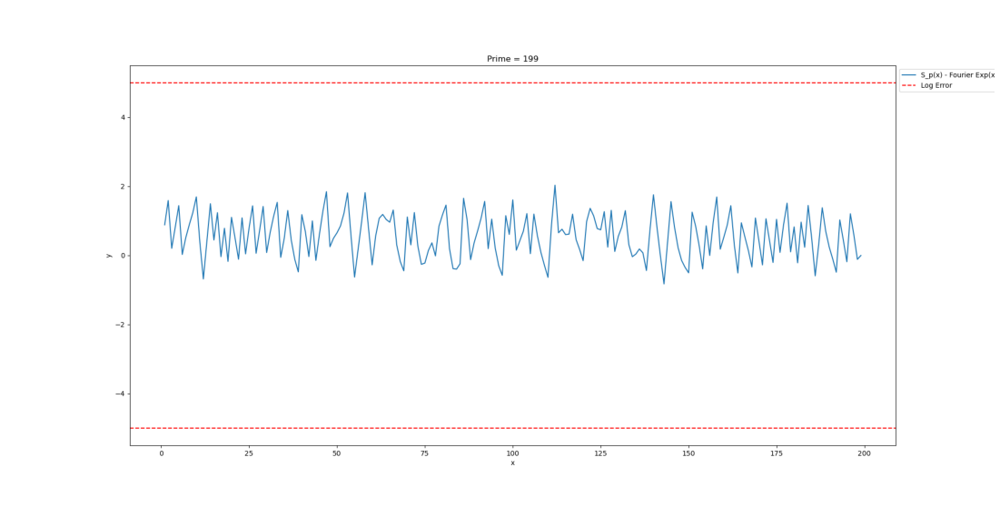

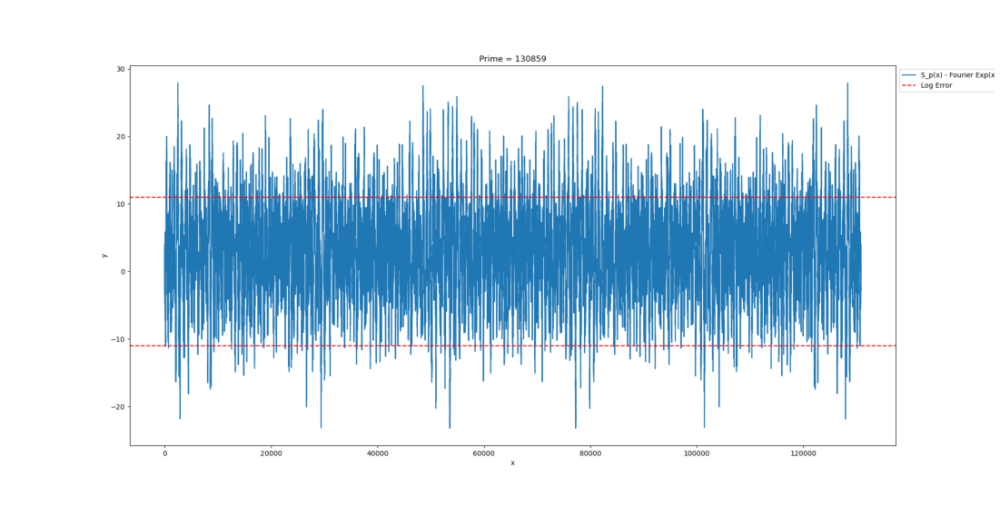

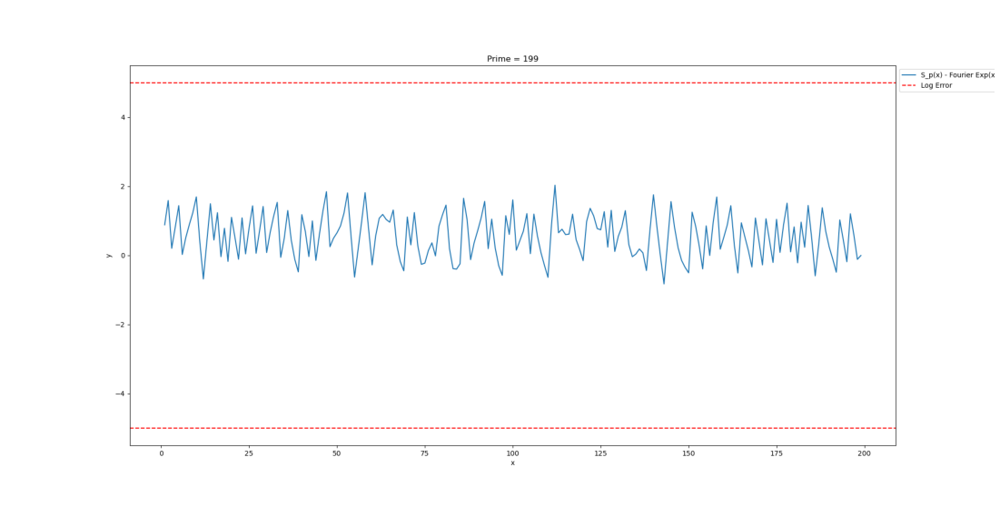

In [64]:
for prime in random.choices(df[df["mod_4"] == 3]["prime"].values, k = 10):
    plot_diff_lst(prime)

Ok I later found something probably trivial but really cool: it seems that *all* primes that are congruent to 1 modulo 4 have some form of *antisymmetry*. By that I mean that flipping across the horizontal axis and then across the vertical axis makes the diff plot roughly the same (i.e. if you rotate the plot 180 degrees it looks kinda similar).

On the other hand, *all* primes that are congruent to 3 modulo 4 seem to have some form of *symmetry*. By that I mean flipping across the vertical axis seems to retain the diff plot

Interestingly, it's not exact, but it's approximately correct every time

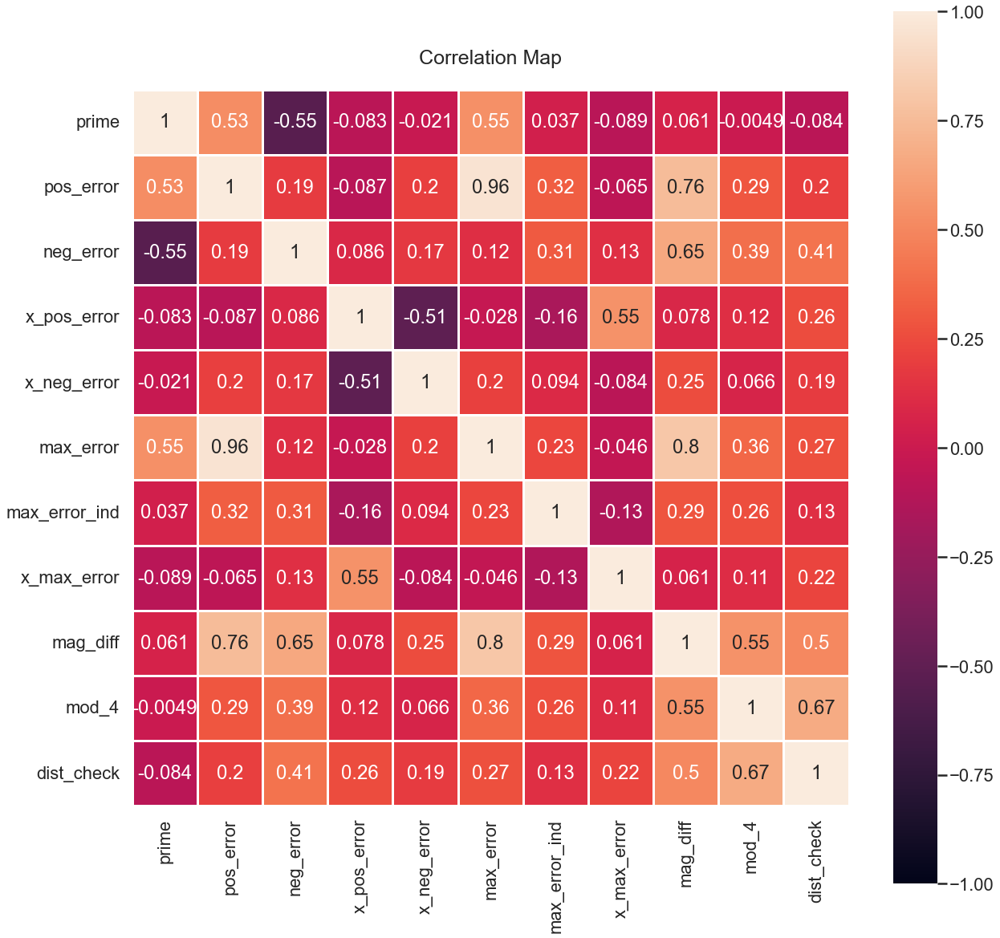

In [65]:
plt.figure(figsize = (20,20))
sns.heatmap(df.corr(), square = True, annot = True,
           vmin = -1, vmax = 1, linewidths = 3)

plt.title("Correlation Map\n", fontsize = 25)
plt.xticks(rotation = 90)
plt.yticks(rotation = 0)
plt.show()

Honestly this is not a super relevant plot because all of this is basically feature engineering (with a lot of non linear stuff like max/min), which means looking at correlation is not entirely relevant.

What is interesting though is seeing if more patterns emerge by looking at primes that are or aren't congruent to 1 mod 4.

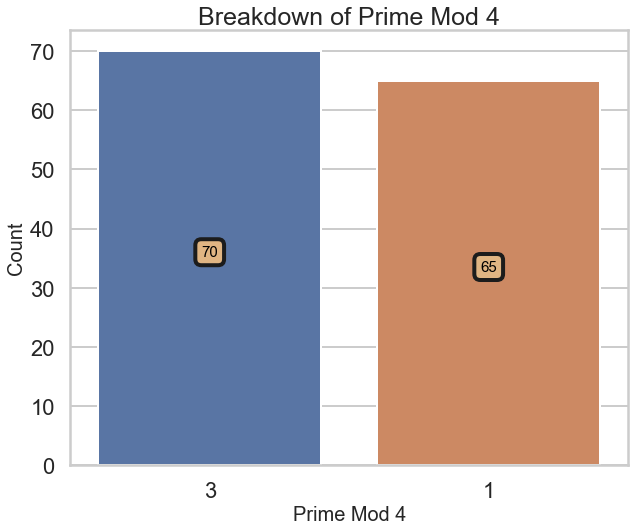

In [66]:
countplot('mod_4')

In [67]:
df_1 = df[df["mod_4"] == 1]
df_3 = df[df["mod_4"] == 3]

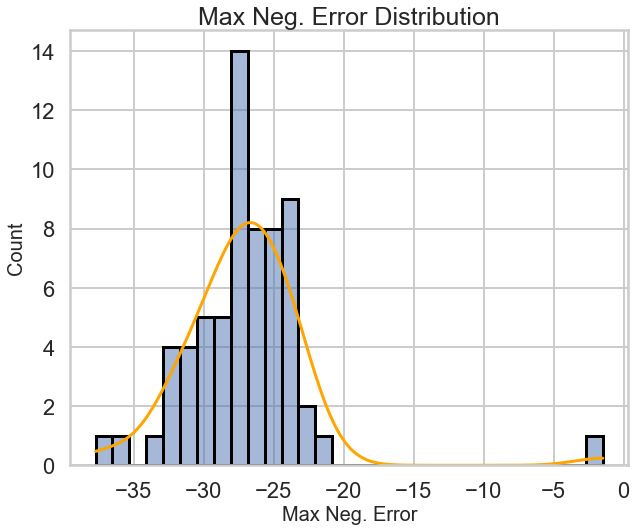

In [68]:
histplot("neg_error", df= df_1[df_1['neg_error'] > -50])

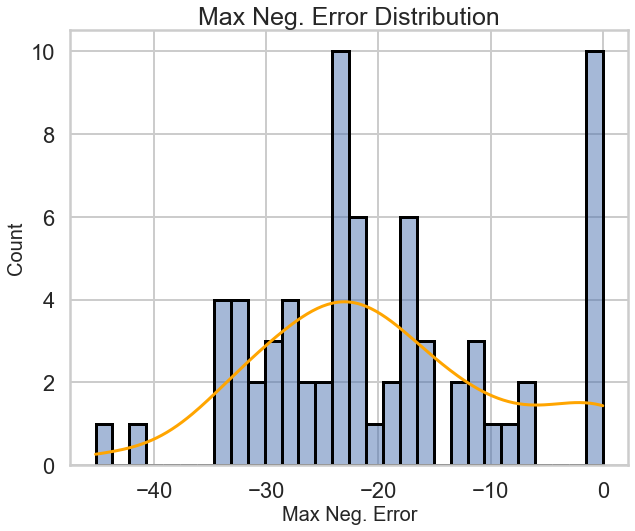

In [69]:
histplot("neg_error", df= df_3)

Here we see something interesting: only primes congruent to 3 mod 4 are the 0 max neg error property (recall this is a property related to translation). Maybe there's a correlation between translation and mod_4.

Ok, I just plotted each prime that 3 mod 4 and 1 mod 4 and here are my observations: <br>
- *all* primes that were 1 mod 4 had errors centered around 0.
- In other words, *all* weird translations happen with primes that are 3 mod 4
- It's not the case that *all* 3 mod 4 primes are translated.
- In other words, translation only if 3 mod 4, but the converse isn't true

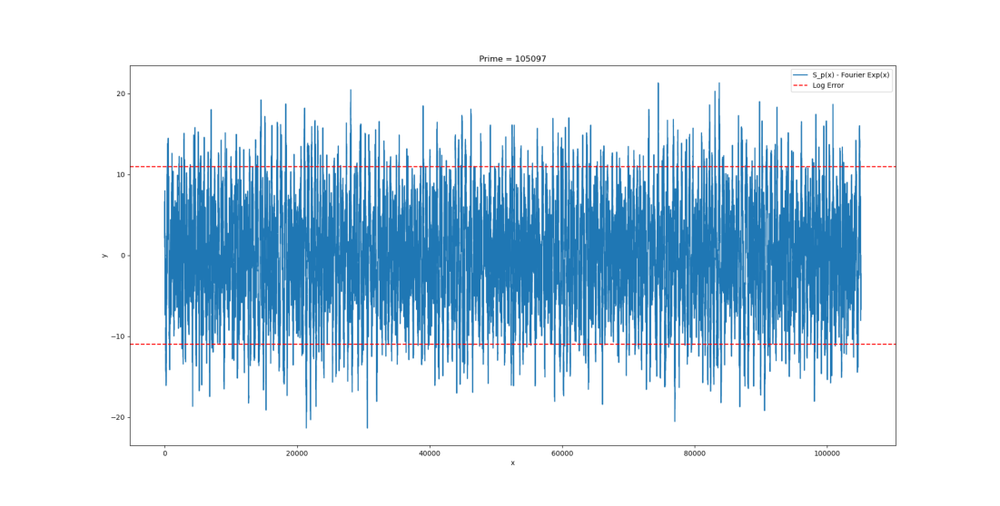

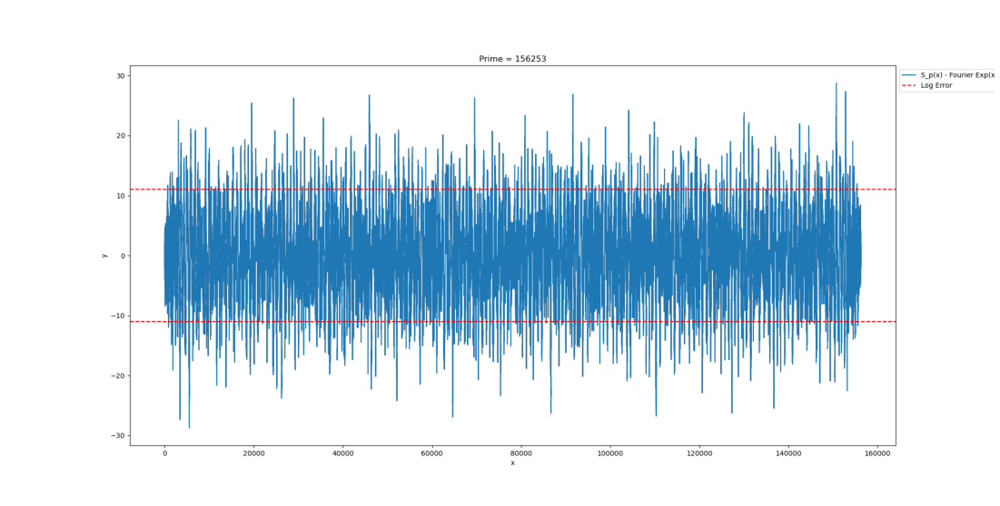

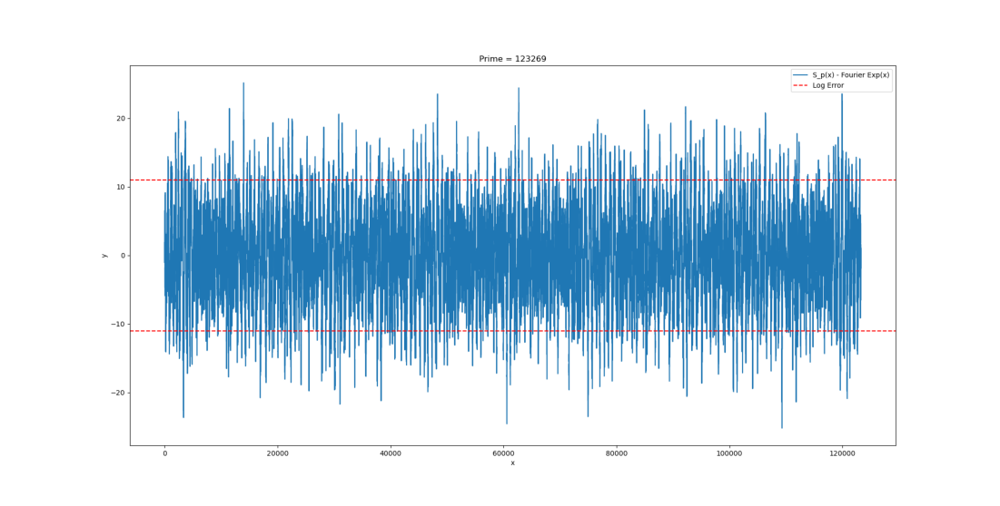

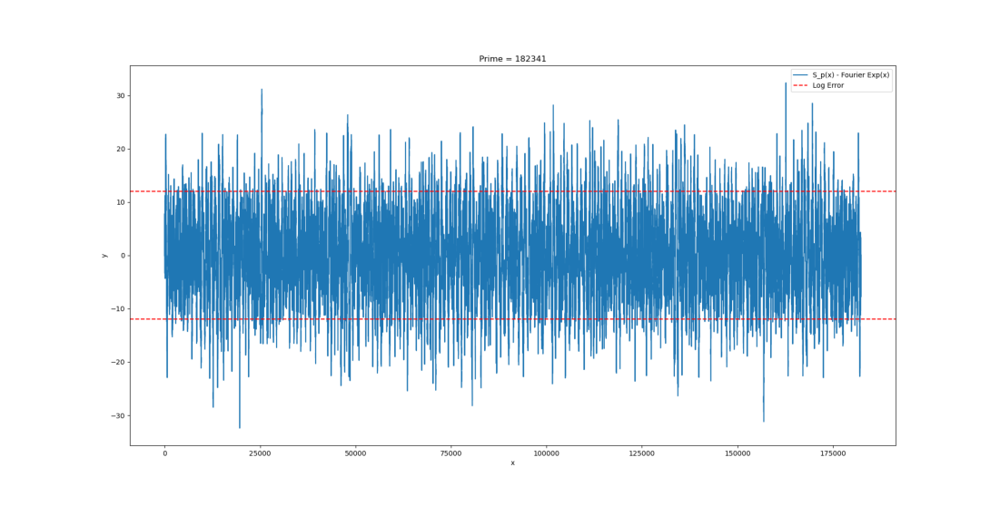

In [70]:
for prime in random.choices(df_1['prime'].values, k = 4):
    plot_diff_lst(prime)

Notice every diff plot is antisymmetric and centered around 0!

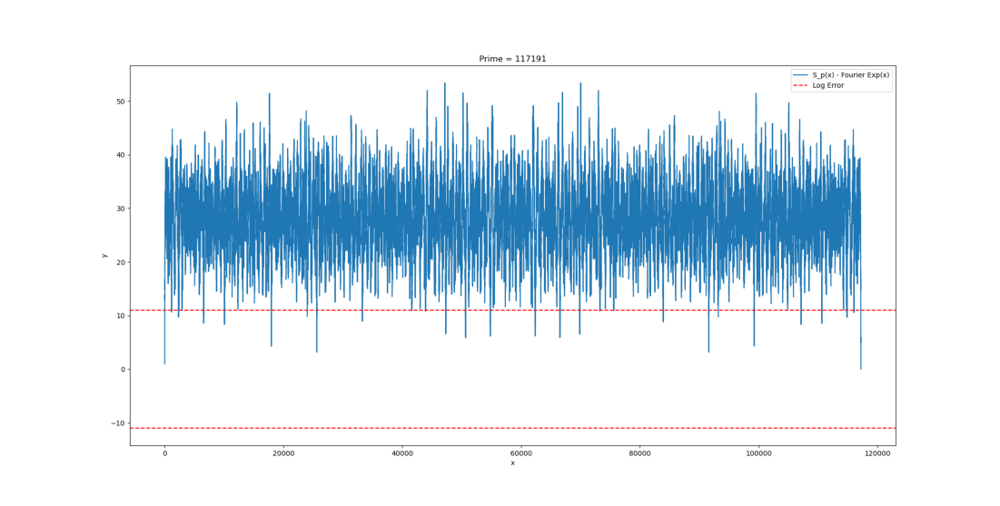

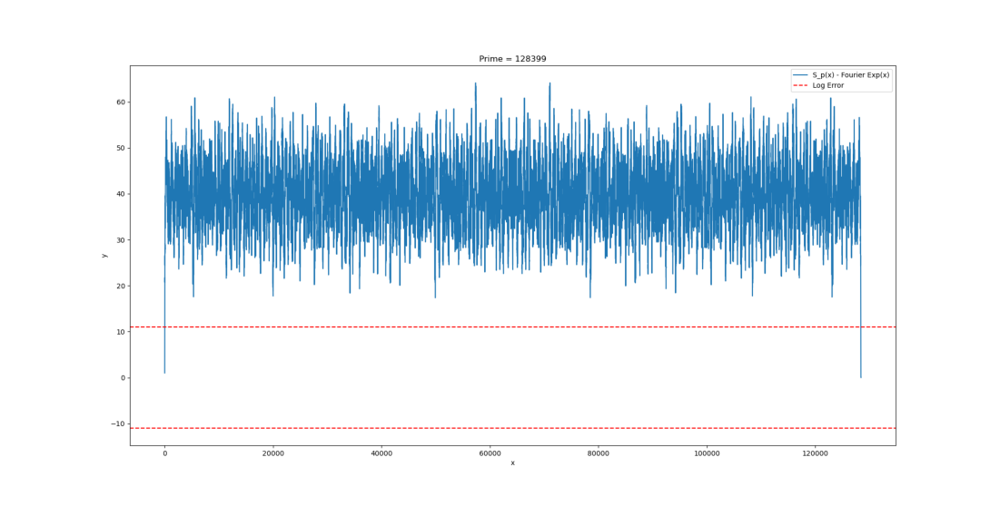

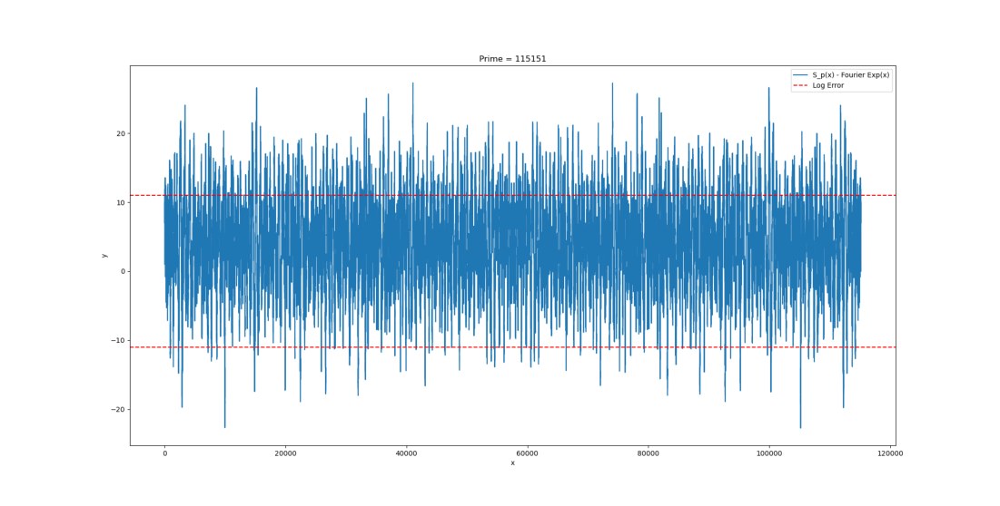

In [71]:
for prime in random.choices(df_3['prime'].values, k = 3):
    plot_diff_lst(prime)

Notice these are all symmetric and may or may not be all translated. Here's an example of one that isn't translated

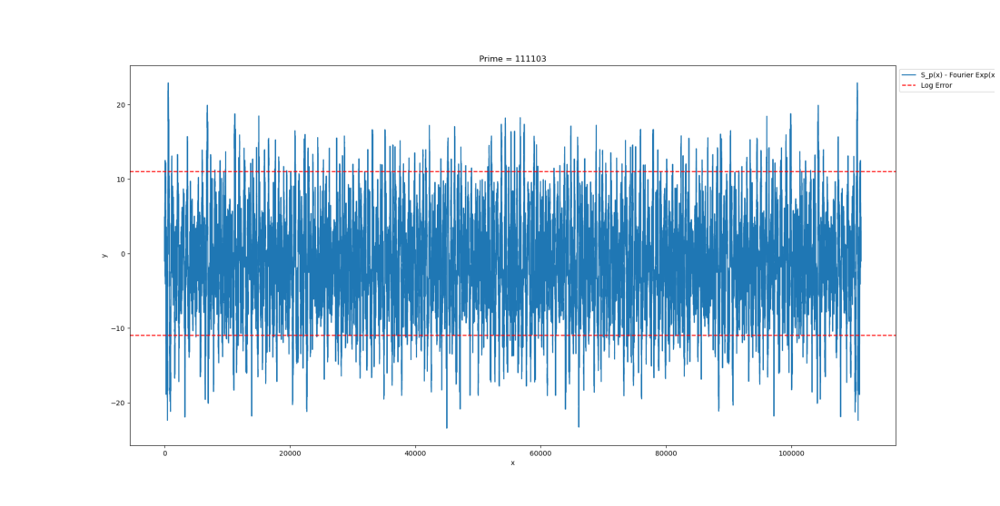

In [72]:
plot_diff_lst(111103)

Now let's actually analyze the difference lists itself

In [73]:
lst_path = os.path.join("/Users", "jcheigh", "Thesis", 'data')
get_lst_path = lambda prime : f'{lst_path}/Prime = {prime} Diff List.txt'

def get_lst(prime):
    path = get_lst_path(prime)

    with open(path, "r") as txt_file:
        lst = txt_file.read().splitlines()

    return [float(x) for x in lst]

large_prime_1 = get_lst(1020389)
large_prime_3 = get_lst(1000003)
small_prime_1 = get_lst(129749)
small_prime_3 = get_lst(115151)

Given the no translation property, we would expect large_prime_1 and small_prime_1 to have means around 0

In [74]:
print(f"Mean of Large Prime 1 Diff List: {round(np.mean(large_prime_1), 10)}")
print(f"Mean of Small Prime 1 Diff List: {round(np.mean(small_prime_1), 10)}")

Mean of Large Prime 1 Diff List: 0.0
Mean of Small Prime 1 Diff List: -0.0


They're exactly 0!

In [75]:
print(f"Mean of Large Prime 3 Diff List: {round(np.mean(large_prime_3), 10)}")
print(f"Mean of Small Prime 3 Diff List: {round(np.mean(small_prime_3), 10)}")

Mean of Large Prime 3 Diff List: 13.5065499004
Mean of Small Prime 3 Diff List: 4.1492537625


This also aligns; they're not completely 0.

We also expect large_prime_1 and small_prime_1 to be antisymmetric. By this we mean data(i) ~ -1 * data(-i).

In [178]:
def plot_check(lst, name, xlabel):
    plt.figure(figsize = (10,8))
    p = sns.histplot(lst, bins = 30,
                    kde = True, fill = True, 
                    edgecolor = 'black', linewidth = 3
                    )
                        
    p.axes.lines[0].set_color("orange")
    plt.title(name)
    plt.xlabel(xlabel)

    path_to_save = f"{plot_path}/{name}.png"
    plt.savefig(path_to_save)
    plt.show()
    
def antisymmetry_check(lst):
    p = len(lst)
    midL = (p-1)//2 
    midR = (p+1)//2 
    #return [lst[midL - d] + lst[midL + d] for d in range(midL + 1)]
    return [lst[n] + lst[-n-3] for n in range(midL)]
    
def symmetry_check(lst):
    p = len(lst)
    mid = (p-1)//2
    #return [lst[mid+ d] - lst[mid - d] for d in range(0, mid + 1)]
    return [lst[n] - lst[-n-3] for n in range(mid)]

#antisymmetry_check = lambda lst : [lst[i] + lst[-i] for i in range(len(lst) // 2)]
#symmetry_check     = lambda lst : [lst[i] - lst[-i] for i in range(len(lst) // 2)]

def plot_antisym_check(lst, name):
    plt.figure(figsize = (10,8))
    lst = antisymmetry_check(lst)
    plot_check(lst, name, "D(x) + D(-x)")

def plot_sym_check(lst, name):
    plt.figure(figsize = (10,8))
    lst = symmetry_check(lst)
    plot_check(lst, name, "D(x) - D(-x)")

In [195]:
a = [1,2,3,4,5,6,7]
a[-3]

5

In [193]:

large_prime_3[(1000003 -1)//2 + 1] 


IndexError: list index out of range

In [172]:


def offset_error(d, n):
    vals = [abs(large_prime_1[i] + large_prime_1[1020389-i-d]) for i in range(n)]
    return sum(vals)/n

for d in range(1, 20):
    print(d)
    print('=' *20)
    for n in [10, 100, 1000, 10000, 100000, 1000000]:
        print(offset_error(d, n))
        


#for i in range(10):
#   print(f"Front: {large_prime_1[i]}, Back: {large_prime_1[-i-3]}")

1
0.9059999999999999
1.0791999999999995
0.9968099999999954
0.9982830000000841
1.0050743999997465
1.0075217500047198
2
1.0
1.0
1.0
1.0
1.0
1.0
3
0.01800000000000001
0.017800000000000024
0.015759999999999844
0.013888000000000216
0.014416199999989195
0.015568030000192423
4
1.005
1.0005999999999997
0.9995000000000004
0.9995009999999951
0.9993510000000106
0.9992488499998501
5
1.2310000000000003
1.1239999999999997
1.013459999999993
1.0121439999999813
1.0187885999999902
1.0223202400032867
6
1.629
1.5388000000000002
1.4551699999999992
1.4861489999999962
1.4956268000000243
1.497982719999851
7
1.6549999999999998
1.5704000000000007
1.4293099999999972
1.5021750000000071
1.5191184999998957
1.5269644600034757
8
2.023
1.871799999999999
1.7552400000000021
1.8534680000000112
1.8650301999999925
1.8712789299999755
9
2.0989999999999998
1.8628
1.7418699999999911
1.8816780000000013
1.8934658999999694
1.9037665100029093
10
2.285
2.088800000000001
1.9935800000000037
2.170271000000001
2.1716004000000404
2.1813

$E_p(x) + E_p()

In [185]:
a = list(range(7))

for i in range(3):
    print(a[i])
    print(a[7-i-3])

0
4
1
3
2
2


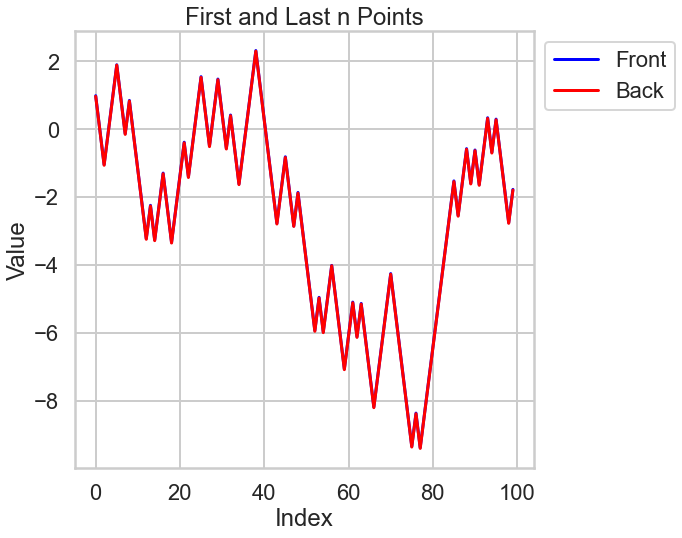

In [141]:
def plot_front_back(lst, n, antisym = False):
    # Extract the first n and last n points
    front = lst[:n] # 0 1 2 3 ... n-1
    back = lst[-n-2:-2] # -n-2, -n-1, -n, ..., -3
    if antisym:
        back = [-x for x in back]
    # Create the x-values for both sets of points
    x_front = range(n)
    x_back = range(n-1, -1, -1)
    
    # Plotting
    plt.figure(figsize=(10,8))
    plt.plot(x_front, front, label="Front", color="blue")
    plt.plot(x_back, back, label="Back", color="red")
    
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.xlabel('Index')
    plt.ylabel('Value')
    plt.title('First and Last n Points')
    plt.tight_layout()
    plt.show()


plot_front_back(large_prime_1, 100, antisym=True)

In [99]:
antisymmetry_check(large_prime_1)[499999:500020]

[-0.009999999999999787,
 -0.010000000000000231,
 1.9800000000000002,
 -0.009999999999999787,
 -0.010000000000000009,
 -0.009999999999999787,
 -2.0100000000000002,
 -0.020000000000000018,
 1.9900000000000002,
 1.99,
 -0.010000000000000009,
 -2.01,
 -2.0199999999999996,
 -2.0100000000000002,
 -2.01,
 -0.009999999999999787,
 1.9899999999999998,
 -0.019999999999999574,
 -2.01,
 -0.010000000000000675,
 -0.009999999999999787]

<Figure size 720x576 with 0 Axes>

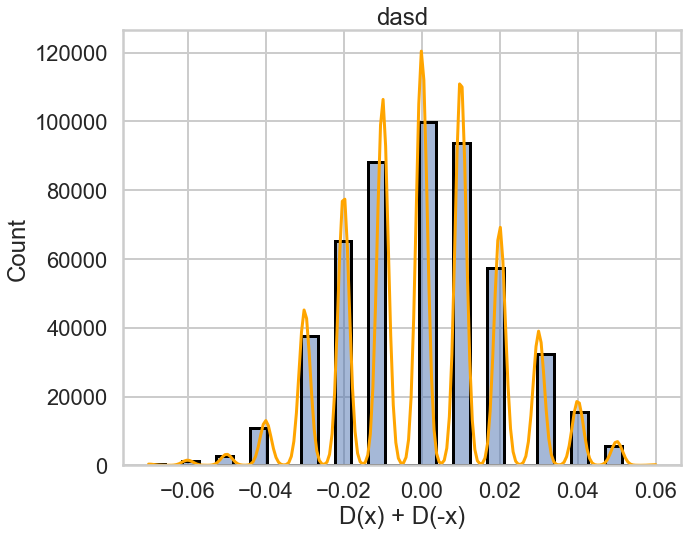

In [174]:
plot_antisym_check(large_prime_1, "dasd")

In [87]:
from collections import Counter 
def custom_round(value):
    """Rounds the value to the nearest of -2, 0, or 2."""
    # List of possible rounded values
    possible_values = [-2, 0, 2]
    
    # Find the value with the minimum difference from the input value
    return min(possible_values, key=lambda x: abs(x - value))

def round_list(lst):
    """Rounds each value in the list using the custom_round function."""
    return [custom_round(value) for value in lst]

for lst in [large_prime_1, large_prime_3, small_prime_1, small_prime_3]:
    a = np.array(antisymmetry_check(lst))
    b = np.array(symmetry_check(lst))
    x = round_list(a)
    y = round_list(b)
    print(f"Anti: {Counter(x)}")
    print(f"Regular: {Counter(y)}")



Anti: Counter({0: 255098, -2: 127549, 2: 127548})
Regular: Counter({-2: 249829, 2: 247692, 0: 12674})
Anti: Counter({2: 393399, -2: 98059, 0: 8544})
Regular: Counter({0: 250001, -2: 125158, 2: 124843})
Anti: Counter({0: 32438, -2: 16219, 2: 16218})
Regular: Counter({2: 30983, -2: 30333, 0: 3559})
Anti: Counter({2: 41230, -2: 13729, 0: 2617})
Regular: Counter({0: 28788, -2: 14545, 2: 14243})


<Figure size 720x576 with 0 Axes>

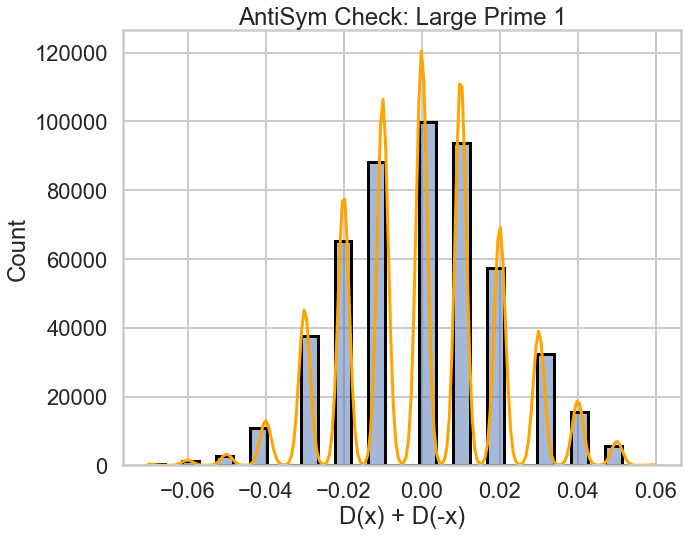

In [176]:
plot_antisym_check(large_prime_1, "AntiSym Check: Large Prime 1")

$D_p(x + \#p) + D_p(\#p -x)$

<Figure size 720x576 with 0 Axes>

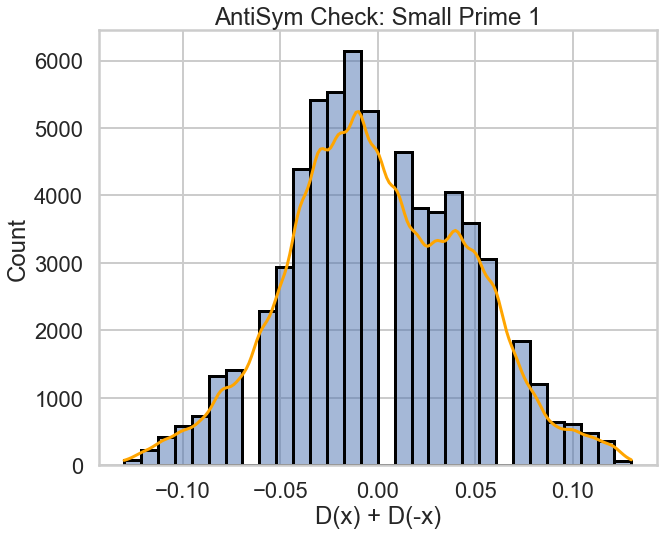

In [177]:
plot_antisym_check(small_prime_1, "AntiSym Check: Small Prime 1")

These are almost identical, weird

<Figure size 720x576 with 0 Axes>

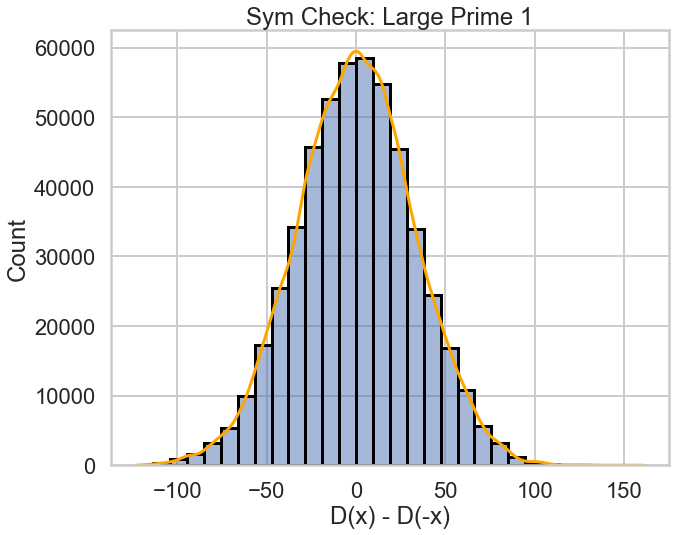

In [179]:
plot_sym_check(large_prime_1, "Sym Check: Large Prime 1")

<Figure size 720x576 with 0 Axes>

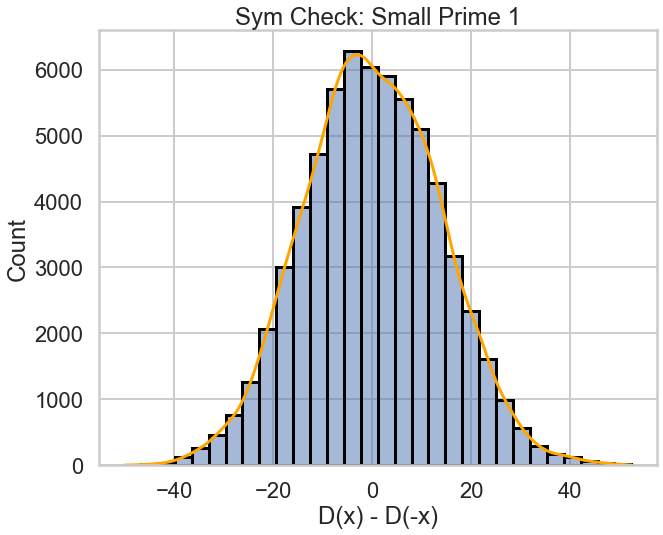

In [180]:
plot_sym_check(small_prime_1, "Sym Check: Small Prime 1")

And these are roughly normal, double weird

<Figure size 720x576 with 0 Axes>

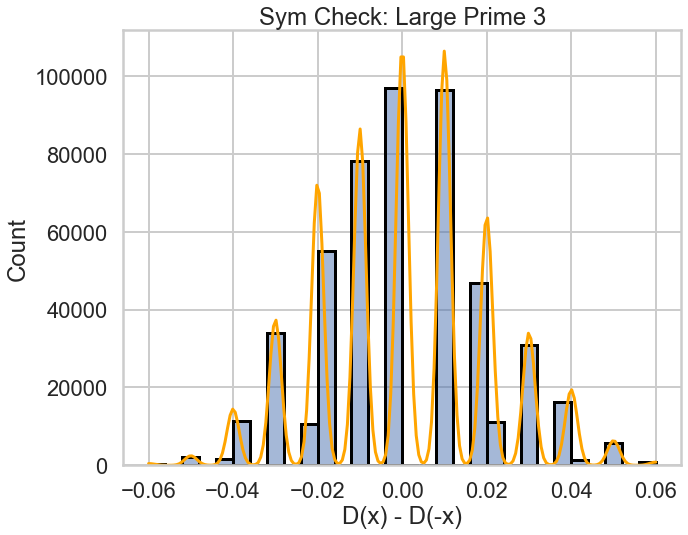

In [181]:
plot_sym_check(large_prime_3, "Sym Check: Large Prime 3")

<Figure size 720x576 with 0 Axes>

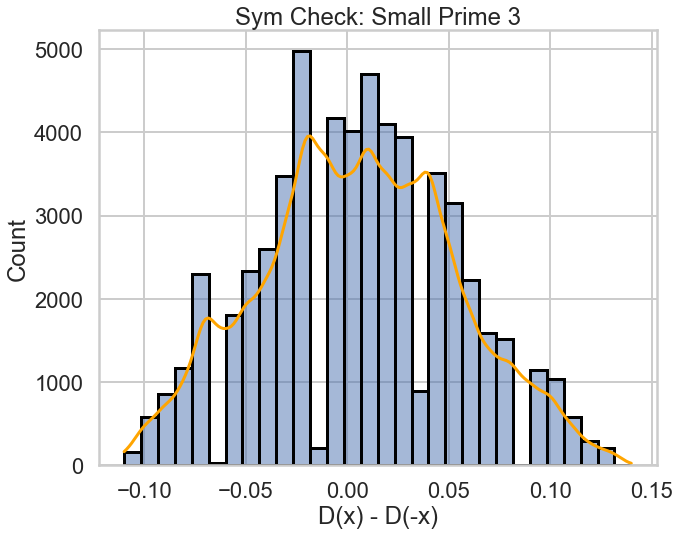

In [182]:
plot_sym_check(small_prime_3, "Sym Check: Small Prime 3")

<Figure size 720x576 with 0 Axes>

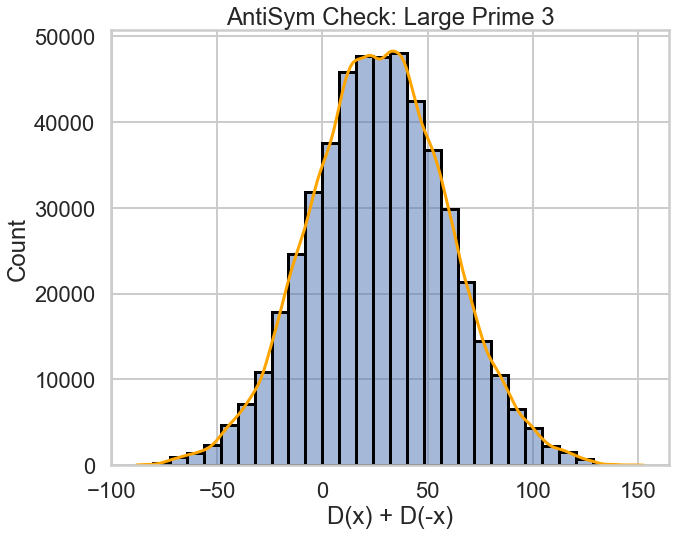

In [84]:
plot_antisym_check(large_prime_3, "AntiSym Check: Large Prime 3")

<Figure size 720x576 with 0 Axes>

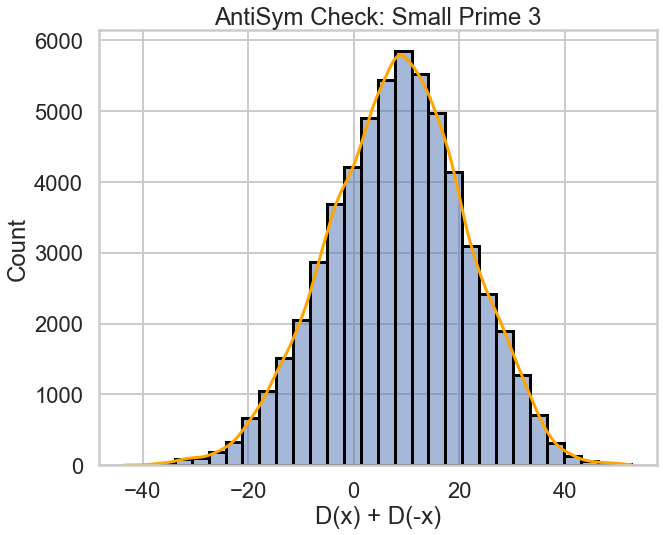

In [85]:
plot_antisym_check(small_prime_3, "AntiSym Check: Small Prime 3")